In [1]:
from casatasks import *
import casatools
import os
import matplotlib.pyplot as plt

from casaplotms import plotms
from casaviewer.imview import imview
import glob
import numpy as np
msmd = casatools.msmetadata()
ms = casatools.ms()
tb = casatools.table()
import matplotlib as mpl


def compute_vis_restoring_beam(vis,
                               casa_path='casa'):
    """
    Compute the effective restoring beam of a visibility. 

    Note that this function uses the analysis utils function estimateSynthesizedBeam.
    For that, this function will generate a python script that will be excecuted with CASA
    using subprocess. 
    """
    
    import subprocess
    import os
    
    # Set the environment variable to use the 'Agg' backend for matplotlib
    os.environ['MPLBACKEND'] = 'Agg'
    
    # Define the content of the Python script
    script_content = f"""
import matplotlib
matplotlib.use('Agg')  # Use the 'Agg' backend for headless environments

import sys
sys.path.append('/media/sagauga/xfs_evo/GoogleDrive/GitHubUoM/morphen/morphen/analysis_scripts/')
import analysisUtils as au
effective_beam = au.estimateSynthesizedBeam('{vis}', useL80method=True, field='')
print(effective_beam)
    """
    
    # Write the content to compute_beam.py
    with open('compute_beam.py', 'w') as file:
        file.write(script_content)
    
    # Define the command to run the external script
    command = [
        casa_path, 
        '-nologger',
        '-c',
        'compute_beam.py'
    ]
    # Run the command and capture the output
    result = subprocess.run(command, capture_output=True, text=True)
    
    effective_beam = result.stdout.splitlines()[-1]
    print("Effective Beam:", effective_beam)
    return(effective_beam)


In [2]:
import sys
sys.path.append('../../../../morphen/morphen/')
import mlibs as mlibs



                                                          ..___|**_
                                                  .|||||||||*+@+*__*++.
                                              _||||.           .*+;].,#_
                                         _|||*_                _    .@@@#@.
                                   _|||||_               .@##@#| _||_
       Morphen                |****_                   .@.,/\..@_.
                             #///#+++*|    .       .@@@;#.,.\@.
                              .||__|**|||||*||*+@#];_.  ;,;_
 Geferson Lucatelli                            +\*_.__|**#
                                              |..      .]]
                                               ;@       @.*.
                                                #|       _;]];|.
                                                 ]_          _+;]@.
                                                 _/_             |]\|    .  _
                                              ...._@* __ .

# Native Images

In [4]:
n_subimages = 4
imsizex = int(1024*2)
imsizey = int(1024*2)
opt_args= "' -circular-beam '"
cell = '0.04asec'
prefix = f"im_nc{n_subimages}_cb"
nsigma_automask = '4.0'
nsigma_autothreshold = '1.5'
uvtaper = ['']

vis_list = {
    'VLA_A_L': '/media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/L_band/Mrk331/imaging_final/Mrk331_A_L_sfc_uvsub_ps.ms',
    'VLA_A_S': '/media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/S_band/Mrk331/imaging_final/MRK0331_A_S_sf_ps.ms',
    'VLA_A_C': '/media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/C_band/Mrk331/imaging_final/Mrk331_A_C_EVLA_sfc_ps.ms',
    'VLA_A_X': '/media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/X_band/Mrk331/imaging_final/MRK0331_A_X_sf_ps.ms',
    'VLA_C_Ku': '/media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ku_band/Mrk331/imaging_final/Mrk331_C_Ku_sfc_ps.ms',
    'VLA_C_Ka': '/media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ka_band/Mrk331/imaging_final/Mrk331_C_Ka_2x_sf_ps.ms',
}


In [4]:
for image_name in vis_list.keys():
    print(image_name)
    print(vis_list[image_name])
    mlibs.listobs(vis=vis_list[image_name],listfile=vis_list[image_name].replace('.ms','.listobs'),overwrite=True)

VLA_A_L
/media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/L_band/Mrk331/imaging_final/Mrk331_A_L_sfc_uvsub_ps.ms
VLA_A_S
/media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/S_band/Mrk331/imaging_final/MRK0331_A_S_sf_ps.ms
VLA_A_C
/media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/C_band/Mrk331/imaging_final/Mrk331_A_C_EVLA_sfc_ps.ms
VLA_A_X
/media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/X_band/Mrk331/imaging_final/MRK0331_A_X_sf_ps.ms
VLA_C_Ku
/media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ku_band/Mrk331/imaging_final/Mrk331_C_Ku_sfc_ps.ms
VLA_C_Ka
/media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ka_band/Mrk331/imaging_final/Mrk331_C_Ka_2x_sf_ps.ms


Imaging instrument/band VLA_A_L
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/L_band/Mrk331/imaging_final/Mrk331_A_L_sfc_uvsub_ps.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  0.5
Using mtmfs method.
im_nc4_cb_Mrk331_A_L_sfc_uvsub_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/L_band/Mrk331/imaging_final/:/mnt /media/sagauga/xfs_evo/wsclean3.4-idg-everybeam-eMERLIN_portable.sif wsclean -name /mnt/im_nc4_cb_Mrk331_A_L_sfc_uvsub_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5 -size 2048 2048 -scale 0.04asec  -mgain 0.5 -gain 0.1 -nmiter 500  -niter 100000 -weight briggs 0.5  -auto-mask 4.0  -auto-threshold 1.5  -multiscale  -multiscale-scale-bias 0.7 -multiscale-gain 0.1  -multiscale-max-scales 6   -deconvolution-threads 24 -j 24

/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


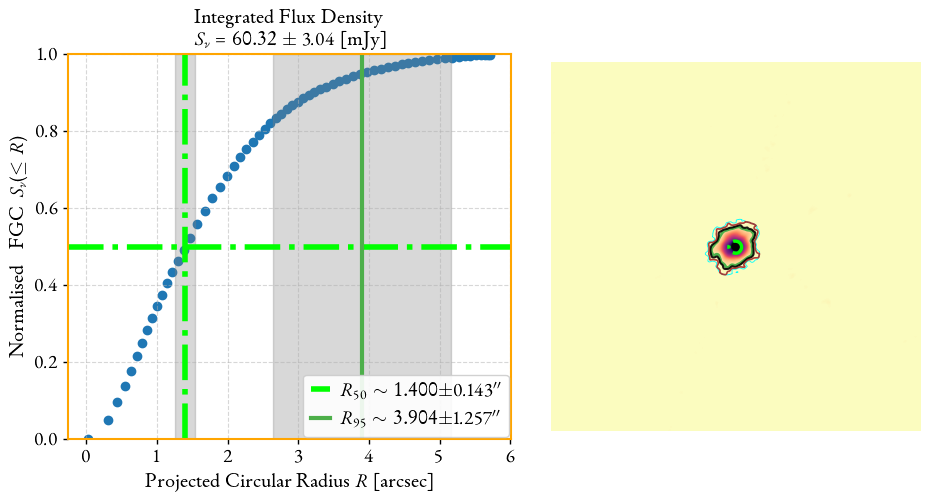

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/L_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_A_L_sfc_uvsub_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/L_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_A_L_sfc_uvsub_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/L_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_A_L_sfc_uvsub_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 73.98 +/- 2.37 mJy
Fractional error = 0.03
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 73.98

<Figure size 500x500 with 0 Axes>

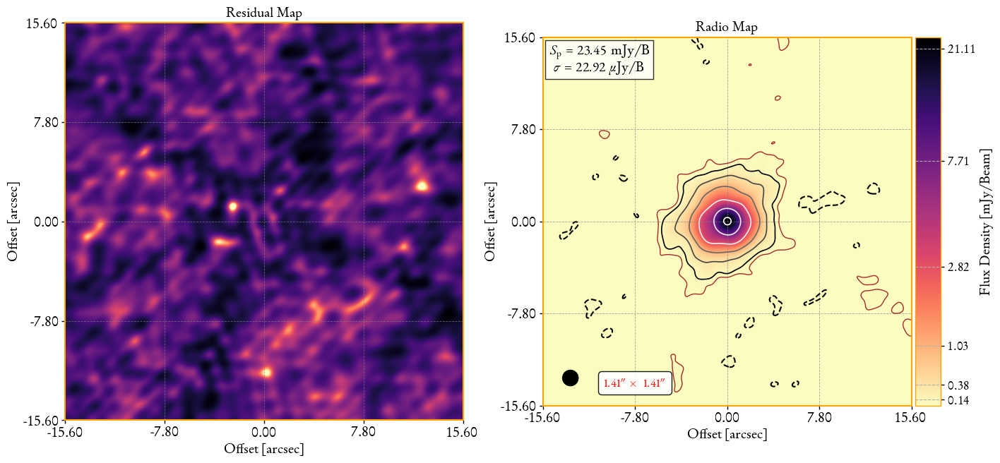

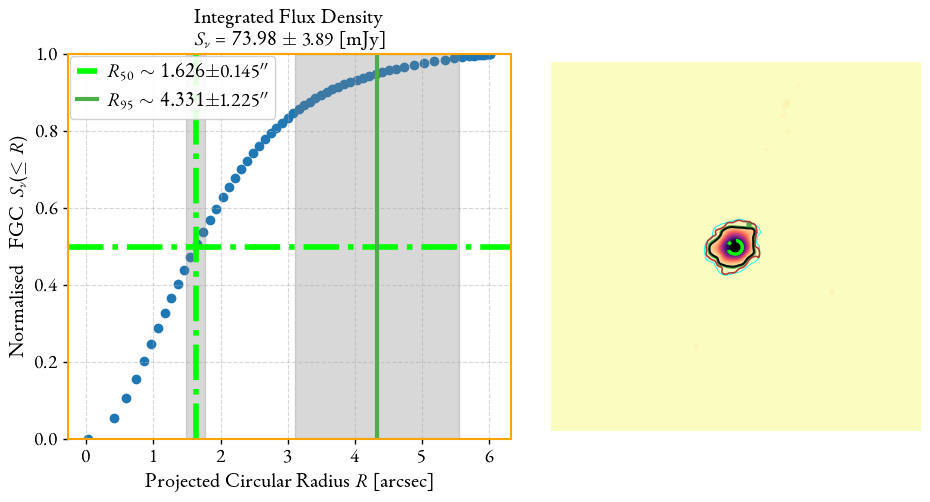

Flux density =  0.07397609345565663
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/L_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_A_L_sfc_uvsub_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/L_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_A_L_sfc_uvsub_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 63.02 +/- 2.00 mJy
Fractional error = 0.03
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 63.02 +/- 3.15 mJy
Fractional error = 0.05
Flux Density = 63.02 +/- 3.69 mJy
Fractional error 4 = 0.06
-----------------------------------------------------------------
 ==>  Peak of Flux      = 25.13 +/- 0.

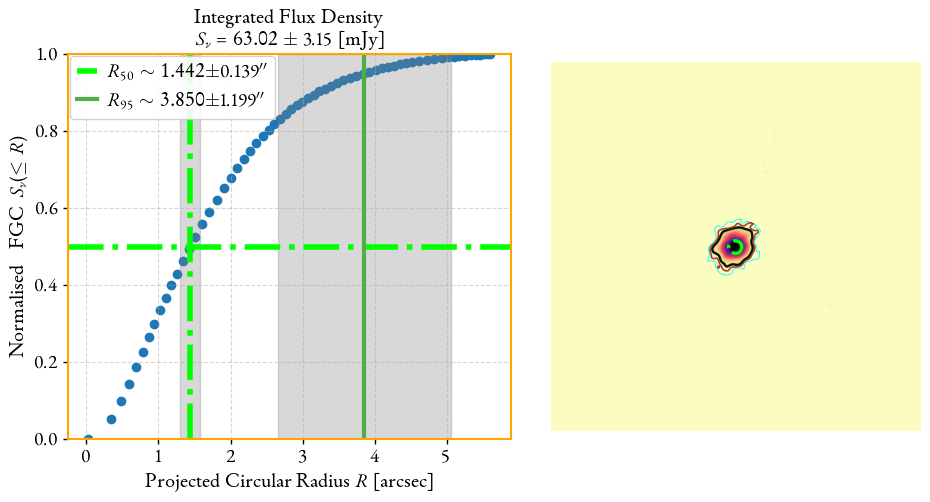

Flux density =  0.06301545793751728
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/L_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_A_L_sfc_uvsub_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/L_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_A_L_sfc_uvsub_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 57.54 +/- 2.67 mJy
Fractional error = 0.05
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 57.54 +/- 2.93 mJy
Fractional error = 0.05
Flux Density = 57.54 +/- 3.83 mJy
Fractional error 4 = 0.07
-----------------------------------------------------------------
 ==>  Peak of Flux      = 22.22 +/- 0.

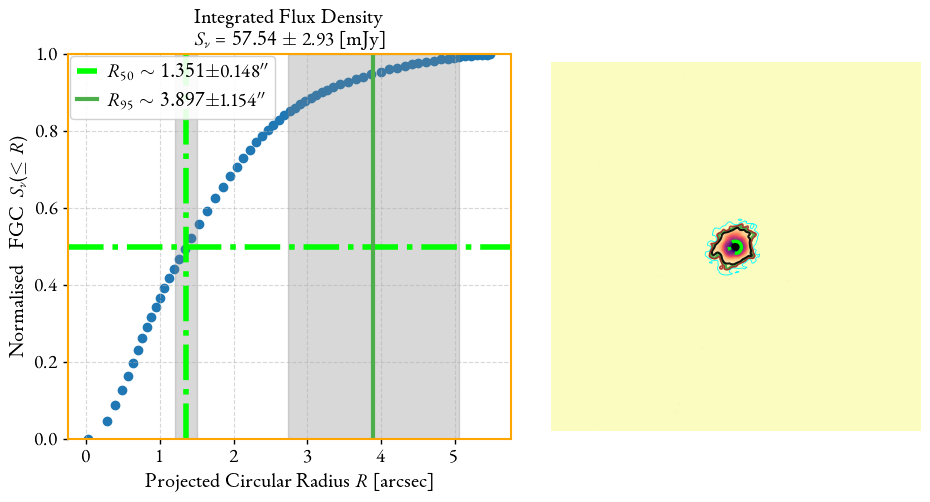

Flux density =  0.05754423494893106
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/L_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_A_L_sfc_uvsub_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0003-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/L_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_A_L_sfc_uvsub_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0003-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 52.61 +/- 3.89 mJy
Fractional error = 0.07
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 52.61 +/- 2.63 mJy
Fractional error = 0.05
Flux Density = 52.61 +/- 4.00 mJy
Fractional error 4 = 0.08
-----------------------------------------------------------------
 ==>  Peak of Flux      = 20.46 +/- 0.

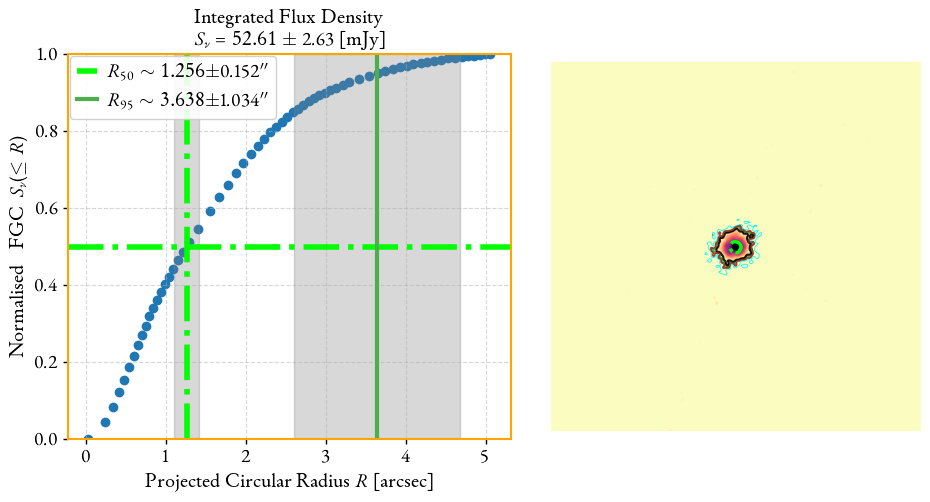

Flux density =  0.052606015373668595
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         1.3601e+01                                    7.94e+02    
       1              2         3.9146e+00      9.69e+00       4.58e+01       8.63e+03    
       2              5         2.1556e+00      1.76e+00       5.69e+00       4.72e+01    
       3              6         8.9445e-01      1.26e+00       1.46e-01       3.92e+01    
       4              7         5.8932e-01      3.05e-01       8.36e-01       1.61e+01    
       5              9         4.4833e-01      1.41e-01       8.97e-02       4.19e+02    
       6             10         4.4716e-01      1.17e-03       5.07e-02       7.39e-02    
       7             11         4.4716e-01      1.35e-06       1.09e-03       9.34e-04    
       8             12         4.4716e-01      1.68e-10       8.94e-06       1.06e-05    
       9             13         4.4716e-01      1.87e

100%|██████████| 5000/5000 [00:06<00:00, 794.26it/s]


{'A1': {'best': 60.403993769576275, 'lower_bound': 58.886784729801356, 'upper_bound': 61.97309465107074, 'lower': 1.5172090397749187, 'upper': 1.5691008814944638}, 'alpha': {'best': -0.6308704199691015, 'lower_bound': -0.7612761128558495, 'upper_bound': -0.49942757727415843, 'lower': 0.13040569288674797, 'upper': 0.1314428426949431}}


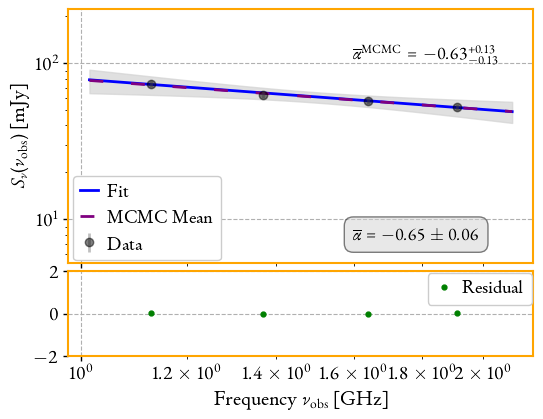

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

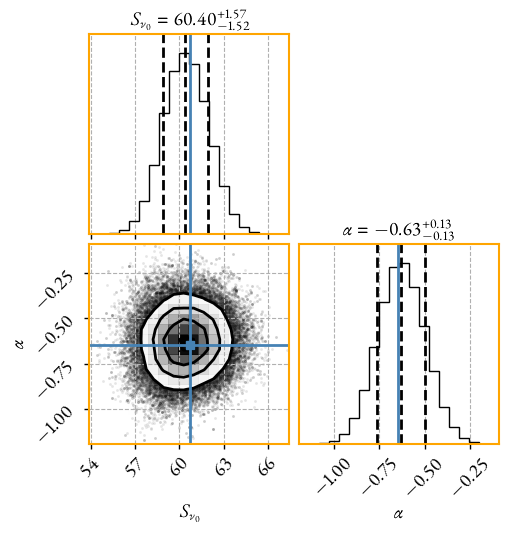

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     60.7120546 +/- 0.84915825 (1.40%) (init = 60.71205)
    alpha: -0.64500330 +/- 0.06377158 (9.89%) (init = -0.6450033)
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                1.407 arcec            
---------------------------------------------
Imaging instrument/band VLA_A_S
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/S_band/Mrk331/imaging_final/MRK0331_A_S_sf_ps.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  0.5
Using mtmfs method.
im_nc4_cb_MRK0331_A_S_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/S_band/Mrk331/imaging_final/:/mnt /media/sagauga/xfs_evo/wsclean3.4-idg-every

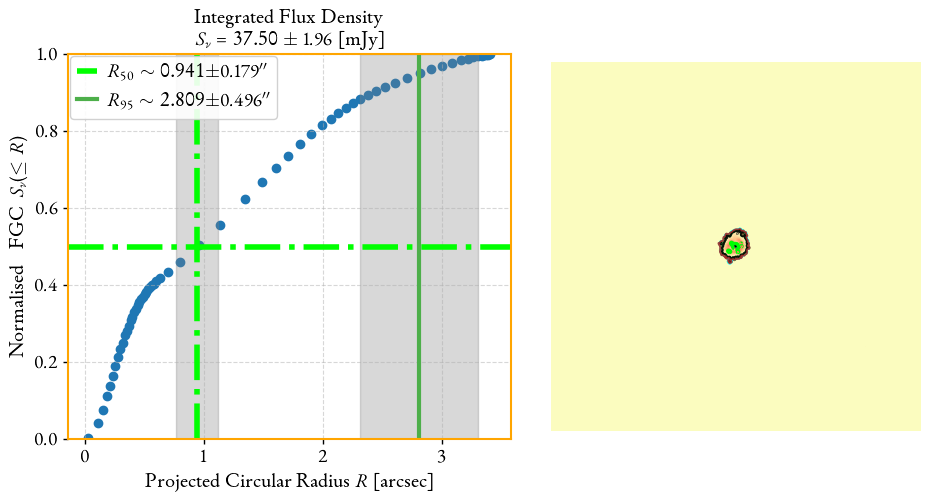

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/S_band/Mrk331/imaging_final/im_nc4_cb_MRK0331_A_S_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/S_band/Mrk331/imaging_final/im_nc4_cb_MRK0331_A_S_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/S_band/Mrk331/imaging_final/im_nc4_cb_MRK0331_A_S_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 48.23 +/- 3.34 mJy
Fractional error = 0.07
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 48.23 +/- 2.41 mJy
Fractional error = 0.05
Flux

/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 17.24 +/- 0.04 [mJy/beam]
 ==>  Snu (within mask) = 48.23 +/- 3.34 [mJy]
 ==>  Snu (image)       = 64.10 +/- 3.34 [mJy]
 ==>  R50               = 1.1214 +/- 0.1656 [arcsec]
 ==>  R95               = 2.8884 +/- 0.4453 [arcsec]


<Figure size 500x500 with 0 Axes>

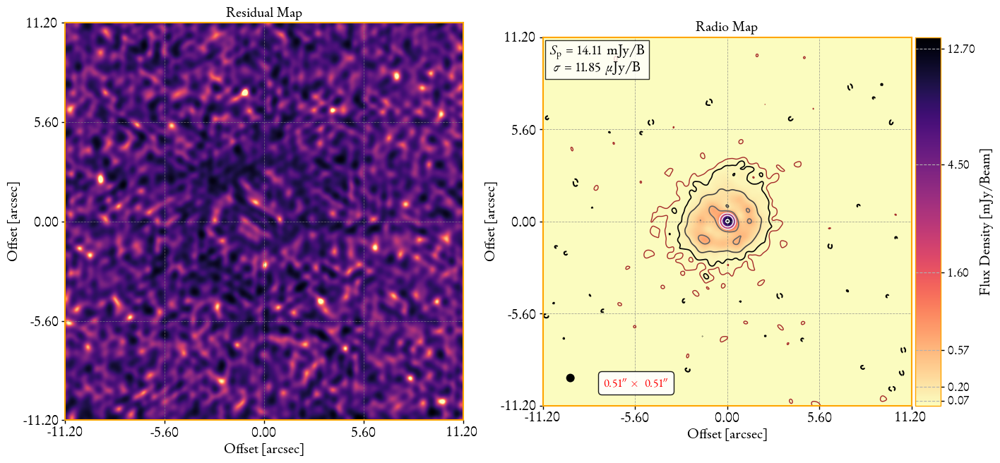

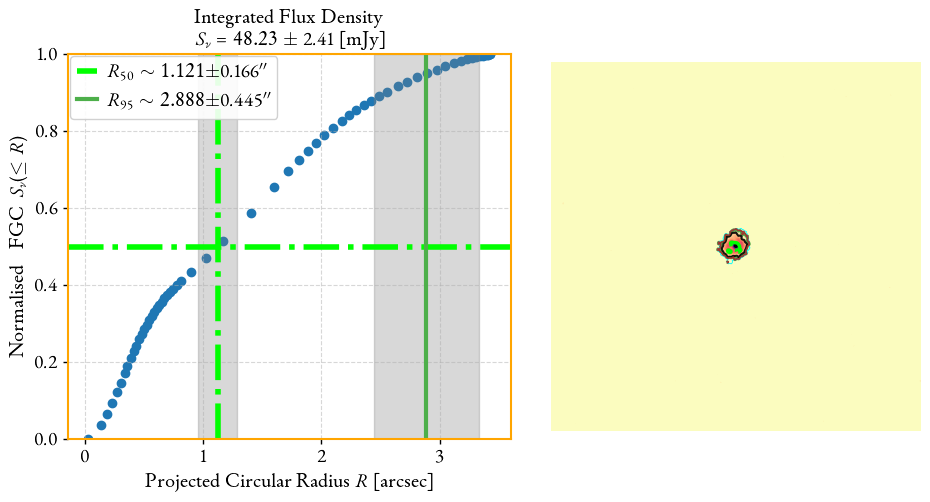

Flux density =  0.04823263925289994
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/S_band/Mrk331/imaging_final/im_nc4_cb_MRK0331_A_S_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/S_band/Mrk331/imaging_final/im_nc4_cb_MRK0331_A_S_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 42.54 +/- 2.58 mJy
Fractional error = 0.06
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 42.54 +/- 2.15 mJy
Fractional error = 0.05
Flux Density = 42.54 +/- 3.19 mJy
Fractional error 4 = 0.08
-----------------------------------------------------------------
 ==>  Peak of Flux      = 15.48 +/- 0.02 [mJy/beam]
 ==>  Snu (wit

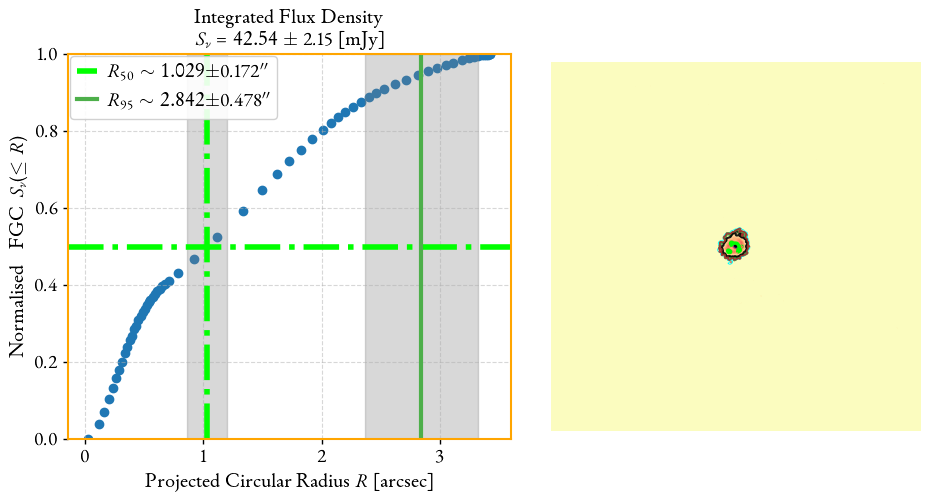

Flux density =  0.042543954376912434
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/S_band/Mrk331/imaging_final/im_nc4_cb_MRK0331_A_S_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/S_band/Mrk331/imaging_final/im_nc4_cb_MRK0331_A_S_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 37.32 +/- 2.68 mJy
Fractional error = 0.07
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 37.32 +/- 1.95 mJy
Fractional error = 0.05
Flux Density = 37.32 +/- 3.25 mJy
Fractional error 4 = 0.09
-----------------------------------------------------------------
 ==>  Peak of Flux      = 13.91 +/- 0.02 [mJy/beam]
 ==>  Snu (wi

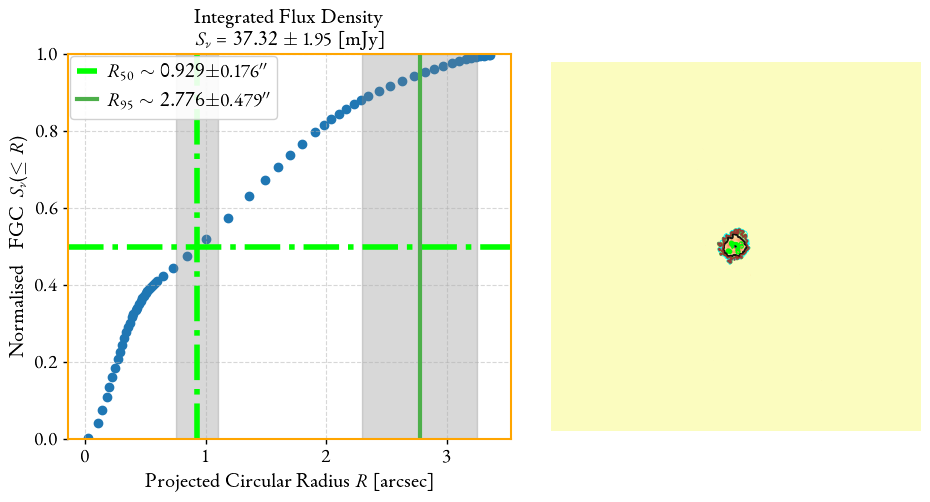

Flux density =  0.037319192541369985
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/S_band/Mrk331/imaging_final/im_nc4_cb_MRK0331_A_S_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0003-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/S_band/Mrk331/imaging_final/im_nc4_cb_MRK0331_A_S_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0003-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 32.45 +/- 4.02 mJy
Fractional error = 0.12
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 32.45 +/- 2.16 mJy
Fractional error = 0.07
Flux Density = 32.45 +/- 4.08 mJy
Fractional error 4 = 0.13
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 12.68 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask) = 32.45 +/- 4.02 [mJy]
 ==>  Snu (image)       = 33.39 +/- 4.02 [mJy]
 ==>  R50               = 0.8138 +/- 0.1861 [arcsec]
 ==>  R95               = 2.6582 +/- 0.4380 [arcsec]


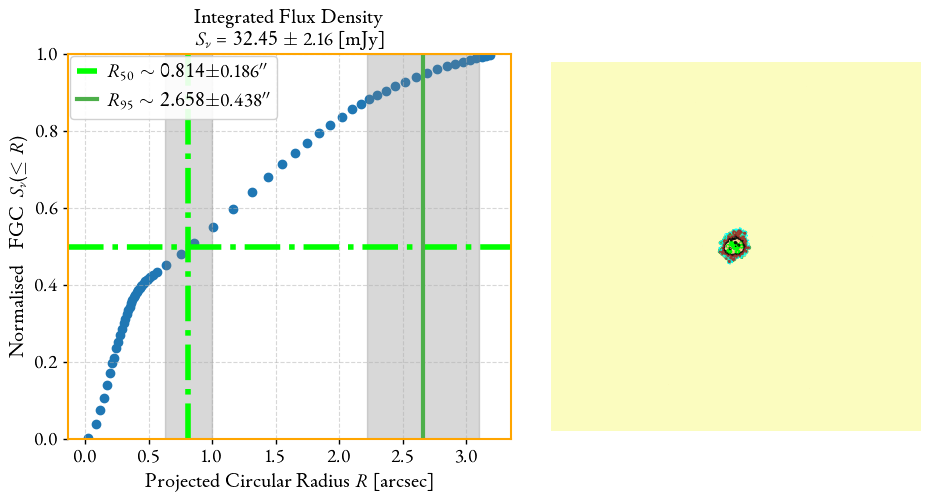

Flux density =  0.032446785543588284
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         1.1440e+01                                    1.37e+03    
       1              2         9.2212e+00      2.22e+00       4.58e+01       1.33e+01    
       2              3         8.2368e+00      9.84e-01       3.33e+00       1.60e+01    
       3              4         6.2445e+00      1.99e+00       5.89e+00       1.35e+01    
       4              5         6.2115e+00      3.30e-02       9.70e+00       1.80e+01    
       5              6         2.5560e+00      3.66e+00       1.27e+00       3.14e+03    
       6              9         2.4935e+00      6.25e-02       5.00e+00       3.79e+01    
       7             10         2.4083e+00      8.52e-02       9.15e-02       3.79e+01    
       8             11         2.2355e+00      1.73e-01       1.81e-01       3.78e+01    
       9             12         1.8738e+00      3.62e

100%|██████████| 5000/5000 [00:06<00:00, 801.06it/s]


{'A1': {'best': 39.20977548683903, 'lower_bound': 38.12150123721333, 'upper_bound': 40.29995642136517, 'lower': 1.088274249625698, 'upper': 1.0901809345261384}, 'alpha': {'best': -0.7411059712839846, 'lower_bound': -0.8828088046006789, 'upper_bound': -0.5994023401336888, 'lower': 0.1417028333166943, 'upper': 0.14170363115029583}}


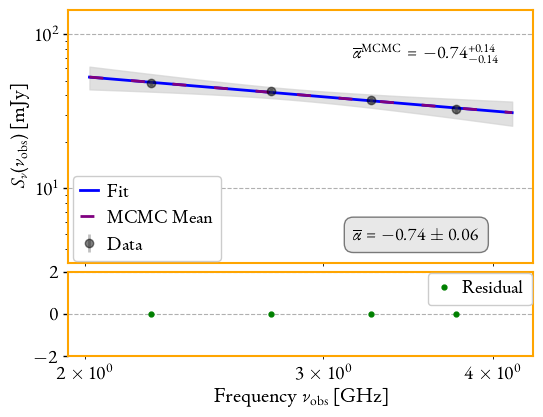

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

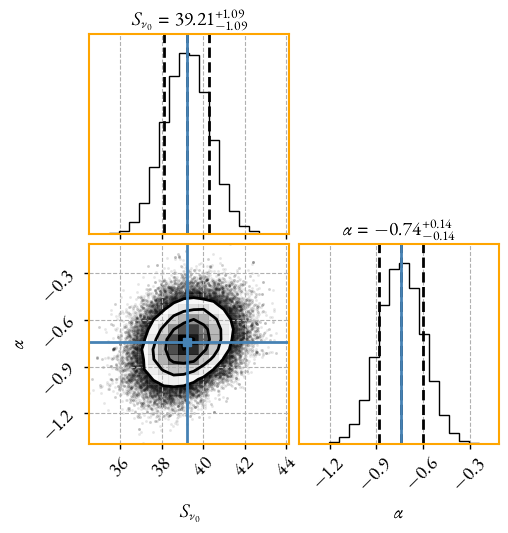

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     39.2091911 +/- 0.50597198 (1.29%) (init = 39.20919)
    alpha: -0.74142641 +/- 0.06230382 (8.40%) (init = -0.7414264)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.389
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.515 arcec            
---------------------------------------------
Imaging instrument/band VLA_A_C
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/C_band/Mrk331/imaging_final/Mrk331_A_C_EVLA_sfc_ps.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  0.5
Using mtmfs method.
im_nc4_cb_Mrk331_A_C_EVLA_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/

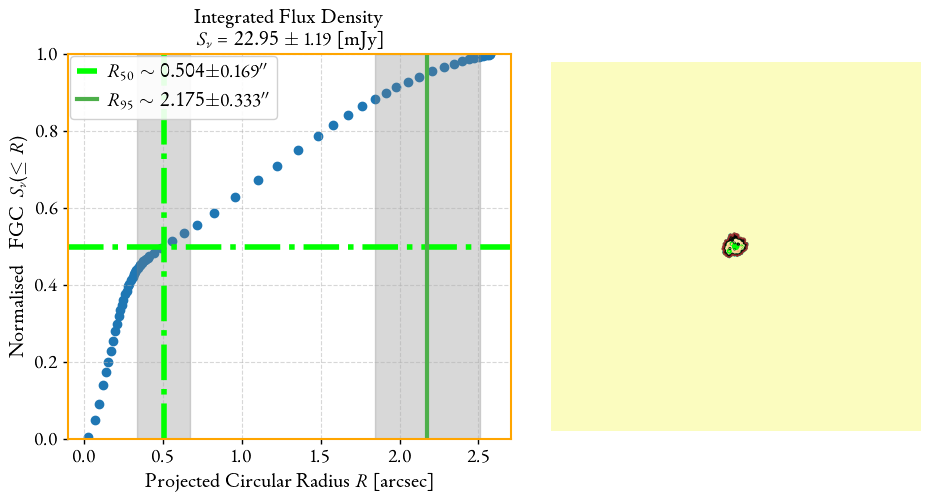

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/C_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_A_C_EVLA_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/C_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_A_C_EVLA_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0003-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/C_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_A_C_EVLA_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0003-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 18.84 +/- 3.82 mJy
Fractional error = 0.20
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 18.84 +/

/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 7.72 +/- 0.01 [mJy/beam]
 ==>  Snu (within mask) = 18.84 +/- 3.82 [mJy]
 ==>  Snu (image)       = 19.06 +/- 3.82 [mJy]
 ==>  R50               = 0.3938 +/- 0.1485 [arcsec]
 ==>  R95               = 2.0027 +/- 0.2727 [arcsec]


<Figure size 500x500 with 0 Axes>

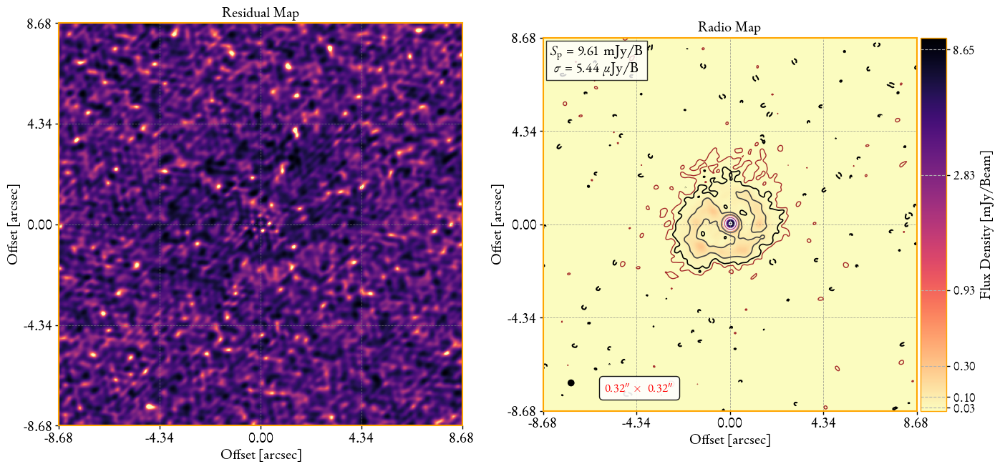

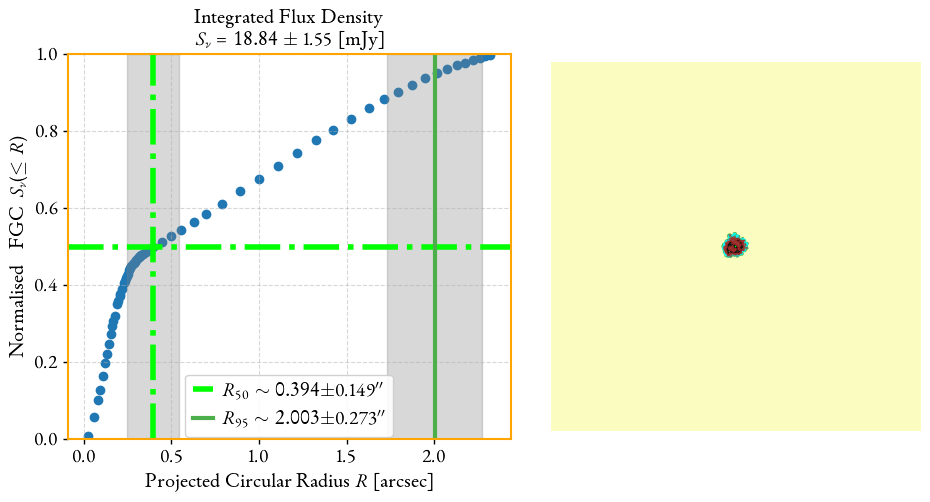

Flux density =  0.018840738547489137
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/C_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_A_C_EVLA_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/C_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_A_C_EVLA_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 28.30 +/- 1.82 mJy
Fractional error = 0.06
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 28.30 +/- 1.45 mJy
Fractional error = 0.05
Flux Density = 28.30 +/- 1.89 mJy
Fractional error 4 = 0.07
-----------------------------------------------------------------
 ==>  Peak of Flux      = 11.91 +/- 0.0

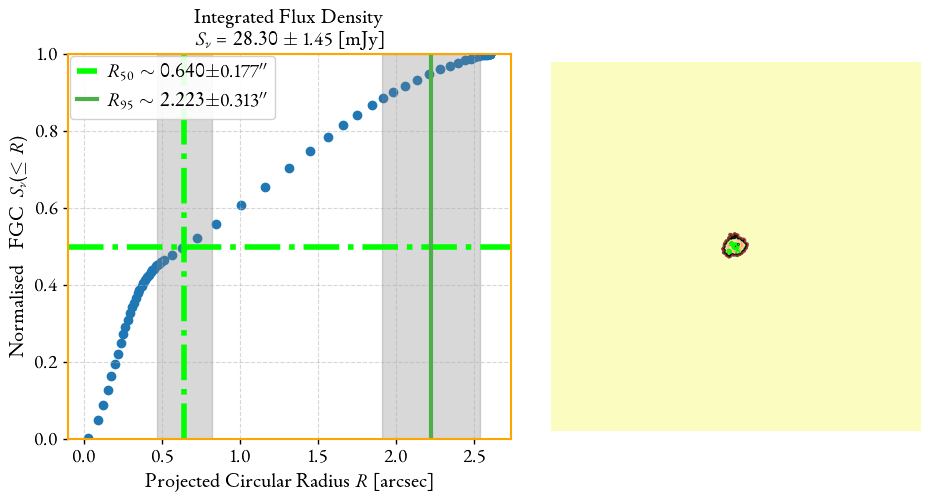

Flux density =  0.028304858027164766
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/C_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_A_C_EVLA_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/C_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_A_C_EVLA_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 24.92 +/- 1.91 mJy
Fractional error = 0.08
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 24.92 +/- 1.25 mJy
Fractional error = 0.05
Flux Density = 24.92 +/- 2.19 mJy
Fractional error 4 = 0.09
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 10.24 +/- 0.01 [mJy/beam]
 ==>  Snu (within mask) = 24.92 +/- 1.91 [mJy]
 ==>  Snu (image)       = 26.20 +/- 1.91 [mJy]
 ==>  R50               = 0.5621 +/- 0.1768 [arcsec]
 ==>  R95               = 2.1732 +/- 0.3190 [arcsec]


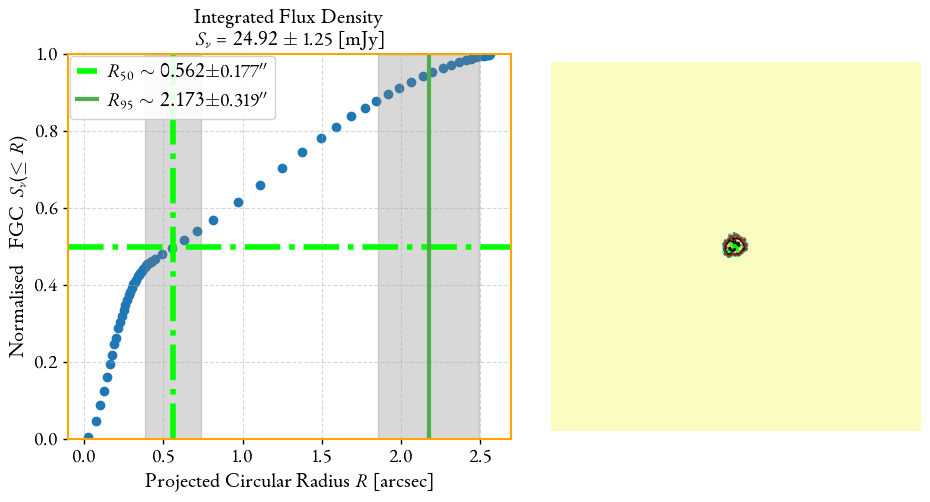

Flux density =  0.02491697780038701
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/C_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_A_C_EVLA_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/C_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_A_C_EVLA_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 21.46 +/- 2.75 mJy
Fractional error = 0.13
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 21.46 +/- 1.37 mJy
Fractional error = 0.06
Flux Density = 21.46 +/- 2.72 mJy
Fractional error 4 = 0.13
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 8.84 +/- 0.01 [mJy/beam]
 ==>  Snu (within mask) = 21.46 +/- 2.75 [mJy]
 ==>  Snu (image)       = 20.87 +/- 2.75 [mJy]
 ==>  R50               = 0.4622 +/- 0.1640 [arcsec]
 ==>  R95               = 2.0901 +/- 0.3009 [arcsec]


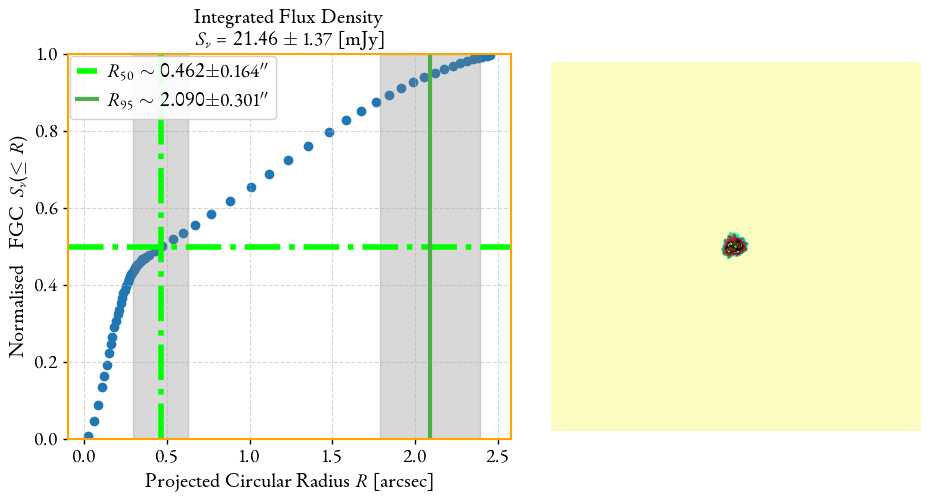

Flux density =  0.021458776836296416
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         8.1817e+00                                    3.07e+03    
       1              3         1.0063e+00      7.18e+00       1.15e+01       1.14e+04    
       2              5         8.5153e-02      9.21e-01       1.36e+00       3.83e+00    
       3              6         7.4046e-02      1.11e-02       3.02e-02       9.12e+01    
       4              7         7.3978e-02      6.88e-05       4.20e-03       2.75e-01    
       5              8         7.3978e-02      1.83e-09       4.07e-05       1.00e-05    
       6              9         7.3978e-02      1.81e-13       2.36e-07       8.90e-08    
       7             10         7.3978e-02      1.39e-16       1.32e-09       9.48e-06    
       8             11         7.3978e-02      4.16e-16       5.54e-09       1.11e-07    
       9             20         7.3978e-02      0.00e

100%|██████████| 5000/5000 [00:06<00:00, 797.77it/s]


{'A1': {'best': 22.818966085345252, 'lower_bound': 22.100753011916318, 'upper_bound': 23.54567701709517, 'lower': 0.7182130734289345, 'upper': 0.726710931749917}, 'alpha': {'best': -0.7721776976397554, 'lower_bound': -0.9312821488739762, 'upper_bound': -0.6139794281185423, 'lower': 0.1591044512342208, 'upper': 0.15819826952121308}}


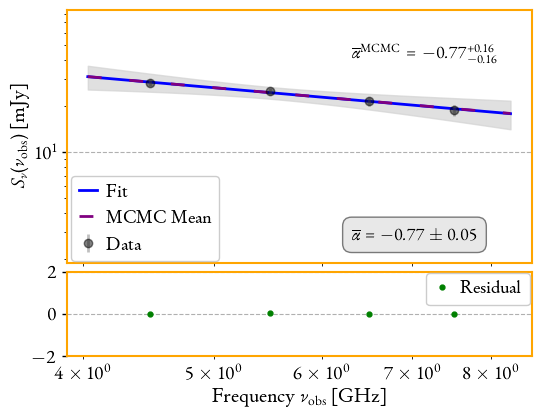

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

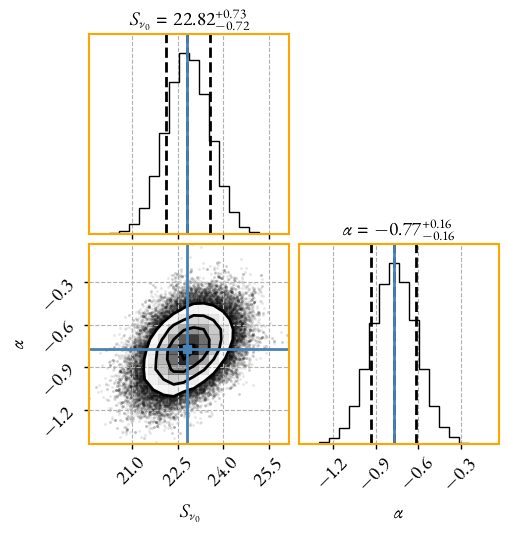

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     22.8022564 +/- 0.25581885 (1.12%) (init = 22.80226)
    alpha: -0.77417833 +/- 0.05413254 (6.99%) (init = -0.7741783)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.362
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.323 arcec            
---------------------------------------------
Imaging instrument/band VLA_A_X
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/X_band/Mrk331/imaging_final/MRK0331_A_X_sf_ps.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  0.5
Using mtmfs method.
im_nc4_cb_MRK0331_A_X_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archiv

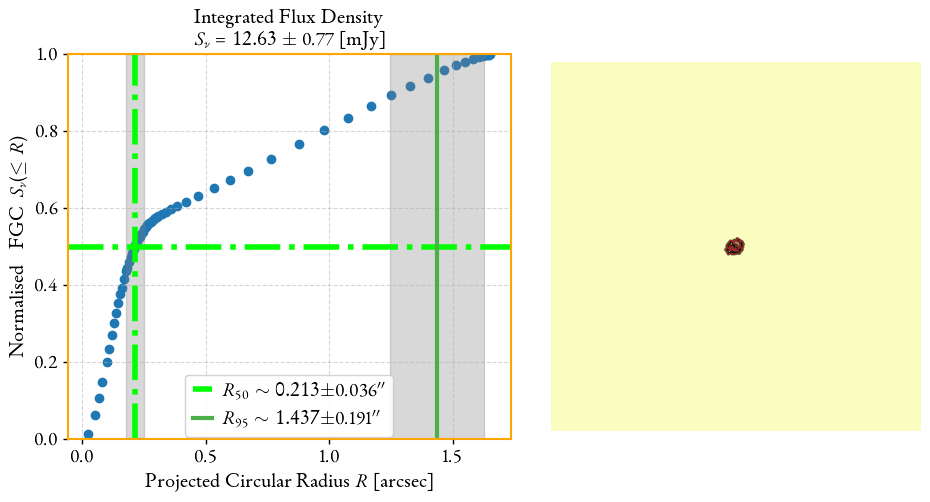

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/X_band/Mrk331/imaging_final/im_nc4_cb_MRK0331_A_X_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/X_band/Mrk331/imaging_final/im_nc4_cb_MRK0331_A_X_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/X_band/Mrk331/imaging_final/im_nc4_cb_MRK0331_A_X_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 14.56 +/- 1.27 mJy
Fractional error = 0.09
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 14.56 +/- 0.77 mJy
Frac

<Figure size 500x500 with 0 Axes>

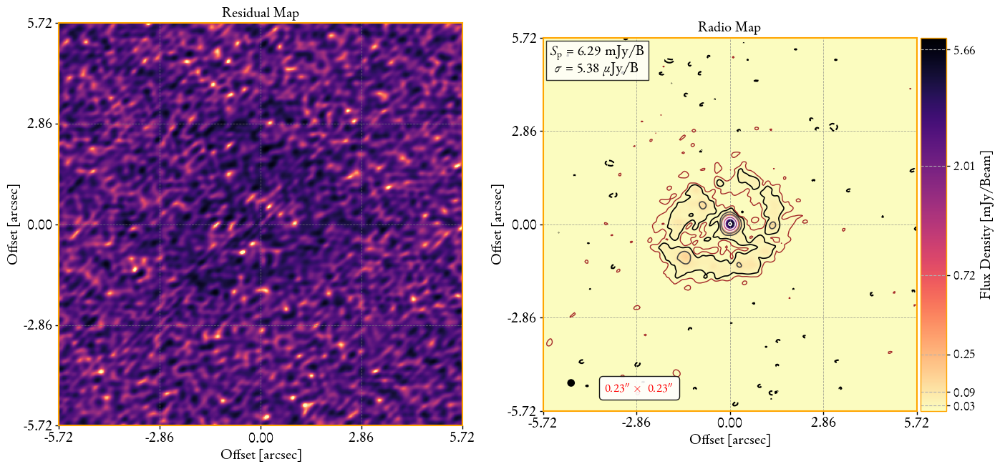

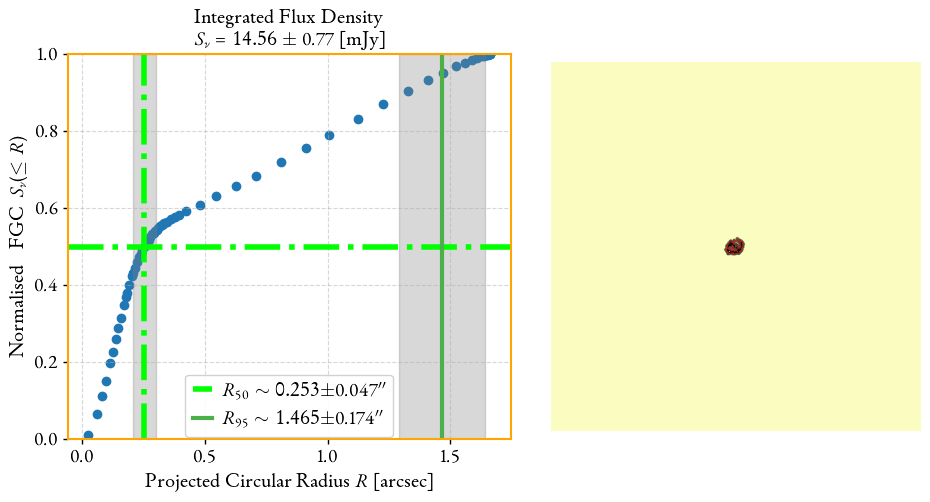

Flux density =  0.014558830986638132
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/X_band/Mrk331/imaging_final/im_nc4_cb_MRK0331_A_X_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/X_band/Mrk331/imaging_final/im_nc4_cb_MRK0331_A_X_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 11.81 +/- 1.76 mJy
Fractional error = 0.15
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 11.81 +/- 0.81 mJy
Fractional error = 0.07
Flux Density = 11.81 +/- 1.90 mJy
Fractional error 4 = 0.16
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 5.85 +/- 0.01 [mJy/beam]
 ==>  Snu (within mask) = 11.81 +/- 1.76 [mJy]
 ==>  Snu (image)       = 11.53 +/- 1.76 [mJy]
 ==>  R50               = 0.1954 +/- 0.0305 [arcsec]
 ==>  R95               = 1.3513 +/- 0.1807 [arcsec]


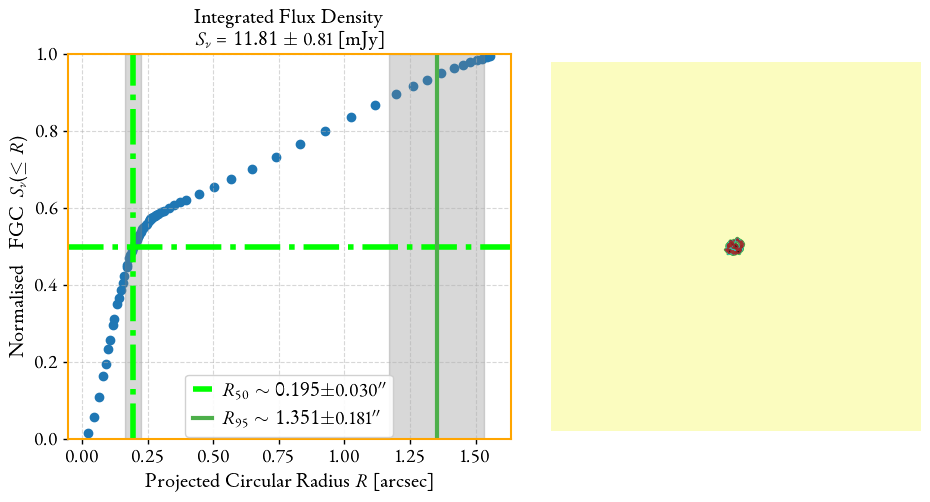

Flux density =  0.011805013316286599
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/X_band/Mrk331/imaging_final/im_nc4_cb_MRK0331_A_X_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/X_band/Mrk331/imaging_final/im_nc4_cb_MRK0331_A_X_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 12.88 +/- 1.60 mJy
Fractional error = 0.12
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 12.88 +/- 0.78 mJy
Fractional error = 0.06
Flux Density = 12.88 +/- 1.57 mJy
Fractional error 4 = 0.12
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 6.47 +/- 0.01 [mJy/beam]
 ==>  Snu (within mask) = 12.88 +/- 1.60 [mJy]
 ==>  Snu (image)       = 14.13 +/- 1.60 [mJy]
 ==>  R50               = 0.2152 +/- 0.0350 [arcsec]
 ==>  R95               = 1.3862 +/- 0.1892 [arcsec]


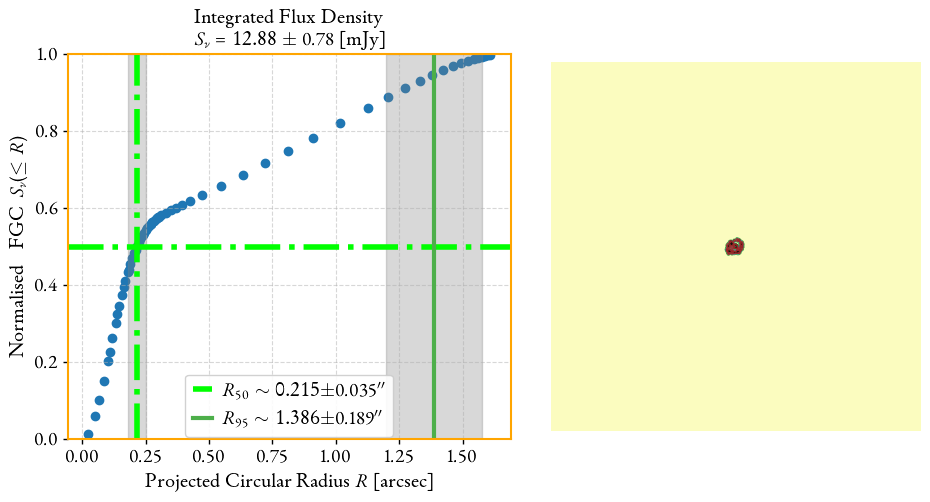

Flux density =  0.012875281132038738
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/X_band/Mrk331/imaging_final/im_nc4_cb_MRK0331_A_X_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0003-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/A_config/23A-324/X_band/Mrk331/imaging_final/im_nc4_cb_MRK0331_A_X_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0003-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 11.01 +/- 2.58 mJy
Fractional error = 0.23
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 11.01 +/- 0.89 mJy
Fractional error = 0.08
Flux Density = 11.01 +/- 2.57 mJy
Fractional error 4 = 0.23
-----------------------------------------------------------------
 ==>  Peak of Flux      = 5.34 +/- 0.01 [mJy/beam

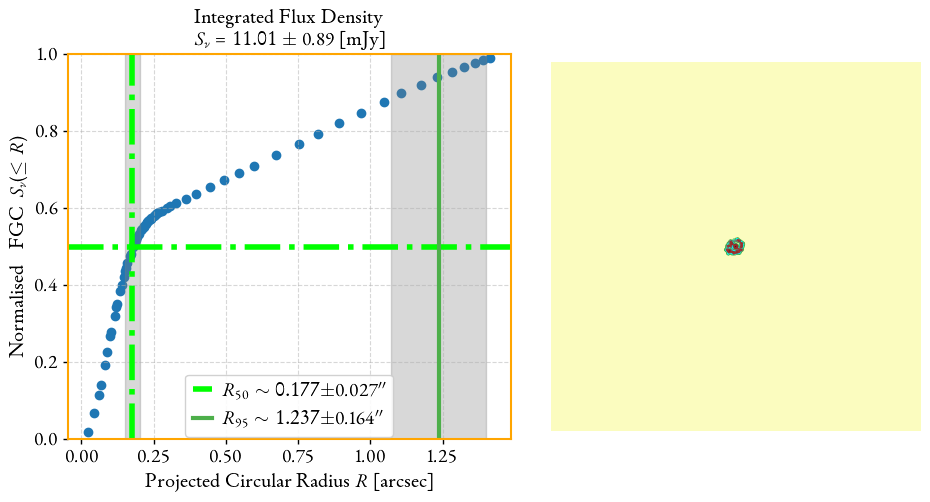

Flux density =  0.011010771202895621
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         2.2552e+00                                    1.10e+04    
       1              4         1.3726e-01      2.12e+00       2.86e+00       6.77e+00    
       2              5         8.8960e-02      4.83e-02       1.02e-01       5.19e+00    
       3              6         2.7759e-02      6.12e-02       1.94e-01       2.22e+00    
       4              7         8.5963e-03      1.92e-02       1.74e-01       2.05e+01    
       5              8         8.5921e-03      4.12e-06       1.62e-03       8.31e-05    
       6              9         8.5921e-03      1.36e-10       1.09e-05       3.96e-06    
       7             10         8.5921e-03      7.24e-15       7.98e-08       9.18e-09    
       8             11         8.5921e-03      4.34e-17       7.17e-10       3.16e-08    
       9             15         8.5921e-03      6.94e

100%|██████████| 5000/5000 [00:05<00:00, 842.70it/s]


{'A1': {'best': 12.394114754850001, 'lower_bound': 11.974338963073528, 'upper_bound': 12.808935663591624, 'lower': 0.4197757917764733, 'upper': 0.41482090874162303}, 'alpha': {'best': -0.9314650082705418, 'lower_bound': -1.2202787898973761, 'upper_bound': -0.6463604289188676, 'lower': 0.28881378162683435, 'upper': 0.2851045793516742}}


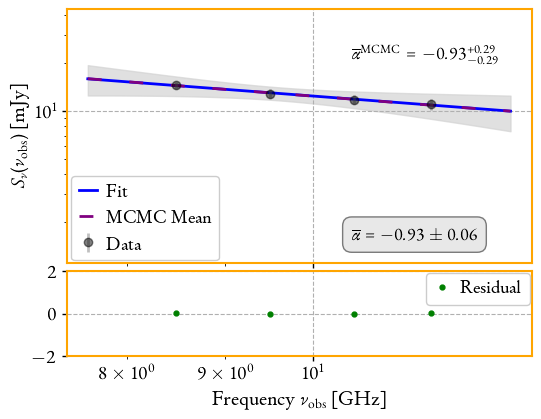

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

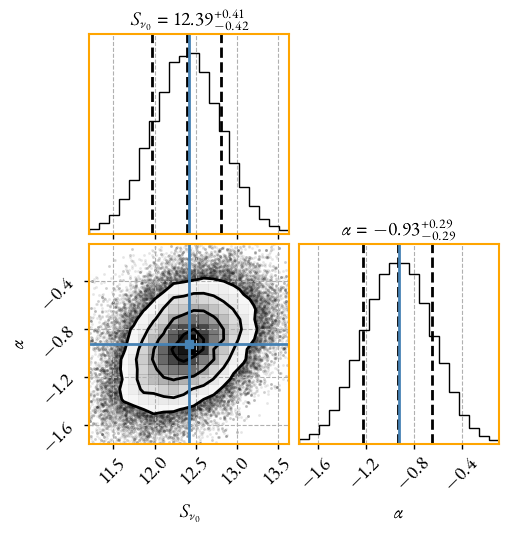

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     12.4159771 +/- 0.08130098 (0.65%) (init = 12.41598)
    alpha: -0.92568191 +/- 0.05554576 (6.00%) (init = -0.9256819)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.286
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.233 arcec            
---------------------------------------------
Imaging instrument/band VLA_C_Ku
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ku_band/Mrk331/imaging_final/Mrk331_C_Ku_sfc_ps.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  0.5
Using mtmfs method.
im_nc4_cb_Mrk331_C_Ku_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_

/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


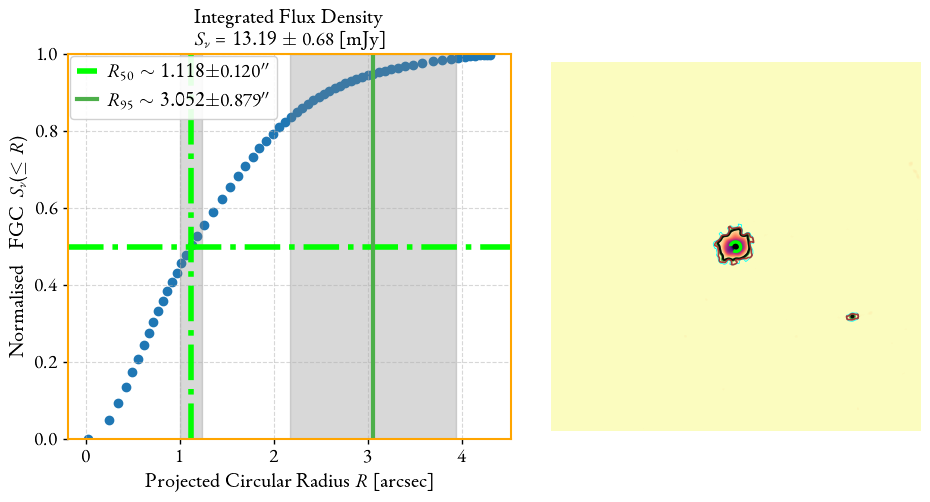

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ku_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_C_Ku_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ku_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_C_Ku_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ku_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_C_Ku_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 13.51 +/- 0.76 mJy
Fractional error = 0.06
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 13.51 +/- 0.69 mJy
Fractional error = 0.0

/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 5.96 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask) = 13.51 +/- 0.76 [mJy]
 ==>  Snu (image)       = 12.06 +/- 0.76 [mJy]
 ==>  R50               = 1.1211 +/- 0.1199 [arcsec]
 ==>  R95               = 3.0806 +/- 0.8619 [arcsec]


<Figure size 500x500 with 0 Axes>

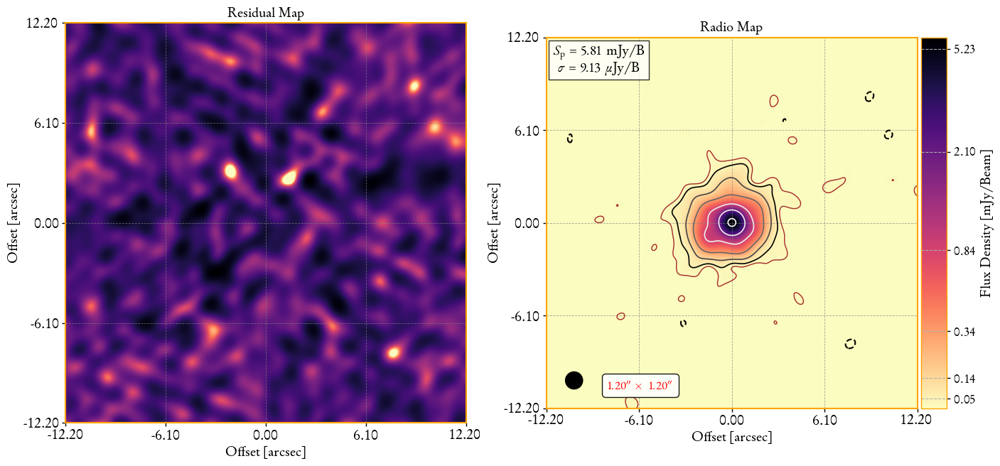

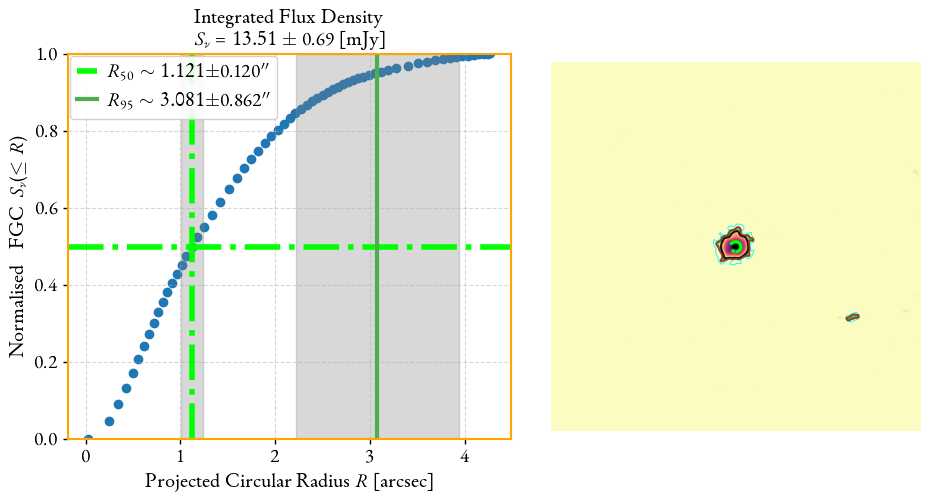

Flux density =  0.013513940606721923
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ku_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_C_Ku_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ku_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_C_Ku_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 14.52 +/- 0.68 mJy
Fractional error = 0.05
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 14.52 +/- 0.75 mJy
Fractional error = 0.05
Flux Density = 14.52 +/- 0.94 mJy
Fractional error 4 = 0.06
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 6.92 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask) = 14.52 +/- 0.68 [mJy]
 ==>  Snu (image)       = 12.69 +/- 0.68 [mJy]
 ==>  R50               = 1.2013 +/- 0.1125 [arcsec]
 ==>  R95               = 3.0952 +/- 0.8262 [arcsec]


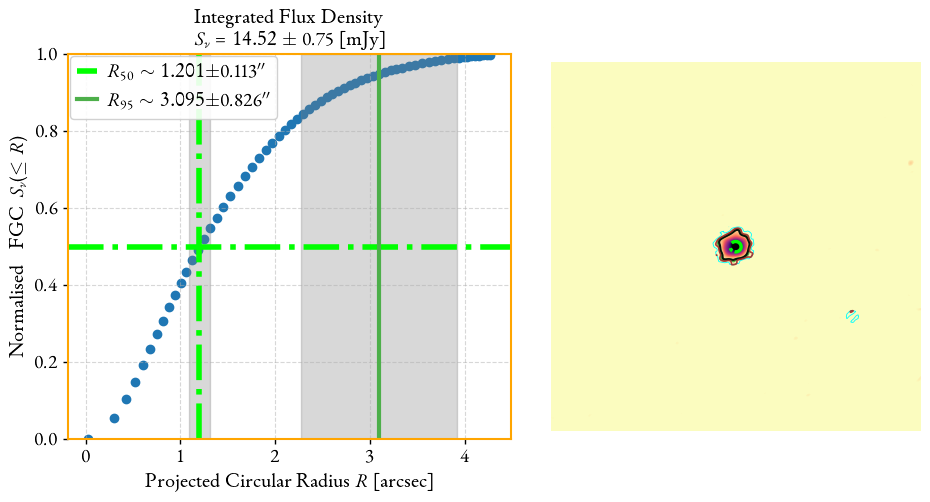

Flux density =  0.014522077747748318
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ku_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_C_Ku_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ku_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_C_Ku_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 12.78 +/- 0.94 mJy
Fractional error = 0.07
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 12.78 +/- 0.68 mJy
Fractional error = 0.05
Flux Density = 12.78 +/- 1.09 mJy
Fractional error 4 = 0.09
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 5.46 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask) = 12.78 +/- 0.94 [mJy]
 ==>  Snu (image)       = 11.23 +/- 0.94 [mJy]
 ==>  R50               = 1.0872 +/- 0.1275 [arcsec]
 ==>  R95               = 3.0782 +/- 0.7923 [arcsec]


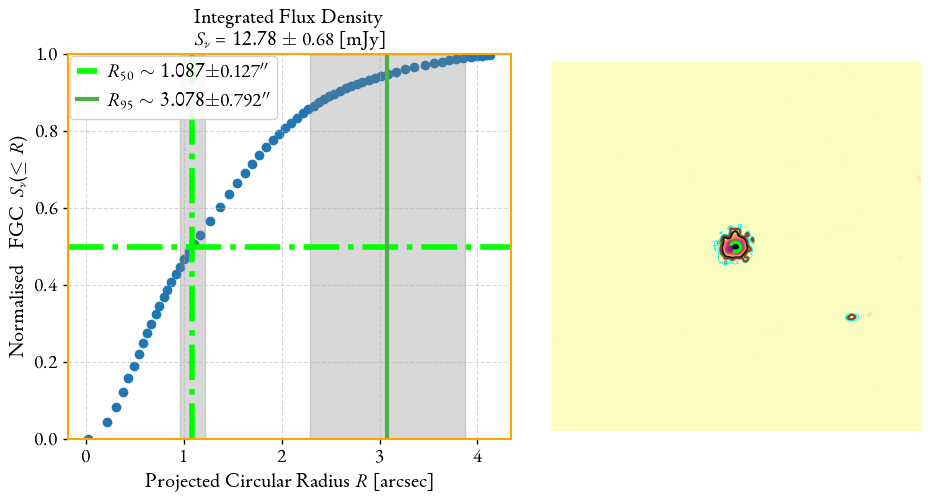

Flux density =  0.01278181995991036
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ku_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_C_Ku_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0003-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ku_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_C_Ku_sfc_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0003-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 11.83 +/- 0.97 mJy
Fractional error = 0.08
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 11.83 +/- 0.61 mJy
Fractional error = 0.05
Flux Density = 11.83 +/- 1.17 mJy
Fractional error 4 = 0.10
-----------------------------------------------------------------
 ==>  Peak of Flux      = 5.00 +/- 0.02 [mJy/beam]
 ==>  Snu (

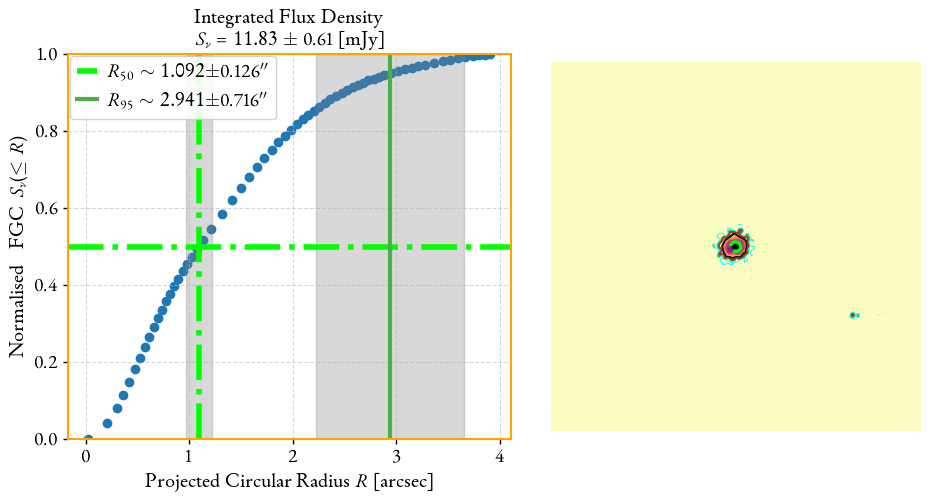

Flux density =  0.011834101928709428
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         2.9131e+00                                    1.01e+04    
       1              4         5.9160e-02      2.85e+00       2.86e+00       2.20e+03    
       2              5         5.5587e-03      5.36e-02       2.49e-01       4.23e-01    
       3              6         4.2870e-03      1.27e-03       2.75e-02       8.08e-01    
       4              7         4.2870e-03      3.66e-09       7.09e-05       9.90e-07    
       5              8         4.2870e-03      1.38e-14       9.53e-08       3.73e-06    
       6              9         4.2870e-03      1.74e-16       3.45e-09       6.77e-08    
       7             20         4.2870e-03      0.00e+00       0.00e+00       6.77e-08    
`xtol` termination condition is satisfied.
Function evaluations 20, initial cost 2.9131e+00, final cost 4.2870e-03, first-order optimality 6.77e

100%|██████████| 5000/5000 [00:05<00:00, 878.42it/s]


{'A1': {'best': 13.049098698414054, 'lower_bound': 12.715629368443176, 'upper_bound': 13.38269808702441, 'lower': 0.3334693299708782, 'upper': 0.3335993886103559}, 'alpha': {'best': -0.6543609817606282, 'lower_bound': -0.8712730575813771, 'upper_bound': -0.43424760533575546, 'lower': 0.2169120758207489, 'upper': 0.22011337642487272}}


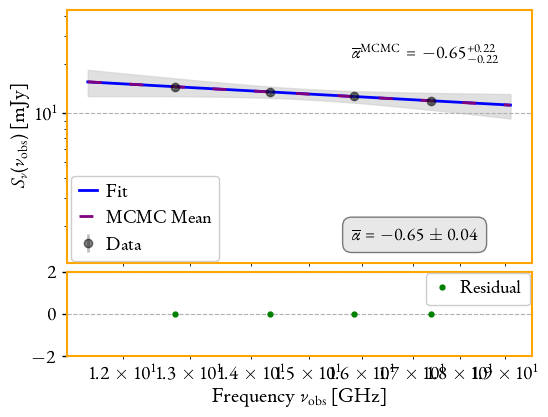

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

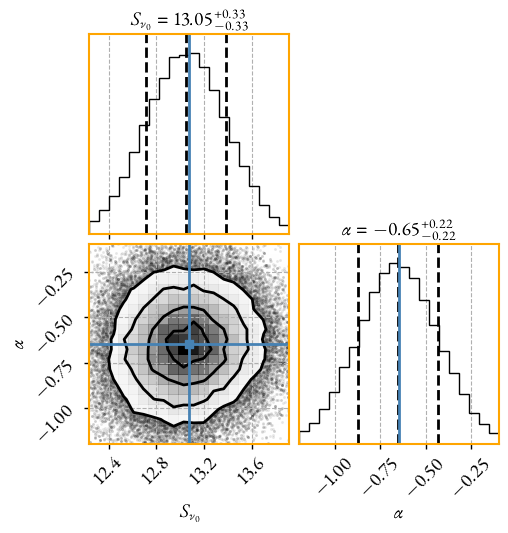

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     13.0700352 +/- 0.05595705 (0.43%) (init = 13.07004)
    alpha: -0.64825024 +/- 0.03663030 (5.65%) (init = -0.6482502)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.168
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                1.198 arcec            
---------------------------------------------
Imaging instrument/band VLA_C_Ka
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ka_band/Mrk331/imaging_final/Mrk331_C_Ka_2x_sf_ps.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  0.5
Using mtmfs method.
im_nc4_cb_Mrk331_C_Ka_2x_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archiv

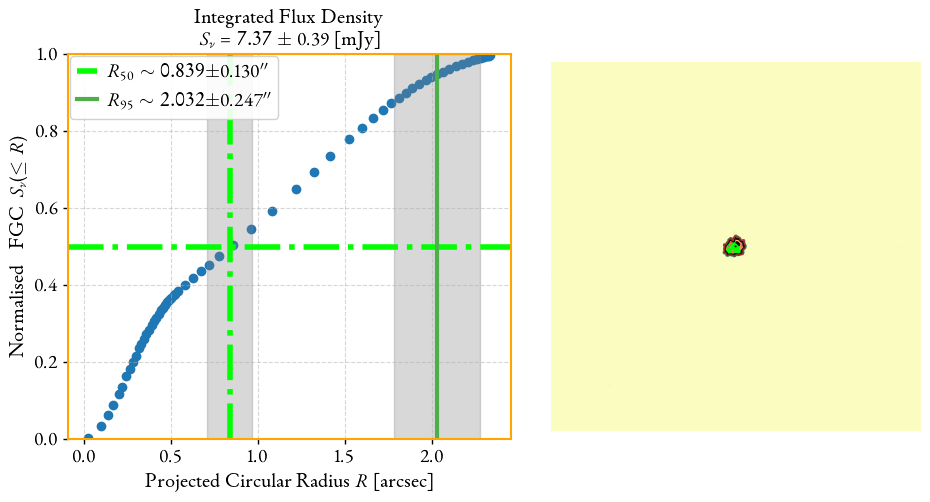

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ka_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_C_Ka_2x_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ka_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_C_Ka_2x_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ka_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_C_Ka_2x_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 7.15 +/- 1.02 mJy
Fractional error = 0.14
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 7.15 +/- 0.37 mJy
Fractional error =

/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 2.72 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask) = 7.15 +/- 1.02 [mJy]
 ==>  Snu (image)       = 7.50 +/- 1.02 [mJy]
 ==>  R50               = 0.8477 +/- 0.1250 [arcsec]
 ==>  R95               = 2.0050 +/- 0.2140 [arcsec]


<Figure size 500x500 with 0 Axes>

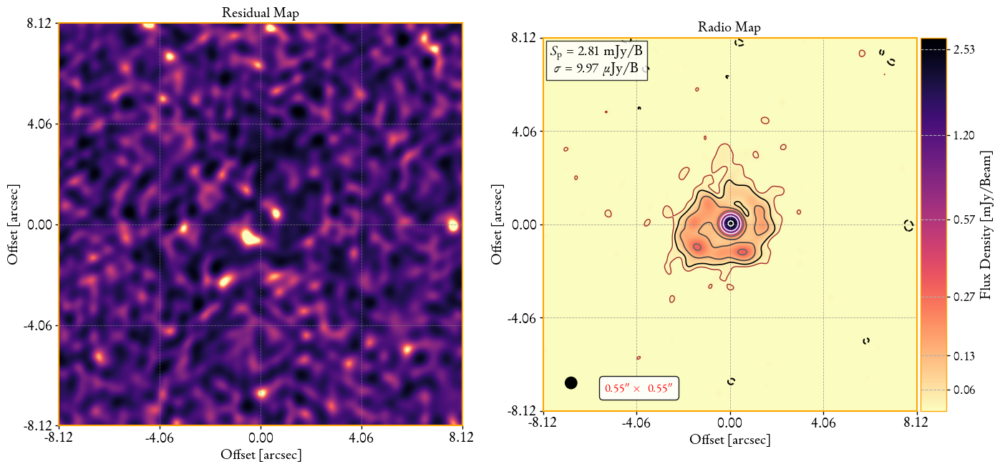

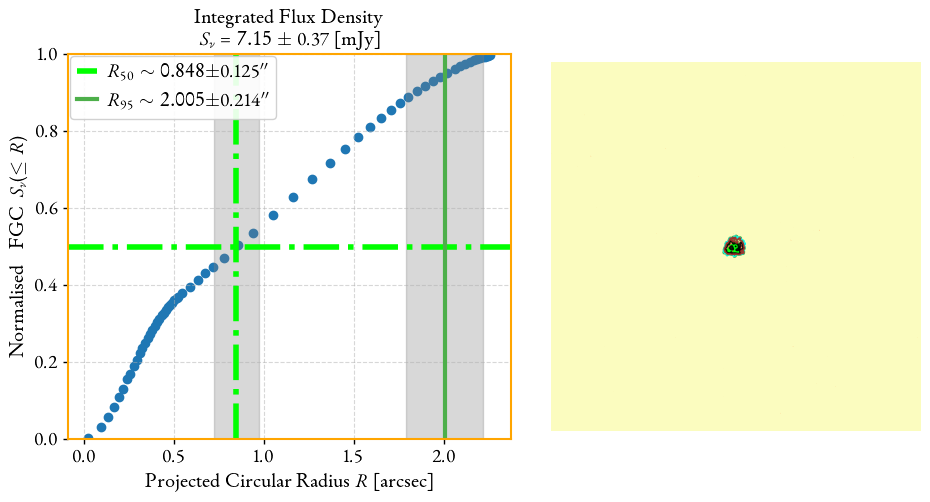

Flux density =  0.007150270619294397
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ka_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_C_Ka_2x_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ka_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_C_Ka_2x_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 7.53 +/- 1.05 mJy
Fractional error = 0.14
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 7.53 +/- 0.43 mJy
Fractional error = 0.06
Flux Density = 7.53 +/- 1.21 mJy
Fractional error 4 = 0.16
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 2.86 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask) = 7.53 +/- 1.05 [mJy]
 ==>  Snu (image)       = 5.11 +/- 1.05 [mJy]
 ==>  R50               = 0.8268 +/- 0.1318 [arcsec]
 ==>  R95               = 2.0016 +/- 0.2221 [arcsec]


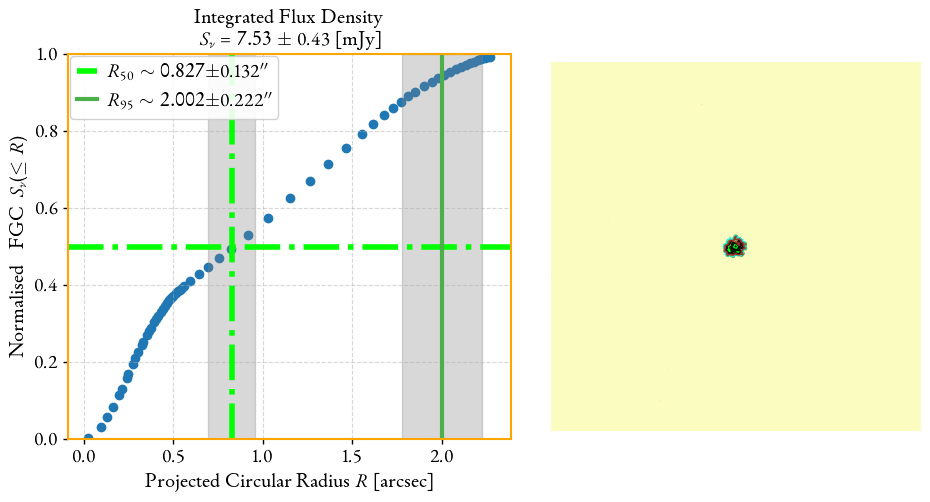

Flux density =  0.007531988294998393
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ka_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_C_Ka_2x_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ka_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_C_Ka_2x_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 7.86 +/- 0.93 mJy
Fractional error = 0.12
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 7.86 +/- 0.39 mJy
Fractional error = 0.05
Flux Density = 7.86 +/- 0.94 mJy
Fractional error 4 = 0.12
-----------------------------------------------------------------
 ==>  Peak of Flux      = 3.07 +/- 0.02 [mJy/beam]
 ==>  Snu

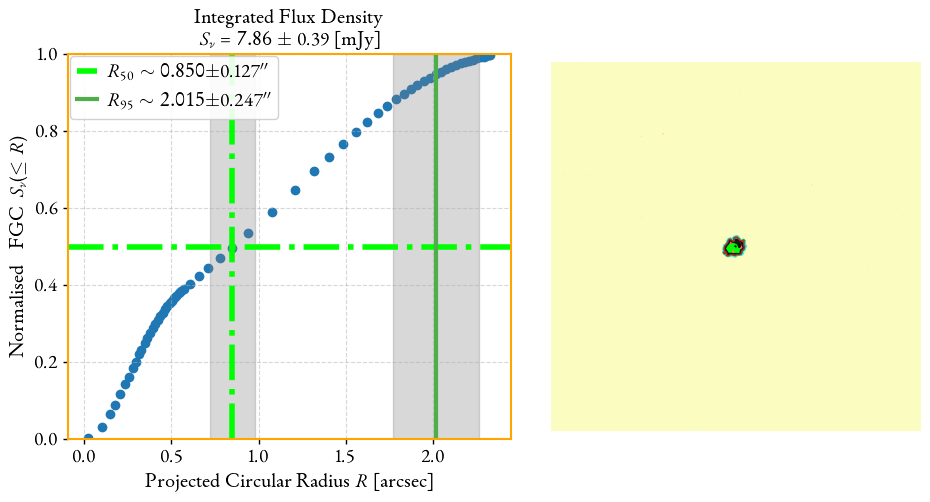

Flux density =  0.007863146861811426
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ka_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_C_Ka_2x_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0003-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/VLA-Archive/C_config/Ka_band/Mrk331/imaging_final/im_nc4_cb_Mrk331_C_Ka_2x_sf_ps_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.5-0003-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 6.88 +/- 1.55 mJy
Fractional error = 0.23
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 6.88 +/- 0.52 mJy
Fractional error = 0.07
Flux Density = 6.88 +/- 1.50 mJy
Fractional error 4 = 0.22
-----------------------------------------------------------------
 ==>  Peak of Flux      = 2.54 +/- 0.02 [mJy/beam]
 ==>  Snu

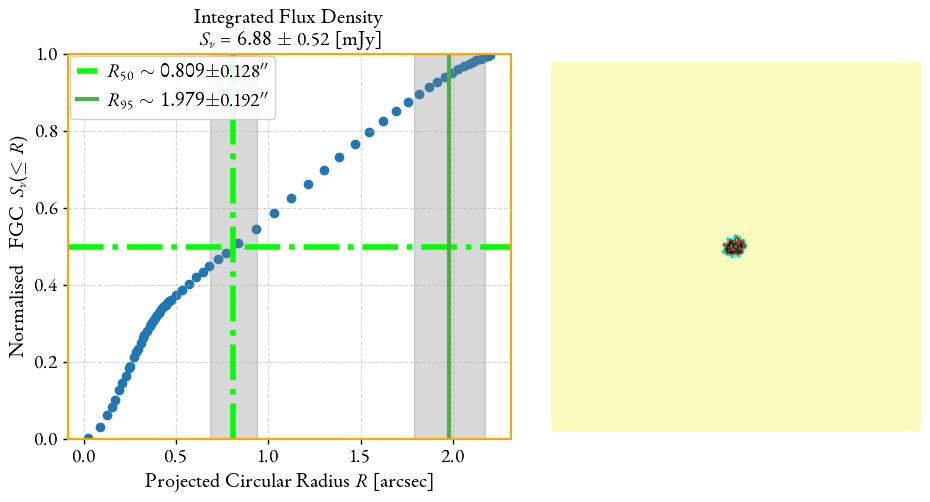

Flux density =  0.006882341077513266
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         2.4842e+00                                    1.07e+01    
       1              3         1.5835e-02      2.47e+00       2.52e+00       1.56e+00    
       2              4         2.5746e-04      1.56e-02       1.54e-01       6.22e-03    
       3              5         2.5706e-04      4.05e-07       1.18e-03       6.35e-07    
       4              6         2.5706e-04      2.73e-15       6.88e-08       6.93e-07    
       5              7         2.5706e-04      1.03e-17       1.72e-09       2.92e-10    
       6              8         2.5706e-04      7.05e-19       1.80e-10       5.20e-10    
       7             10         2.5706e-04      6.51e-18       6.57e-11       4.86e-07    
       8             13         2.5706e-04      1.84e-18       3.48e-11       1.87e-08    
       9             21         2.5706e-04      0.00e

100%|██████████| 5000/5000 [00:05<00:00, 966.23it/s]


{'A1': {'best': 7.33499045306714, 'lower_bound': 7.206747938943544, 'upper_bound': 7.46139512036198, 'lower': 0.12824251412359544, 'upper': 0.12640466729484068}, 'alpha': {'best': -0.7529424804002032, 'lower_bound': -1.0150731060114657, 'upper_bound': -0.49137028952579137, 'lower': 0.26213062561126255, 'upper': 0.2615721908744118}}


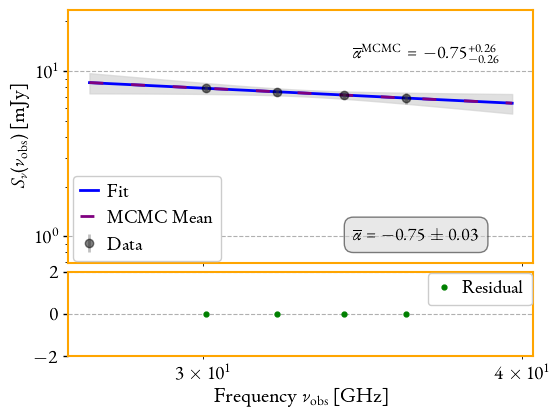

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

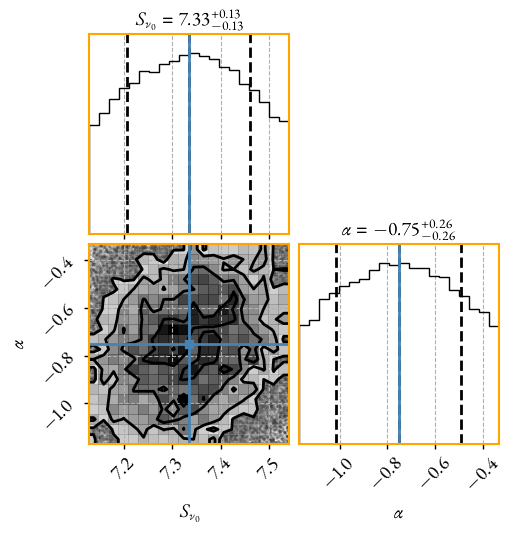

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     7.33417335 +/- 0.01377692 (0.19%) (init = 7.334173)
    alpha: -0.75275535 +/- 0.02797684 (3.72%) (init = -0.7527554)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.171
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.553 arcec            
---------------------------------------------


In [5]:
robust = [0.5]
for vis_name in list(vis_list.keys()):
    print(f"Imaging instrument/band {vis_name}")
    print(f"    > Visibility: {vis_list[vis_name]}")
    for ROBUST in robust:
        image_list,image_statistics,Omaj = \
            mlibs.run_wsclean(vis_list[vis_name], robust=ROBUST,
                        imsize=imsizex, 
                        imsizey=imsizey, 
                        opt_args= opt_args,
                        cell=cell,
                        base_name=prefix,
                        nsigma_automask=nsigma_automask,
                        nsigma_autothreshold=nsigma_autothreshold,
                        quiet=True,
                        nc=n_subimages,
                        with_multiscale=True,
                        # scales='0,40,120,240',
                        scales='None',
                        datacolumn='DATA',
                        uvtaper=uvtaper,
                        niter=100000)


# $\text{VLA-A L, S, C, X} + \text{VLA-C Ku, Ka}$
## First images from $uv$-matched visibilities, but with native restoring beam $\Theta$

In [7]:
beam_sizes = []
vis_list_uv_match = {
    'VLA_A_L': '/media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/Mrk331_A_L_sfc_uvsub_ps_lowres.ms',
    'VLA_A_S': '/media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/MRK0331_A_S_sf_ps_lowres.ms',
    'VLA_A_C': '/media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/C/Mrk331_A_C_EVLA_sfc_ps_lowres.ms',
    'VLA_A_X': '/media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/MRK0331_A_X_sf_ps_lowres.ms',
    'VLA_C_Ku': '/media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ku/Mrk331_C_Ku_sfc_ps_lowres.ms',
    'VLA_C_Ka': '/media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/Mrk331_C_Ka_2x_sf_ps_lowres.ms',
}

vis_list_uv_match_wt_plus = {
    'VLA_A_X': '/media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/MRK0331_A_X_sf_ps_lowres.ms',
    'VLA_C_Ka': '/media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/Mrk331_C_Ka_2x_sf_ps_lowres.ms',    
}

vis_list_uv_match_wt_minus = {
    'VLA_A_L': '/media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/Mrk331_A_L_sfc_uvsub_ps_lowres.ms',
    'VLA_A_S': '/media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/MRK0331_A_S_sf_ps_lowres.ms',    
}

n_subimages = 3
imsizex = int(1024*2)
imsizey = int(1024*2)
opt_args= "' -circular-beam '"
cell = '0.04asec'
prefix = f"im_nc{n_subimages}_cb"
nsigma_automask='4.0'
nsigma_autothreshold='1.5'
uvtaper = ['']

In [7]:
beam_sizes_au = []
for vis_name in list(vis_list_uv_match.keys()):
    print(vis_name)
    beam_size_au = compute_vis_restoring_beam(vis=vis_list_uv_match[vis_name],casa_path='casa')
    beam_sizes_au.append(float(beam_size_au))
    print('-------------------')

VLA_A_L
Effective Beam: 0.003140518539037083
-------------------
VLA_A_S
Effective Beam: 0.5768786131112746
-------------------
VLA_A_C
Effective Beam: 0.000811679651991466
-------------------
VLA_A_X
Effective Beam: 0.171735641680955
-------------------
VLA_C_Ku
Effective Beam: 0.14849095108080695
-------------------
VLA_C_Ka
Effective Beam: 0.6992670931644394
-------------------


Imaging instrument/band VLA_A_L
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/Mrk331_A_L_sfc_uvsub_ps_lowres.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  0.0
Using mtmfs method.
im_nc3_cb_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/:/mnt /media/sagauga/xfs_evo/wsclean3.4-idg-everybeam-eMERLIN_portable.sif wsclean -name /mnt/im_nc3_cb_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0 -size 2048 2048 -scale 0.04asec  -mgain 0.5 -gain 0.1 -nmiter 500  -niter 100000 -weight briggs 0.0  -auto-mask 4.0  -auto-threshold 1.5  -multiscale  -multiscale-scale-bias 0.7 -multiscale-gain 0.1  -multiscale-max-scales 6   -deconvolution-threads 24 -j 24 -parallel-reor

/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


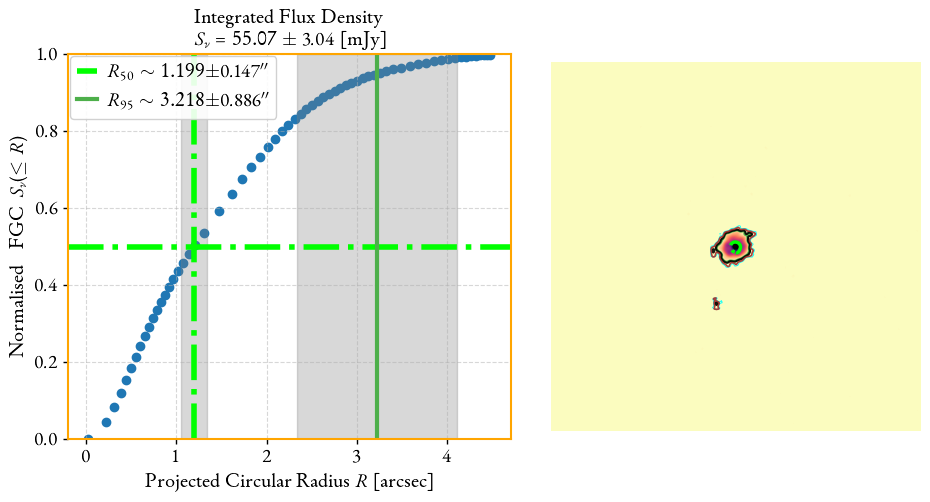

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 64.91 +/- 2.53 mJy
Fractional error = 0.04
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 64.91 +/- 3.40 mJy
Fractional error = 

/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 25.44 +/- 0.05 [mJy/beam]
 ==>  Snu (within mask) = 64.91 +/- 2.53 [mJy]
 ==>  Snu (image)       = 64.52 +/- 2.53 [mJy]
 ==>  R50               = 1.3529 +/- 0.1313 [arcsec]
 ==>  R95               = 3.3507 +/- 0.8833 [arcsec]


<Figure size 500x500 with 0 Axes>

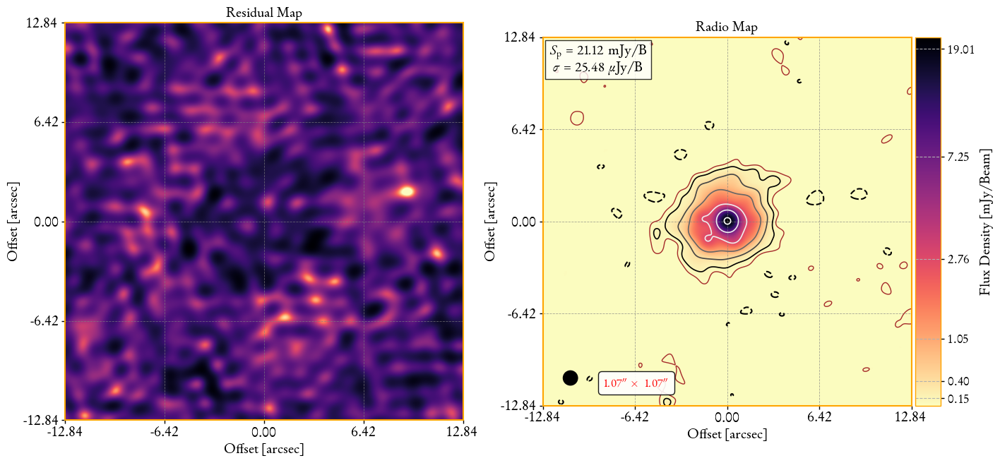

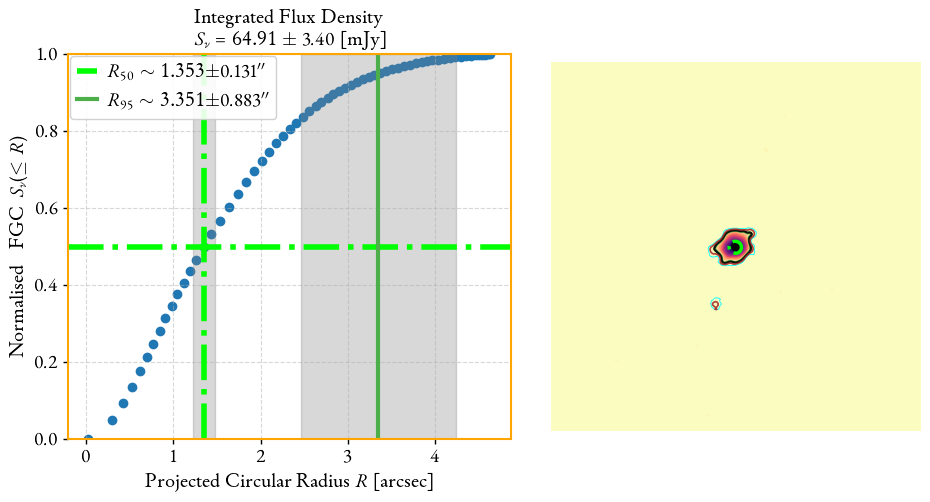

Flux density =  0.0649102707963518
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 55.56 +/- 3.10 mJy
Fractional error = 0.06
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 55.56 +/- 3.08 mJy
Fractional error = 0.06
Flux Density = 55.56 +/- 3.80 mJy
Fractional error 4 = 0.07
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 21.43 +/- 0.04 [mJy/beam]
 ==>  Snu (within mask) = 55.56 +/- 3.10 [mJy]
 ==>  Snu (image)       = 54.38 +/- 3.10 [mJy]
 ==>  R50               = 1.2089 +/- 0.1453 [arcsec]
 ==>  R95               = 3.2655 +/- 0.8841 [arcsec]


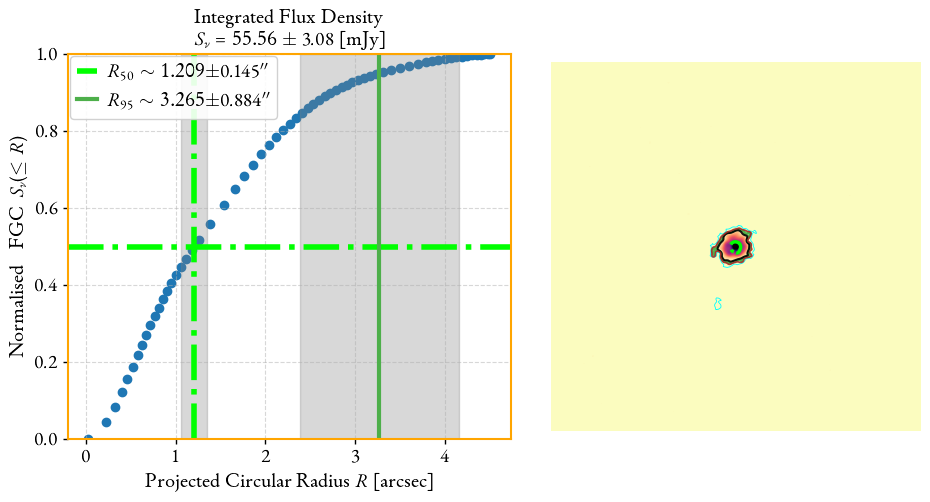

Flux density =  0.05555553614478949
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 49.55 +/- 4.85 mJy
Fractional error = 0.10
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 49.55 +/- 2.80 mJy
Fractional error = 0.06
Flux Density = 49.55 +/- 4.45 mJy
Fractional error 4 = 0.09
-----------------------------------------------------------------
 ==>  Peak of Flux      = 19.29 +/- 0.04 [mJy/beam]
 ==>  Sn

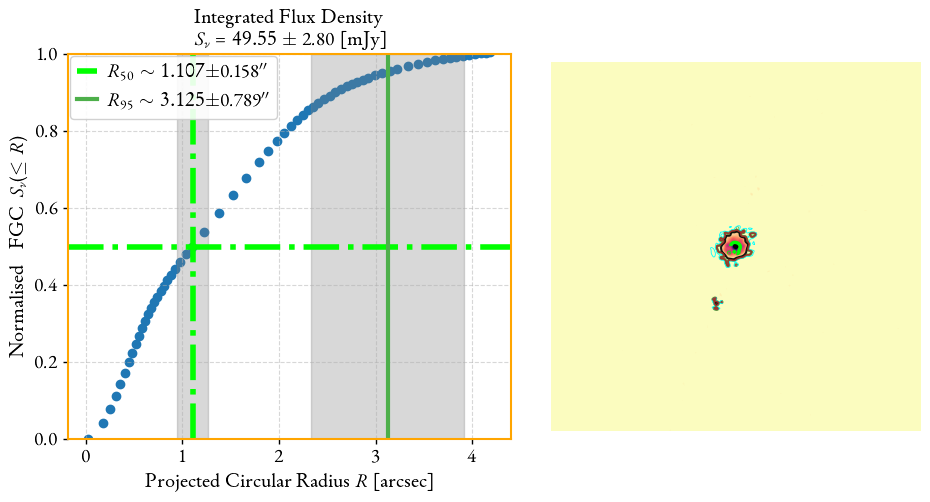

Flux density =  0.049550116679576435
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         9.9163e+00                                    6.59e+02    
       1              2         1.4981e+00      8.42e+00       4.58e+01       3.16e+01    
       2              5         5.6235e-01      9.36e-01       1.27e-01       3.69e+01    
       3              7         1.2878e-01      4.34e-01       6.54e-02       2.40e+01    
       4              8         2.1560e-02      1.07e-01       8.65e-02       7.64e+02    
       5              9         8.2685e-03      1.33e-02       4.49e-02       4.08e-01    
       6             10         8.2271e-03      4.14e-05       4.89e-03       8.99e-04    
       7             11         8.2271e-03      1.44e-10       1.47e-06       1.49e-06    
       8             12         8.2271e-03      1.01e-16       7.82e-09       3.93e-06    
       9             13         8.2271e-03      1.42e

100%|██████████| 5000/5000 [00:05<00:00, 950.84it/s]


{'A1': {'best': 55.70046917866718, 'lower_bound': 54.547968851061114, 'upper_bound': 56.88670165120627, 'lower': 1.152500327606063, 'upper': 1.1862324725390962}, 'alpha': {'best': -0.5734500117988146, 'lower_bound': -0.6794358480090091, 'upper_bound': -0.4683350038599024, 'lower': 0.10598583621019453, 'upper': 0.10511500793891221}}


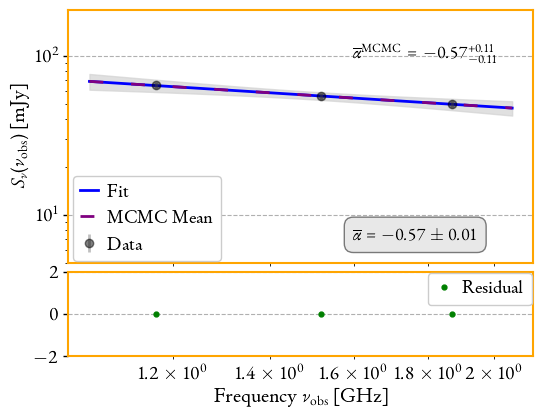

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

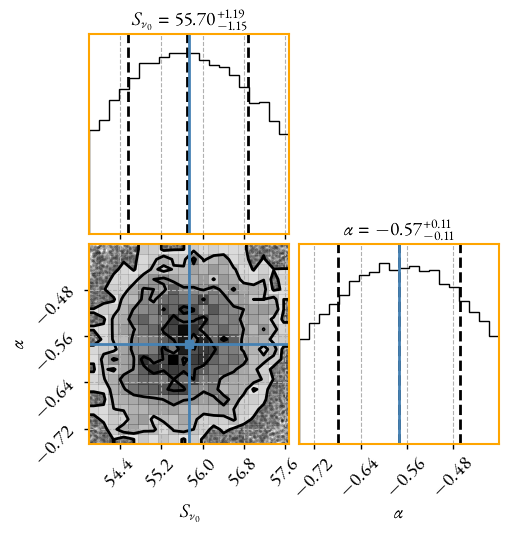

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     55.7320511 +/- 0.12907467 (0.23%) (init = 55.73205)
    alpha: -0.57440051 +/- 0.01151263 (2.00%) (init = -0.5744005)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.265
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                1.072 arcec            
---------------------------------------------
Imaging instrument/band VLA_A_S
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/MRK0331_A_S_sf_ps_lowres.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  0.0
Using mtmfs method.
im_nc3_cb_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/V

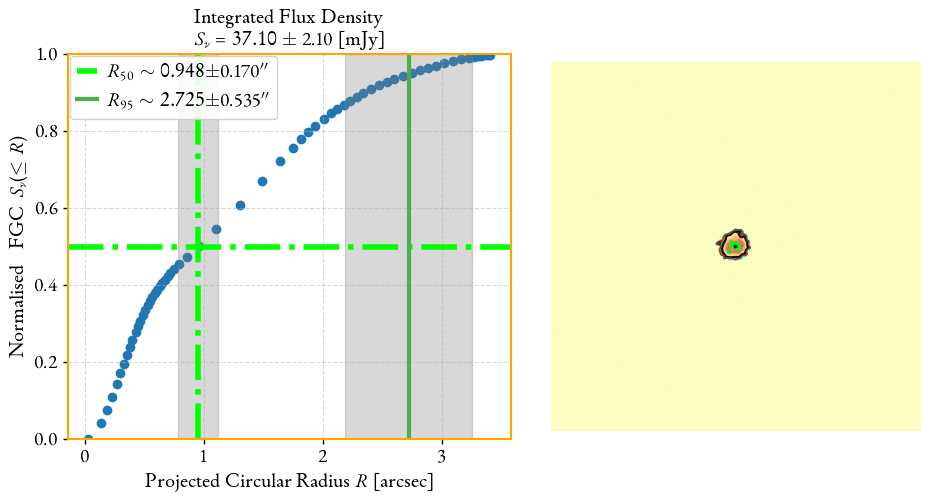

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 43.52 +/- 3.69 mJy
Fractional error = 0.08
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 43.52 +/- 2.47 mJy
Fractional error = 0.06
Flux Density = 43.52 +

<Figure size 500x500 with 0 Axes>

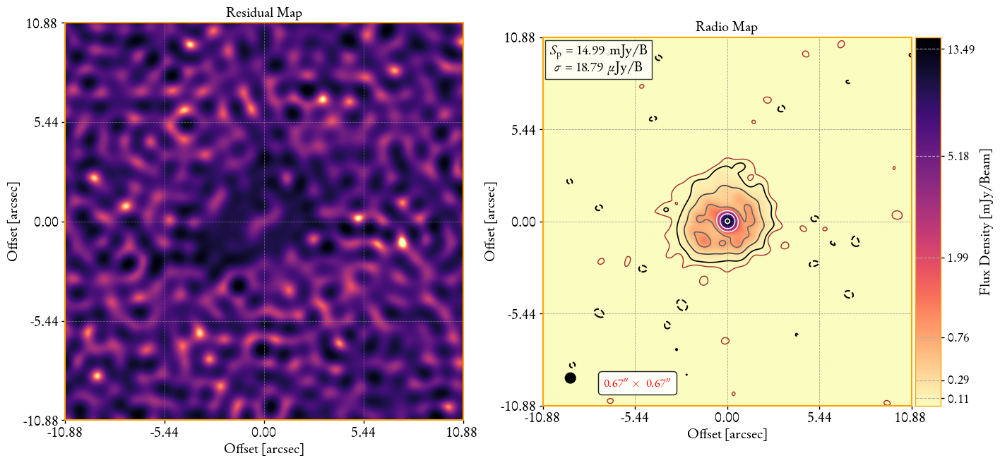

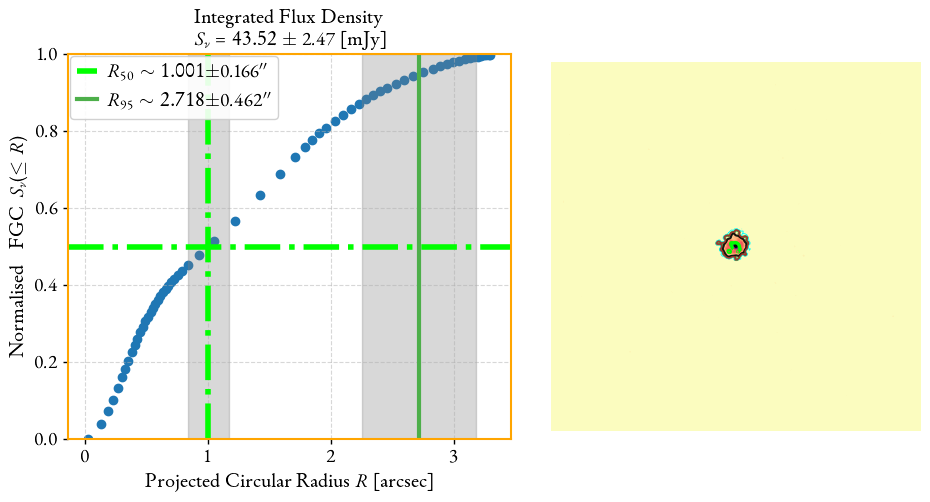

Flux density =  0.04351989507455112
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 32.88 +/- 2.21 mJy
Fractional error = 0.07
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 32.88 +/- 1.86 mJy
Fractional error = 0.06
Flux Density = 32.88 +/- 2.89 mJy
Fractional error 4 = 0.09
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 13.69 +/- 0.03 [mJy/beam]
 ==>  Snu (within mask) = 32.88 +/- 2.21 [mJy]
 ==>  Snu (image)       = 32.74 +/- 2.21 [mJy]
 ==>  R50               = 0.9045 +/- 0.1724 [arcsec]
 ==>  R95               = 2.6722 +/- 0.5077 [arcsec]


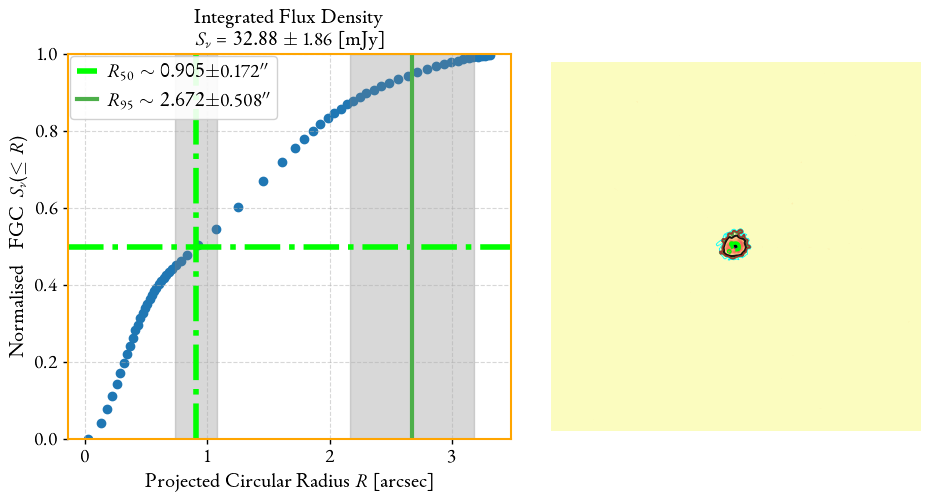

Flux density =  0.03287577661770923
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 38.03 +/- 2.28 mJy
Fractional error = 0.06
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 38.03 +/- 2.15 mJy
Fractional error = 0.06
Flux Density = 38.03 +/- 3.09 mJy
Fractional error 4 = 0.08
-----------------------------------------------------------------
 ==>  Peak of Flux      = 15.30 +/- 0.03 [mJy/beam]
 ==>  Snu (within mask) = 

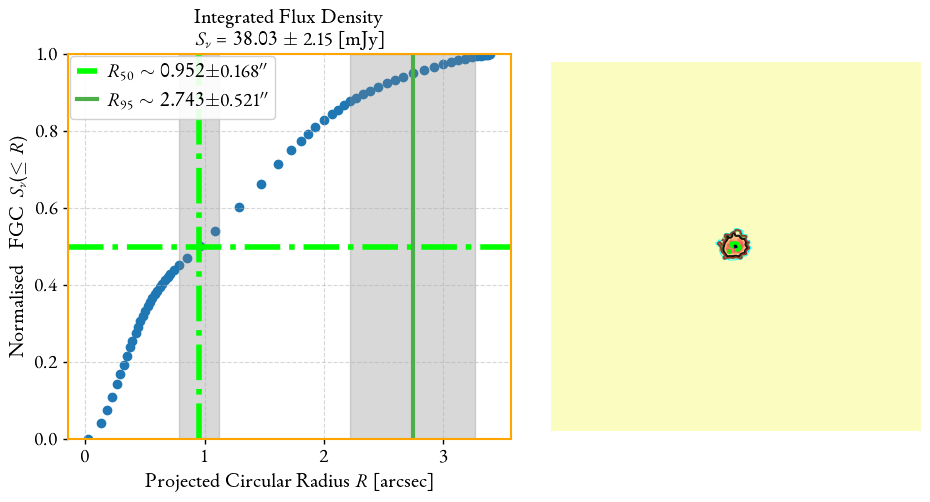

Flux density =  0.03803329245690717
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         8.3958e+00                                    1.09e+03    
       1              2         7.2055e+00      1.19e+00       4.58e+01       9.08e+00    
       2              3         7.0627e+00      1.43e-01       8.54e-01       9.37e+00    
       3              4         6.7572e+00      3.05e-01       1.69e+00       1.00e+01    
       4              5         6.0419e+00      7.15e-01       3.32e+00       1.19e+01    
       5              6         3.3160e+00      2.73e+00       6.29e+00       2.40e+01    
       6              8         3.0779e+00      2.38e-01       2.98e+00       1.34e+01    
       7              9         2.1891e+00      8.89e-01       2.57e-01       1.55e+01    
       8             10         1.3541e+00      8.35e-01       9.79e-01       3.40e+01    
       9             11         1.0872e+00      2.67e-

100%|██████████| 5000/5000 [00:06<00:00, 790.92it/s]


{'A1': {'best': 37.43033572838911, 'lower_bound': 36.19949791063963, 'upper_bound': 38.65425570074648, 'lower': 1.2308378177494816, 'upper': 1.223919972357372}, 'alpha': {'best': -0.6081667779278981, 'lower_bound': -0.7815135763030301, 'upper_bound': -0.43332871038076526, 'lower': 0.173346798375132, 'upper': 0.17483806754713282}}


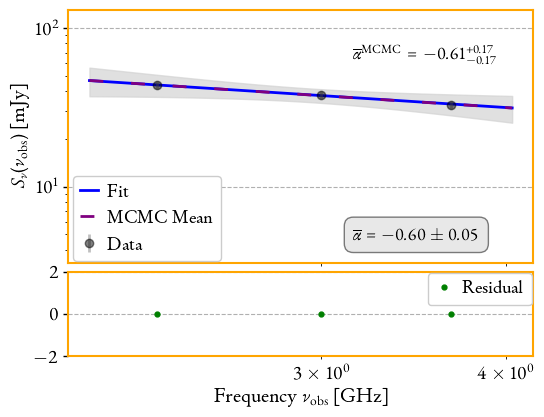

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

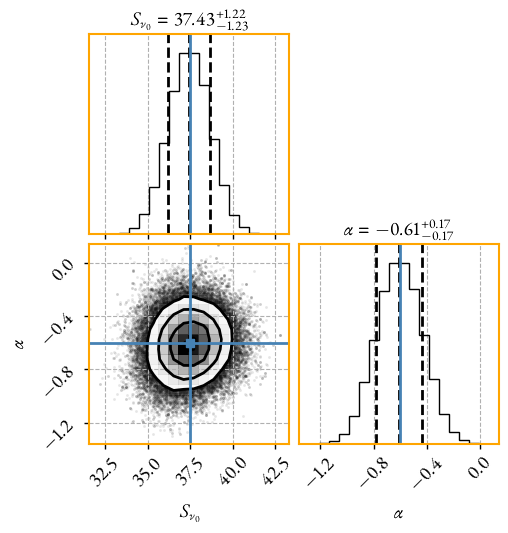

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     37.4914471 +/- 0.41009186 (1.09%) (init = 37.49145)
    alpha: -0.60371057 +/- 0.05437984 (9.01%) (init = -0.6037106)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.274
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.672 arcec            
---------------------------------------------
Imaging instrument/band VLA_A_C
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/C/Mrk331_A_C_EVLA_sfc_ps_lowres.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  0.0
Using mtmfs method.
im_nc3_cb_Mrk331_A_C_EVLA_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/for_spi

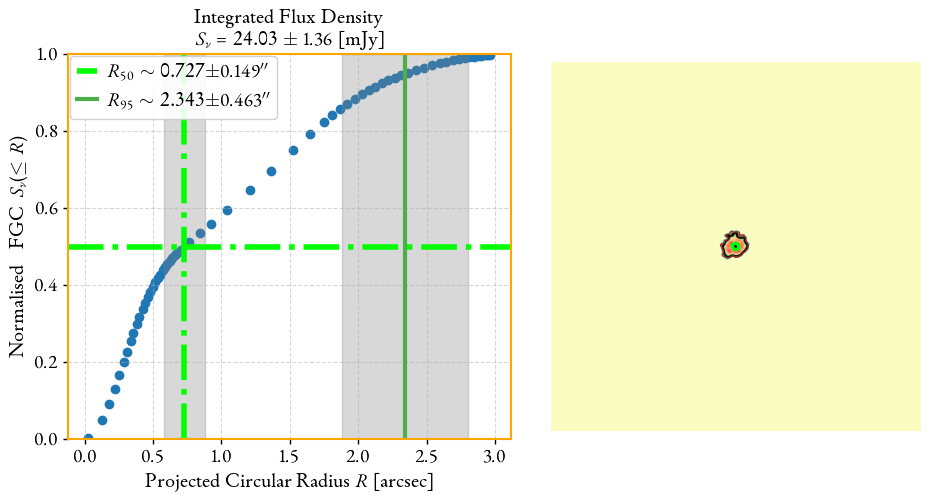

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/C/im_nc3_cb_Mrk331_A_C_EVLA_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/C/im_nc3_cb_Mrk331_A_C_EVLA_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/C/im_nc3_cb_Mrk331_A_C_EVLA_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 26.83 +/- 1.52 mJy
Fractional error = 0.06
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 26.83 +/- 1.55 mJy
Fractional error = 0.06
Flux De

/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 12.62 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask) = 26.83 +/- 1.52 [mJy]
 ==>  Snu (image)       = 26.58 +/- 1.52 [mJy]
 ==>  R50               = 0.7206 +/- 0.1478 [arcsec]
 ==>  R95               = 2.3402 +/- 0.4766 [arcsec]


<Figure size 500x500 with 0 Axes>

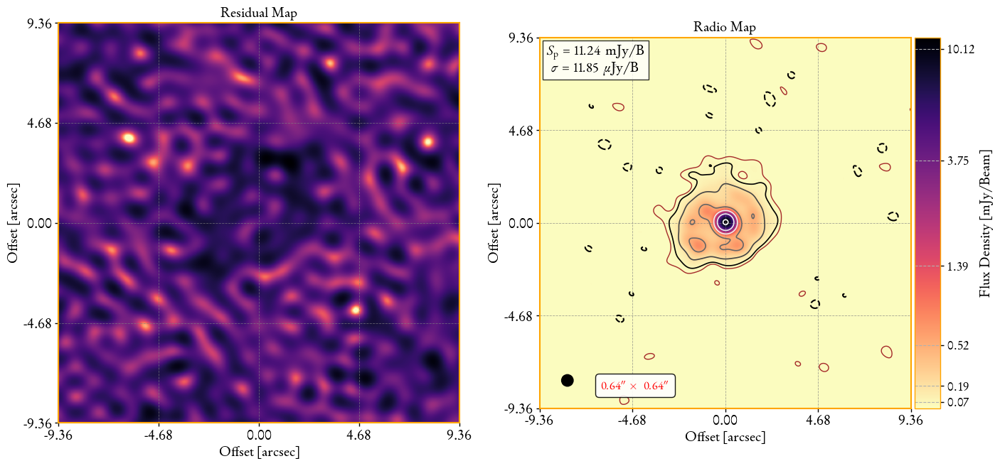

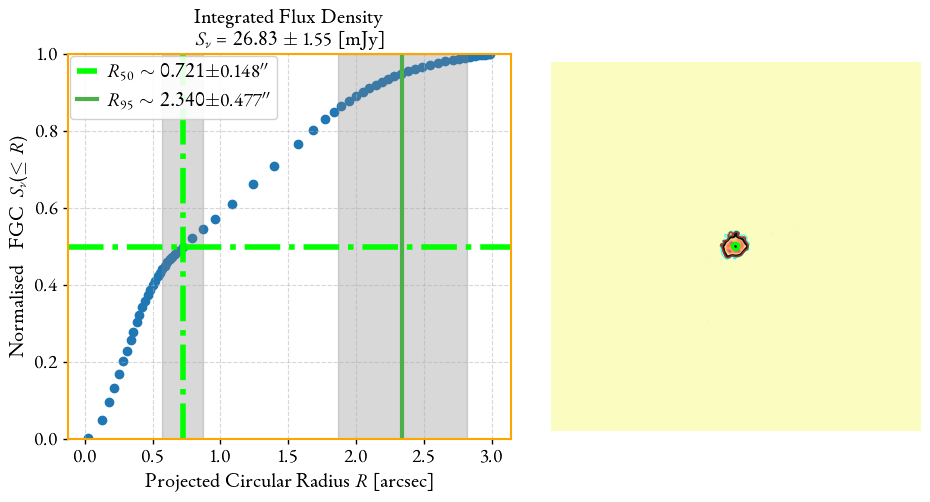

Flux density =  0.02682556213391168
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/C/im_nc3_cb_Mrk331_A_C_EVLA_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/C/im_nc3_cb_Mrk331_A_C_EVLA_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 23.38 +/- 1.31 mJy
Fractional error = 0.06
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 23.38 +/- 1.30 mJy
Fractional error = 0.06
Flux Density = 23.38 +/- 1.91 mJy
Fractional error 4 = 0.08
-----------------------------------------------------------------
 ==>  Peak of Flux      = 10.82 +/- 0.02 [mJy/beam]
 ==>  Snu (withi

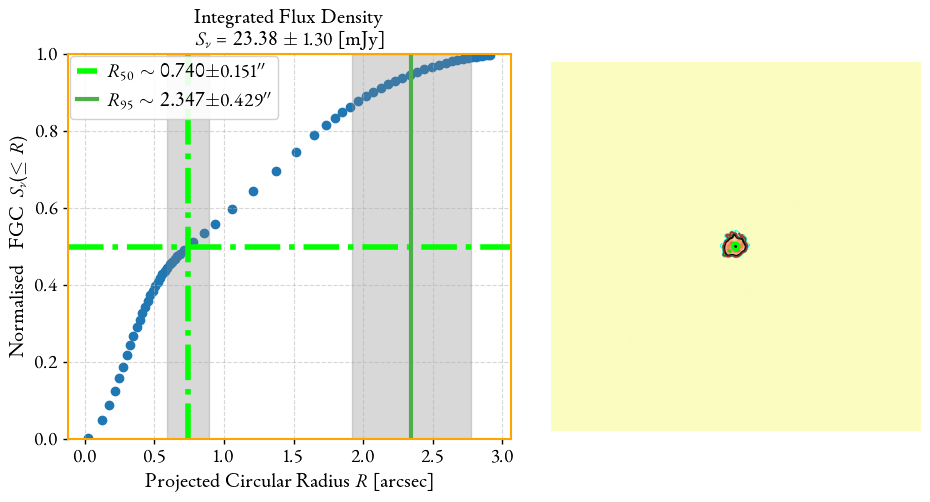

Flux density =  0.0233831660734836
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/C/im_nc3_cb_Mrk331_A_C_EVLA_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/C/im_nc3_cb_Mrk331_A_C_EVLA_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 20.03 +/- 1.48 mJy
Fractional error = 0.07
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 20.03 +/- 1.11 mJy
Fractional error = 0.06
Flux Density = 20.03 +/- 1.79 mJy
Fractional error 4 = 0.09
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 9.38 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask) = 20.03 +/- 1.48 [mJy]
 ==>  Snu (image)       = 20.13 +/- 1.48 [mJy]
 ==>  R50               = 0.7255 +/- 0.1499 [arcsec]
 ==>  R95               = 2.3202 +/- 0.4237 [arcsec]


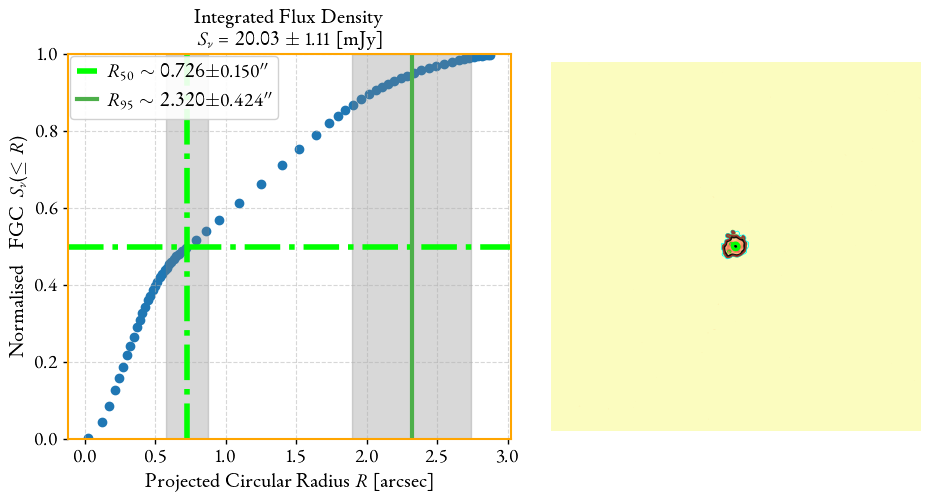

Flux density =  0.02002797581566951
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         6.1554e+00                                    2.29e+03    
       1              3         8.5850e-01      5.30e+00       1.15e+01       7.36e+03    
       2              5         4.9481e-01      3.64e-01       2.51e+00       1.75e+01    
       3              6         2.7675e-01      2.18e-01       2.49e-01       1.47e+01    
       4              7         5.5657e-02      2.21e-01       5.56e-01       2.93e+00    
       5              8         3.8408e-02      1.72e-02       1.80e-01       6.85e+01    
       6              9         3.8304e-02      1.04e-04       1.06e-02       2.08e-01    
       7             10         3.8304e-02      2.15e-09       1.48e-05       1.37e-05    
       8             11         3.8304e-02      1.17e-13       1.71e-07       3.98e-09    
       9             14         3.8304e-02      3.47e-

100%|██████████| 5000/5000 [00:06<00:00, 797.48it/s]


{'A1': {'best': 22.94931027680258, 'lower_bound': 22.213226832209436, 'upper_bound': 23.70424438923574, 'lower': 0.7360834445931452, 'upper': 0.7549341124331583}, 'alpha': {'best': -0.6356415861903968, 'lower_bound': -0.8064542843428774, 'upper_bound': -0.46035531490775244, 'lower': 0.17081269815248057, 'upper': 0.17528627128264435}}


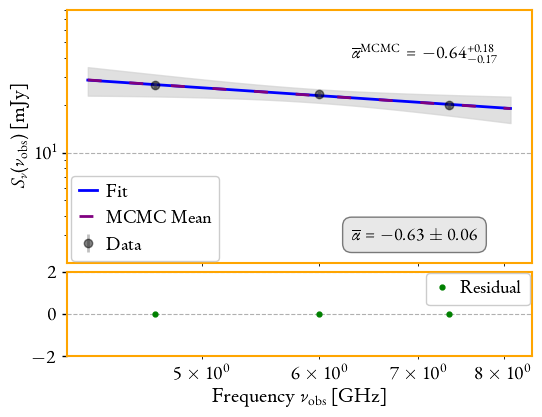

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

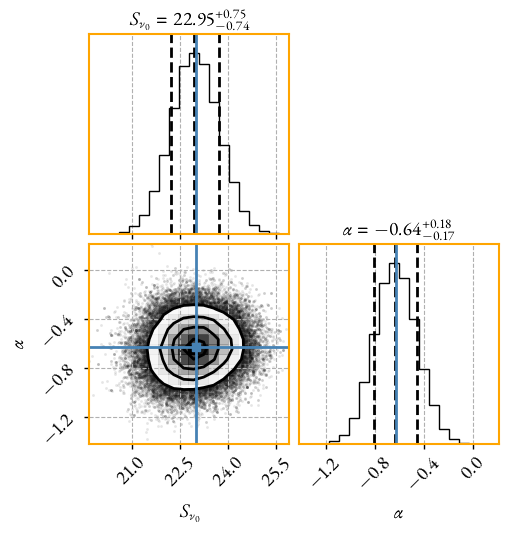

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     22.9942141 +/- 0.28897357 (1.26%) (init = 22.99421)
    alpha: -0.62752995 +/- 0.06368873 (10.15%) (init = -0.6275299)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.256
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.639 arcec            
---------------------------------------------
Imaging instrument/band VLA_A_X
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/MRK0331_A_X_sf_ps_lowres.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  0.0
Using mtmfs method.
im_nc3_cb_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/

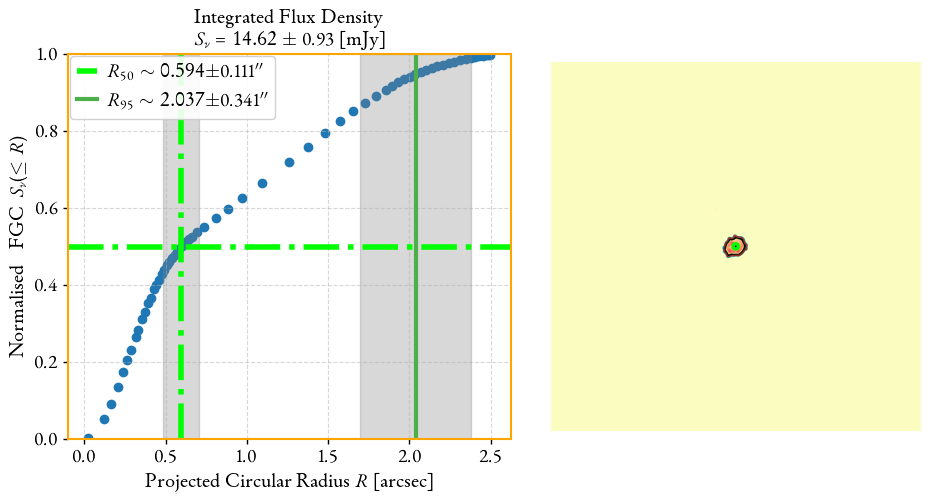

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 16.31 +/- 1.04 mJy
Fractional error = 0.06
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 16.31 +/- 1.04 mJy
Fractional error = 0.06
Flux Density = 16.31 +

<Figure size 500x500 with 0 Axes>

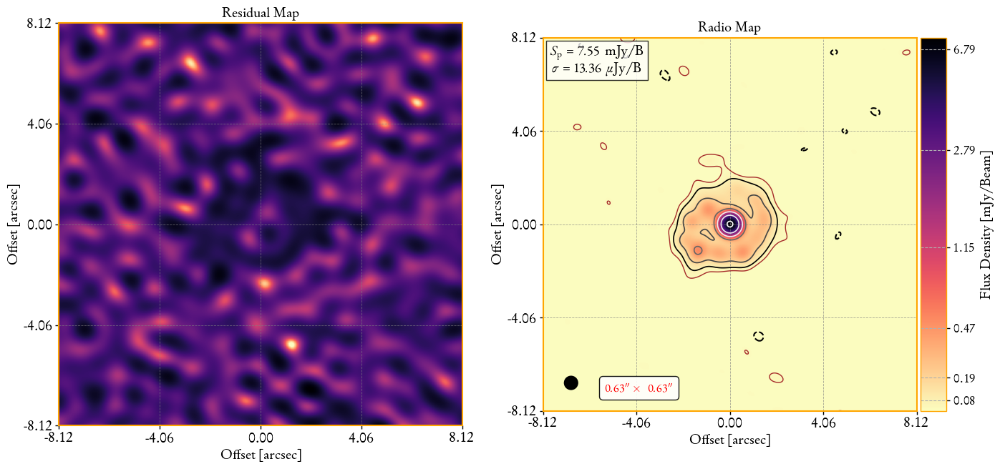

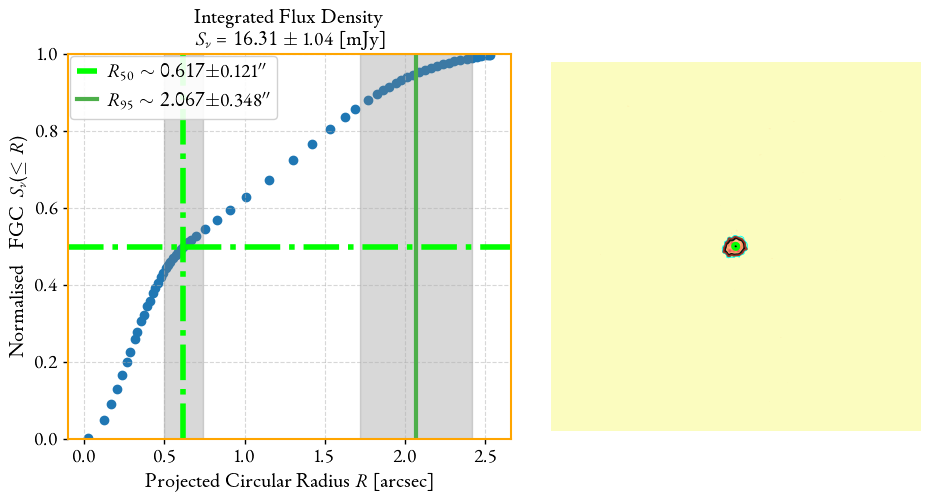

Flux density =  0.016314268057560775
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 12.85 +/- 1.19 mJy
Fractional error = 0.09
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 12.85 +/- 0.80 mJy
Fractional error = 0.06
Flux Density = 12.85 +/- 1.54 mJy
Fractional error 4 = 0.12
-----------------------------------------------------------------
 ==>  Peak of Flux      = 6.74 +/- 0.03 [mJy/beam]
 ==>  Snu (within mask) = 

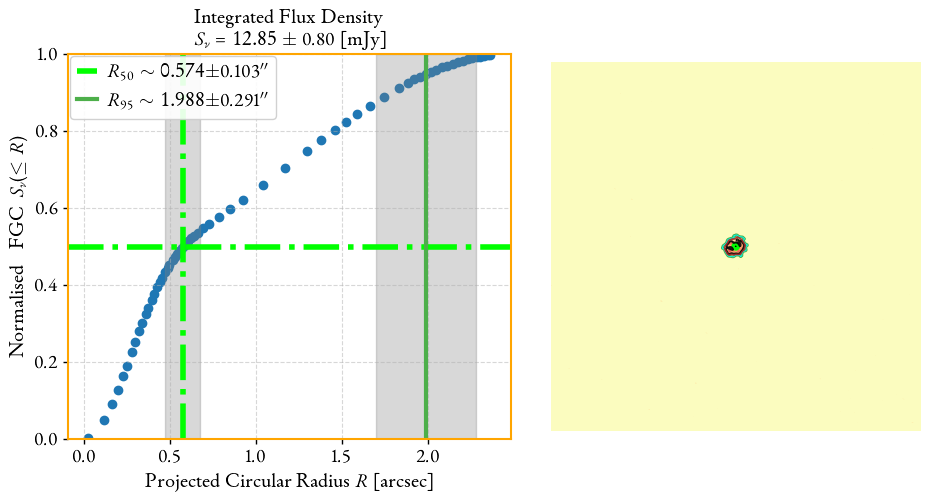

Flux density =  0.012853298156560314
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 13.83 +/- 1.22 mJy
Fractional error = 0.09
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 13.83 +/- 0.88 mJy
Fractional error = 0.06
Flux Density = 13.83 +/- 1.37 mJy
Fractional error 4 = 0.10
-----------------------------------------------------------------
 ==>  Peak of Flux      = 7.31 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask) = 

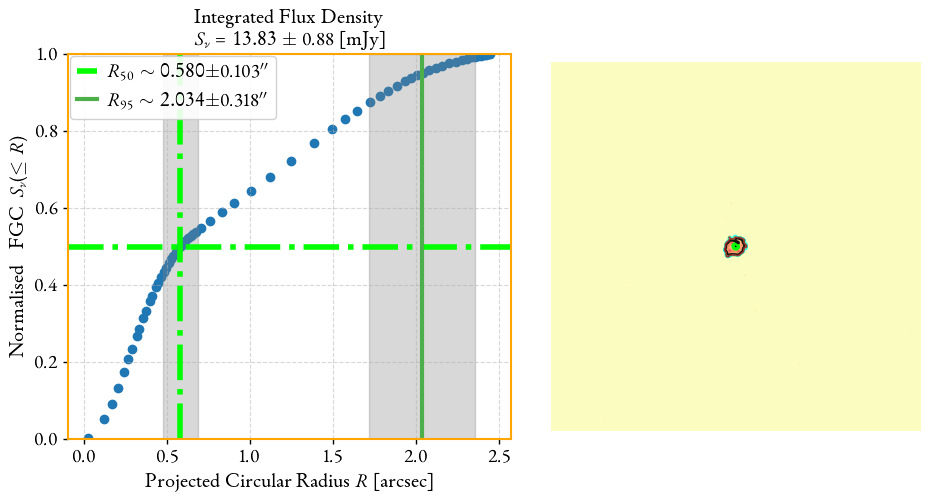

Flux density =  0.013825202824066334
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         2.9394e+00                                    6.14e+03    
       1              4         7.3401e-01      2.21e+00       2.86e+00       8.31e+03    
       2              6         4.8429e-02      6.86e-01       1.43e+00       1.18e+00    
       3              7         4.2006e-02      6.42e-03       3.73e-02       8.22e-01    
       4              8         3.4342e-02      7.66e-03       6.83e-02       2.63e-01    
       5              9         3.2844e-02      1.50e-03       4.22e-02       6.71e-03    
       6             10         3.2843e-02      1.16e-06       1.17e-03       9.21e-05    
       7             11         3.2843e-02      1.80e-10       1.27e-05       1.20e-06    
       8             12         3.2843e-02      2.93e-14       1.62e-07       9.90e-08    
       9             19         3.2843e-02      3.47e

100%|██████████| 5000/5000 [00:06<00:00, 796.43it/s]


{'A1': {'best': 14.159458354505693, 'lower_bound': 13.647765945635795, 'upper_bound': 14.68060518280517, 'lower': 0.511692408869898, 'upper': 0.5211468282994769}, 'alpha': {'best': -0.8793689445597657, 'lower_bound': -1.2114739327422555, 'upper_bound': -0.5495148022248475, 'lower': 0.3321049881824898, 'upper': 0.32985414233491817}}


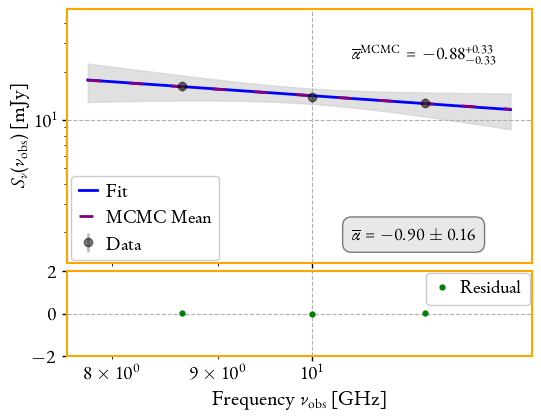

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

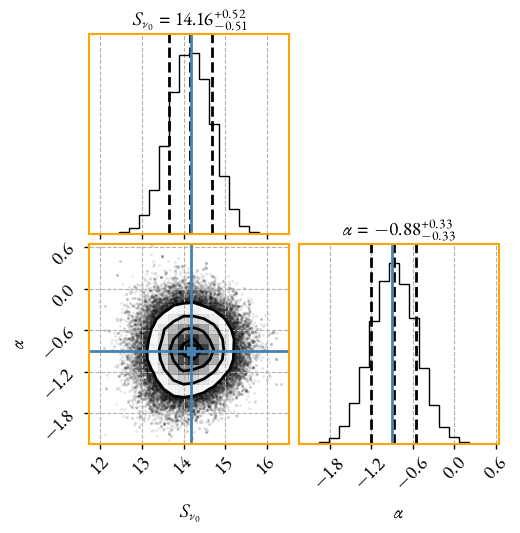

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     14.1832558 +/- 0.26523203 (1.87%) (init = 14.18326)
    alpha: -0.89913544 +/- 0.16337812 (18.17%) (init = -0.8991354)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.198
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.626 arcec            
---------------------------------------------
Imaging instrument/band VLA_C_Ku
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ku/Mrk331_C_Ku_sfc_ps_lowres.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  0.0
Using mtmfs method.
im_nc3_cb_Mrk331_C_Ku_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk

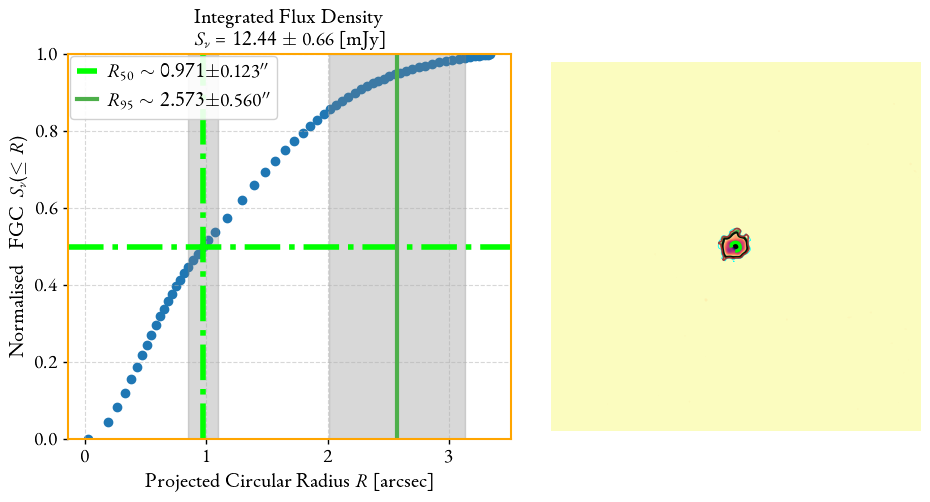

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ku/im_nc3_cb_Mrk331_C_Ku_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ku/im_nc3_cb_Mrk331_C_Ku_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ku/im_nc3_cb_Mrk331_C_Ku_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 13.33 +/- 0.79 mJy
Fractional error = 0.06
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 13.33 +/- 0.70 mJy
Fractional error = 0.05
Flux Density = 1

<Figure size 500x500 with 0 Axes>

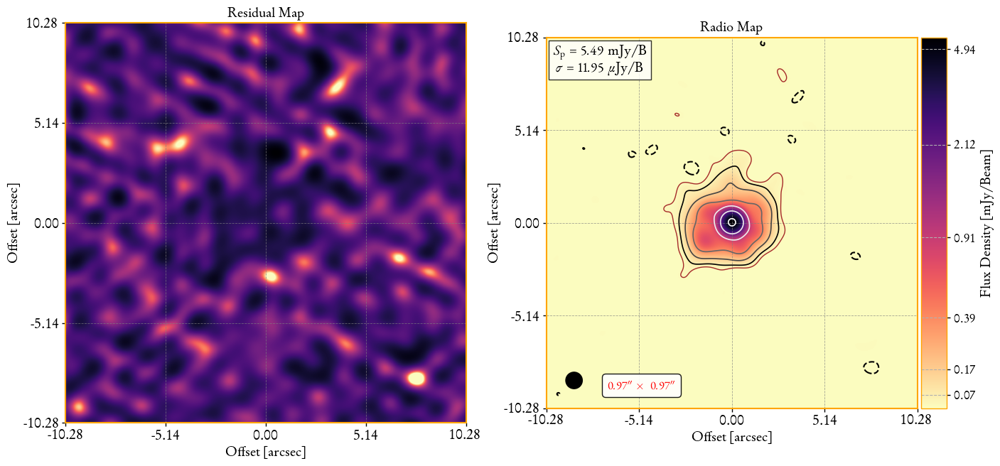

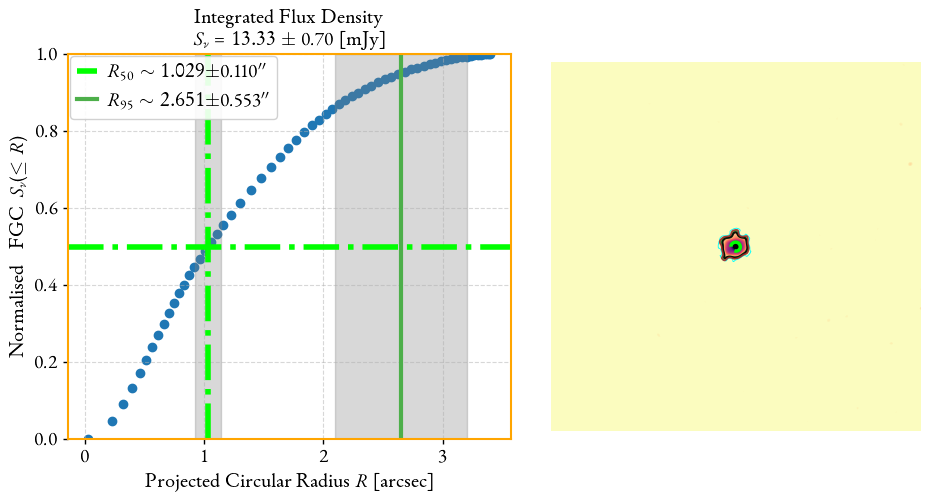

Flux density =  0.013328916846770516
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ku/im_nc3_cb_Mrk331_C_Ku_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ku/im_nc3_cb_Mrk331_C_Ku_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 12.51 +/- 0.80 mJy
Fractional error = 0.06
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 12.51 +/- 0.66 mJy
Fractional error = 0.05
Flux Density = 12.51 +/- 1.03 mJy
Fractional error 4 = 0.08
-----------------------------------------------------------------
 ==>  Peak of Flux      = 5.46 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask

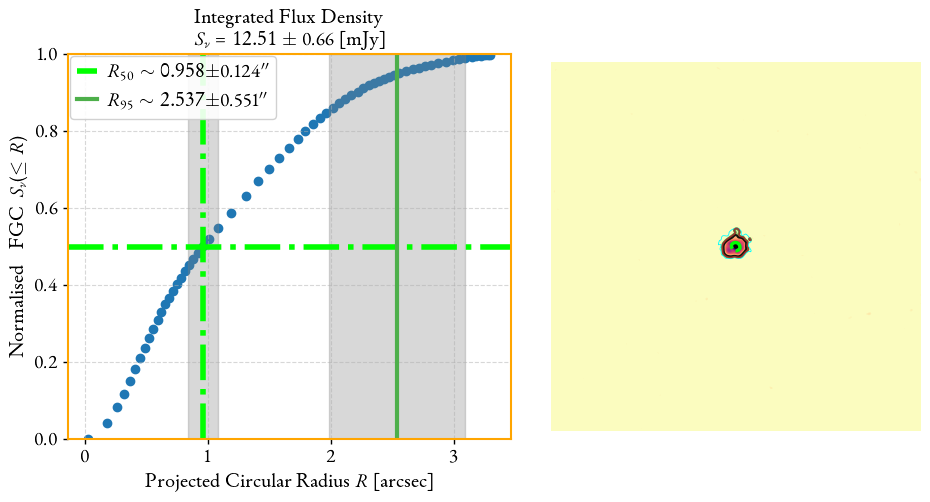

Flux density =  0.01250644350926143
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ku/im_nc3_cb_Mrk331_C_Ku_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ku/im_nc3_cb_Mrk331_C_Ku_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 11.51 +/- 1.01 mJy
Fractional error = 0.09
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 11.51 +/- 0.63 mJy
Fractional error = 0.05
Flux Density = 11.51 +/- 1.23 mJy
Fractional error 4 = 0.11
-----------------------------------------------------------------
 ==>  Peak of Flux      = 4.90 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask)

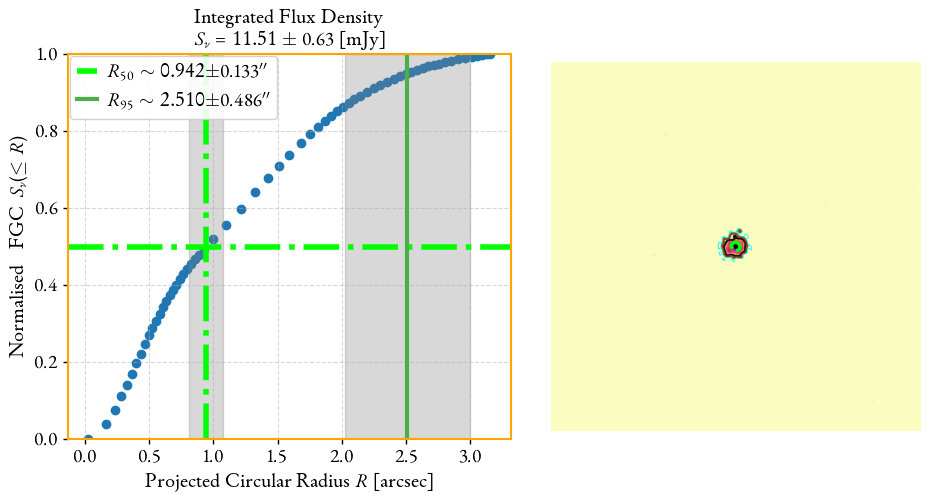

Flux density =  0.011506527551832695
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         1.6108e+00                                    8.43e+03    
       1              4         1.9907e-01      1.41e+00       2.86e+00       5.88e+00    
       2              5         1.4584e-01      5.32e-02       9.15e-02       5.11e+00    
       3              6         6.1163e-02      8.47e-02       1.78e-01       3.32e+00    
       4              7         4.9622e-03      5.62e-02       3.22e-01       4.03e+02    
       5              8         3.3087e-03      1.65e-03       4.43e-02       2.11e-03    
       6              9         3.3086e-03      1.51e-08       1.74e-04       1.61e-06    
       7             10         3.3086e-03      3.08e-14       1.83e-07       6.09e-06    
       8             11         3.3086e-03      3.34e-17       6.00e-10       1.62e-08    
       9             21         3.3086e-03      0.00e

100%|██████████| 5000/5000 [00:05<00:00, 836.78it/s]


{'A1': {'best': 12.376052086129324, 'lower_bound': 11.996911229958542, 'upper_bound': 12.752242936570985, 'lower': 0.37914085617078186, 'upper': 0.37619085044166134}, 'alpha': {'best': -0.5354464198237342, 'lower_bound': -0.8128170617089949, 'upper_bound': -0.2620401967899683, 'lower': 0.2773706418852607, 'upper': 0.2734062230337659}}


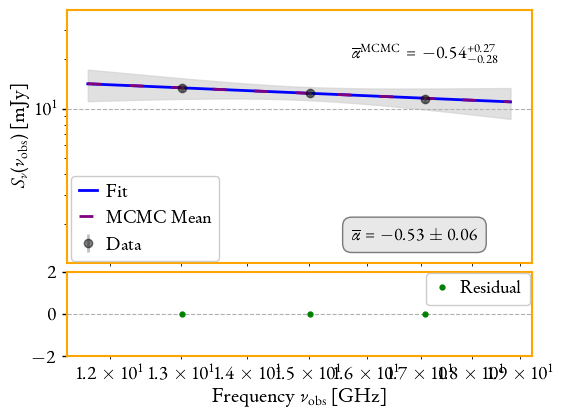

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

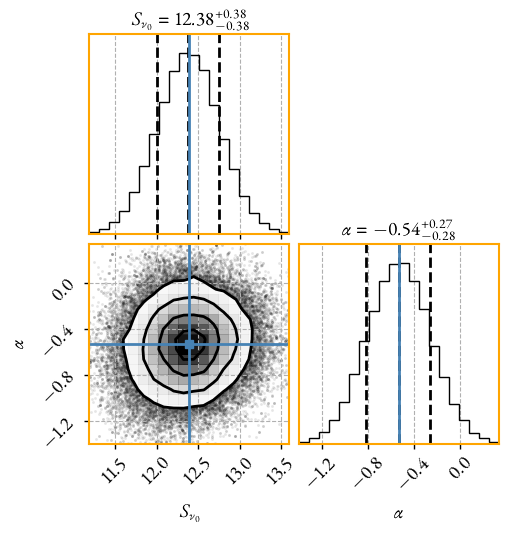

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     12.3846577 +/- 0.08054072 (0.65%) (init = 12.38466)
    alpha: -0.53410839 +/- 0.05780514 (10.82%) (init = -0.5341084)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.148
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.974 arcec            
---------------------------------------------
Imaging instrument/band VLA_C_Ka
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/Mrk331_C_Ka_2x_sf_ps_lowres.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  0.0
Using mtmfs method.
im_nc3_cb_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/for_spix

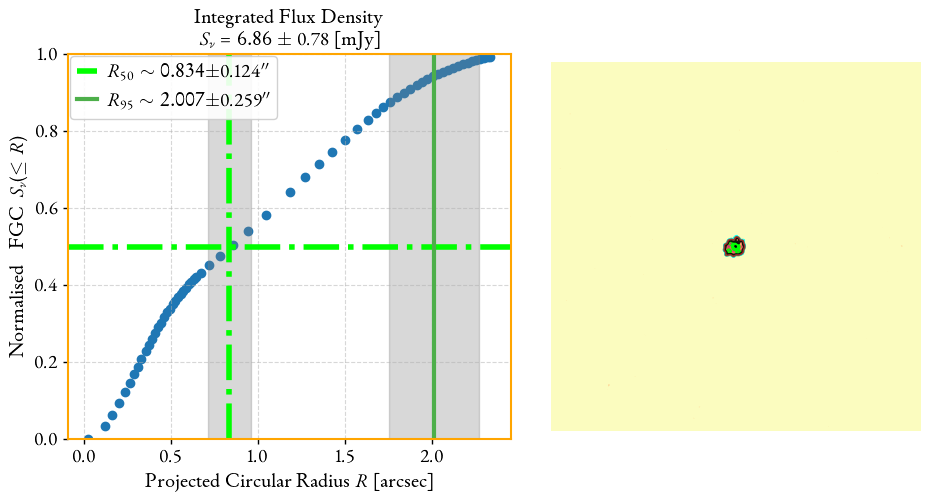

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 7.34 +/- 1.05 mJy
Fractional error = 0.14
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 7.34 +/- 0.86 mJy
Fractional error = 0.12
Flux Density

<Figure size 500x500 with 0 Axes>

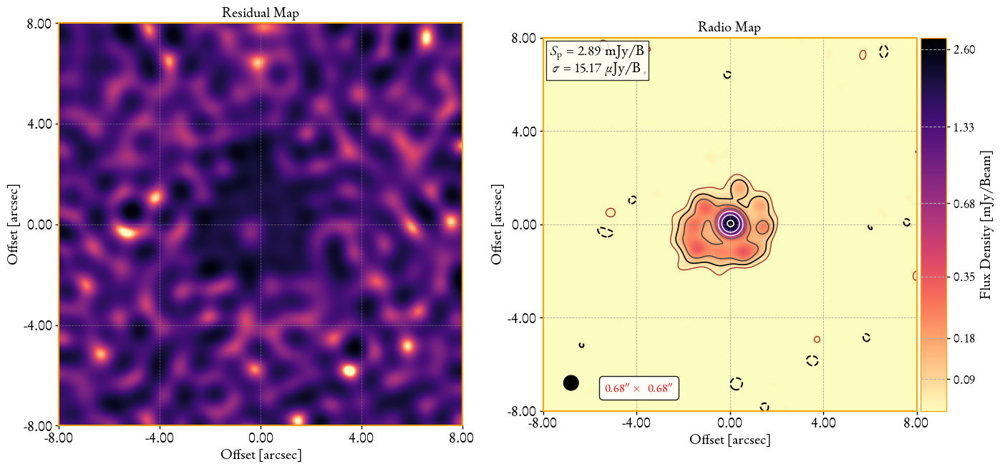

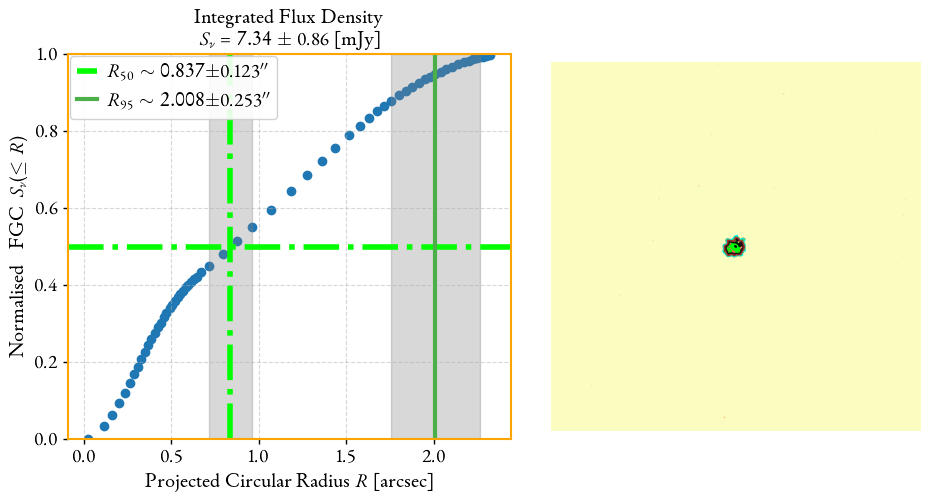

Flux density =  0.007339800913223033
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 6.88 +/- 1.15 mJy
Fractional error = 0.17
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 6.88 +/- 0.79 mJy
Fractional error = 0.11
Flux Density = 6.88 +/- 1.29 mJy
Fractional error 4 = 0.19
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 2.89 +/- 0.03 [mJy/beam]
 ==>  Snu (within mask) = 6.88 +/- 1.15 [mJy]
 ==>  Snu (image)       = 5.64 +/- 1.15 [mJy]
 ==>  R50               = 0.8502 +/- 0.1250 [arcsec]
 ==>  R95               = 2.0120 +/- 0.2280 [arcsec]


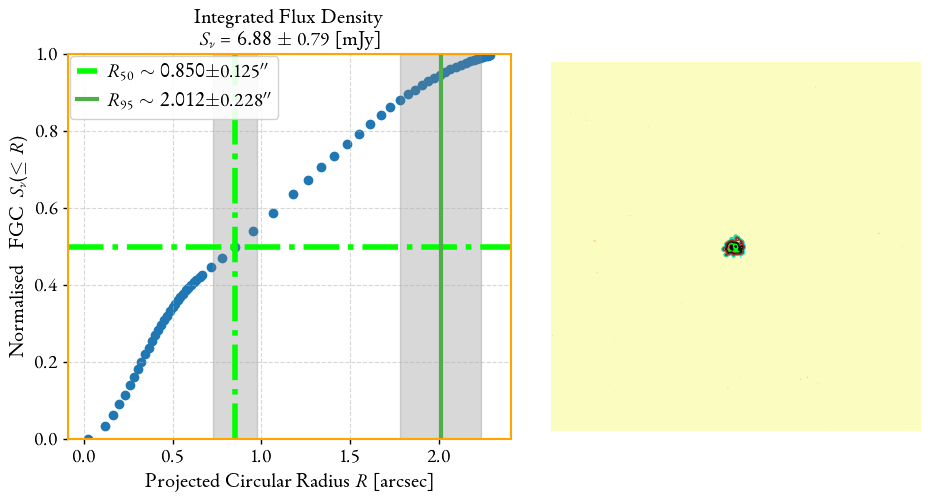

Flux density =  0.006884938319008357
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 6.16 +/- 1.13 mJy
Fractional error = 0.18
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 6.16 +/- 0.67 mJy
Fractional error = 0.11
Flux Density = 6.16 +/- 1.25 mJy
Fractional error 4 = 0.20
-----------------------------------------------------------------
 ==>  Peak of Flux      = 2.64 +/- 0.03 [mJy/beam]
 ==>  Snu (within mas

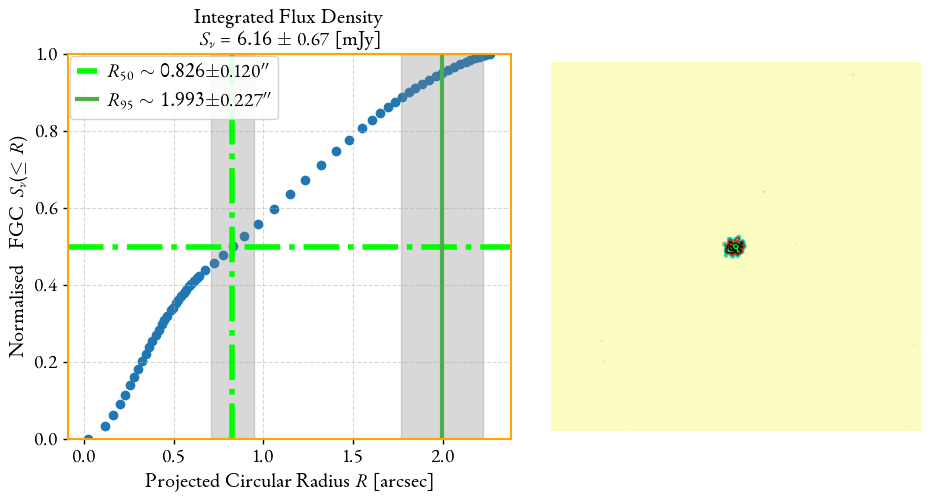

Flux density =  0.006161035937671334
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         2.3259e+00                                    7.39e+00    
       1              3         2.5836e-01      2.07e+00       2.52e+00       4.79e+00    
       2              4         4.1666e-02      2.17e-01       1.19e+00       2.24e+03    
       3              5         4.4938e-03      3.72e-02       4.60e-01       1.26e-01    
       4              6         4.2425e-03      2.51e-04       3.51e-02       2.68e-04    
       5              7         4.2425e-03      7.36e-10       3.85e-05       7.91e-08    
       6              8         4.2425e-03      1.83e-15       1.30e-07       2.25e-06    
       7              9         4.2425e-03      9.54e-18       5.16e-09       9.83e-08    
       8             18         4.2425e-03      8.67e-19       5.85e-14       4.09e-09    
`ftol` termination condition is satisfied.
Function e

100%|██████████| 5000/5000 [00:05<00:00, 839.89it/s]


{'A1': {'best': 6.715399190330427, 'lower_bound': 6.281699077601898, 'upper_bound': 7.158335522664564, 'lower': 0.4337001127285287, 'upper': 0.44293633233413754}, 'alpha': {'best': -1.0944115239378203, 'lower_bound': -2.0571304076141796, 'upper_bound': -0.11320542682320645, 'lower': 0.9627188836763594, 'upper': 0.9812060971146138}}


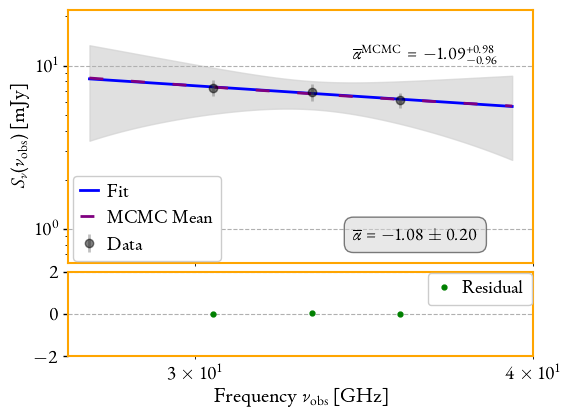

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

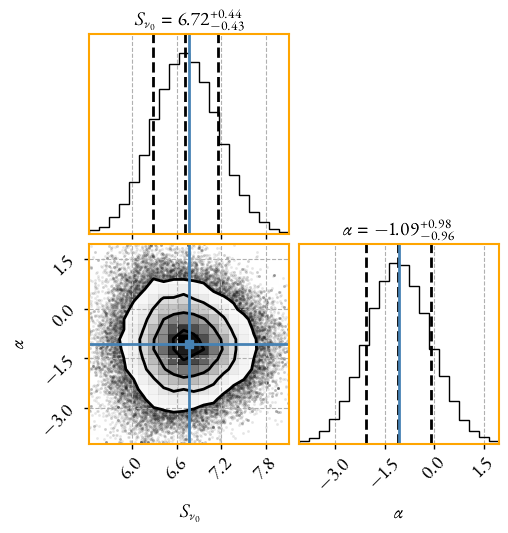

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     6.76154764 +/- 0.08995890 (1.33%) (init = 6.761548)
    alpha: -1.08187808 +/- 0.20180516 (18.65%) (init = -1.081878)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.114
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.678 arcec            
---------------------------------------------


In [10]:
robust = [0.0]
for vis_name in list(vis_list_uv_match.keys()):
    print(f"Imaging instrument/band {vis_name}")
    print(f"    > Visibility: {vis_list_uv_match[vis_name]}")
    for ROBUST in robust:
        image_list,image_statistics,Omaj = \
            mlibs.run_wsclean(vis_list_uv_match[vis_name], robust=ROBUST,
                        imsize=imsizex, 
                        imsizey=imsizey, 
                        opt_args= opt_args,
                        cell=cell,
                        base_name=prefix,
                        nsigma_automask=nsigma_automask,
                        nsigma_autothreshold=nsigma_autothreshold,
                        quiet=True,
                        nc=n_subimages,
                        with_multiscale=True,
                        # scales='0,40,120,240',
                        scales='None',
                        datacolumn='DATA',
                        uvtaper=uvtaper,
                        niter=100000)
        beam_sizes.append(Omaj)


## Imaging with common $uv$ range and common restoring beam $\Theta_{\lambda}$
Now we can use the restoring beam sizes from the previous imaging run to generate new images, now with common $uv$ range and common 
restoring beam $\Theta_{\lambda}$.
Note that to achieve similar sensitivity in all images, we also need to apply different weighting schemes for some observing bands.

In [13]:
beam_sizes

[1.0716892344352043,
 0.6722728160090508,
 0.6385142049658092,
 0.6257985860743884,
 0.9744109616610107,
 0.6780196466820541]

In [14]:
print(f"Mean restoring beam size = {np.mean(beam_sizes):.1f}")
print(f"Median restoring beam size = {np.median(beam_sizes):.1f}")
print(f"Min restoring beam size = {np.min(beam_sizes):.1f}")
print(f"Max restoring beam size = {np.max(beam_sizes):.1f}")

sky_taper = f"{np.max(beam_sizes):.1f}asec"
restoring_beam_size = f"{np.mean(beam_sizes):.1f}asec"
print(f"Suggested skytaper = {sky_taper}")
print(f"Suggested restoring beam = {restoring_beam_size}")

Mean restoring beam size = 0.8
Median restoring beam size = 0.7
Min restoring beam size = 0.6
Max restoring beam size = 1.1
Suggested skytaper = 1.1asec
Suggested restoring beam = 0.8asec


# $\text{Restore images with }\Theta = 0.80''$

In [11]:
# restoring_beam_size = '0.80asec'
# sky_taper = '1.10asec'
# nsigma_automask='4.0'
# nsigma_autothreshold='1.5'
opt_args= f"' -circular-beam -beam-size {restoring_beam_size}'"
prefix = f"im_nc{n_subimages}_cb_bs_{restoring_beam_size}"
print(prefix)

im_nc3_cb_bs_0.80asec


Imaging instrument/band VLA_A_L
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/Mrk331_A_L_sfc_uvsub_ps_lowres.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  0.0
Using mtmfs method.
im_nc3_cb_bs_0.80asec_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/:/mnt /media/sagauga/xfs_evo/wsclean3.4-idg-everybeam-eMERLIN_portable.sif wsclean -name /mnt/im_nc3_cb_bs_0.80asec_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0 -size 2048 2048 -scale 0.04asec  -mgain 0.5 -gain 0.1 -nmiter 500  -niter 100000 -weight briggs 0.0  -auto-mask 4.0  -auto-threshold 1.5  -multiscale  -multiscale-scale-bias 0.7 -multiscale-gain 0.1  -multiscale-max-scales 6   -deconvolution-threads

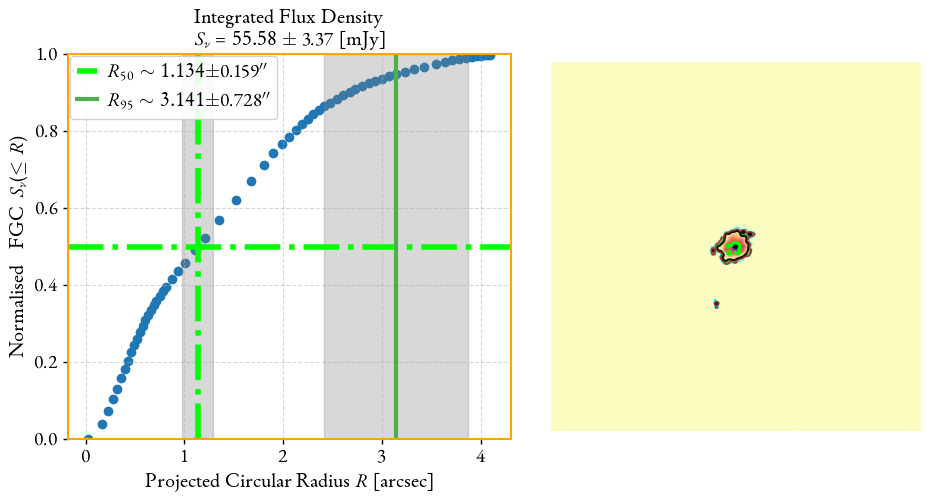

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_bs_0.80asec_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_bs_0.80asec_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_bs_0.80asec_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 66.52 +/- 6.19 mJy
Fractional error = 0.09
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 66

<Figure size 500x500 with 0 Axes>

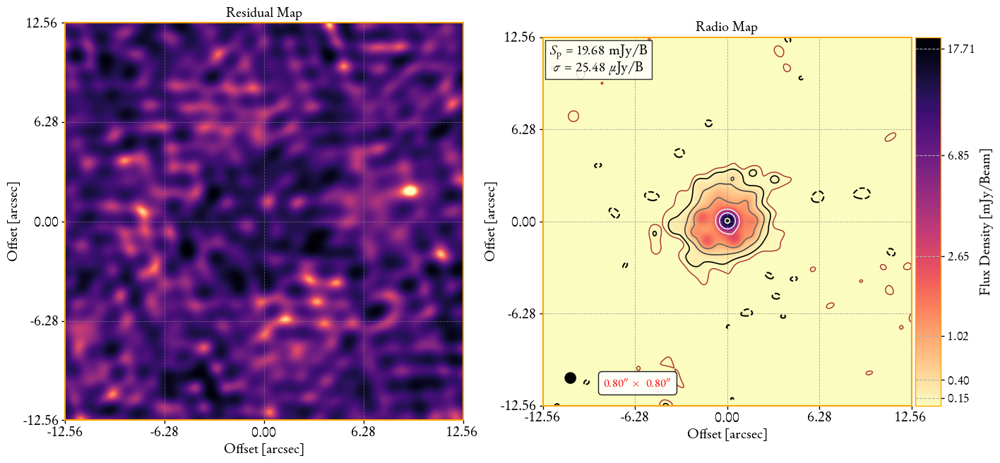

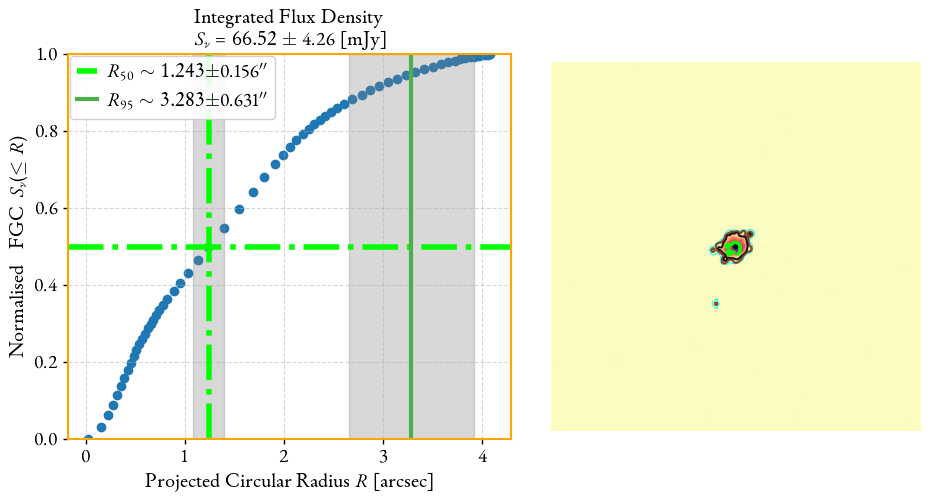

Flux density =  0.06652041697421697
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_bs_0.80asec_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_bs_0.80asec_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 56.03 +/- 4.43 mJy
Fractional error = 0.08
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 56.03 +/- 3.38 mJy
Fractional error = 0.06
Flux Density = 56.03 +/- 4.64 mJy
Fractional error 4 = 0.08
-----------------------------------------------------------------
 ==>  Peak of Flux      = 19.78 +/- 

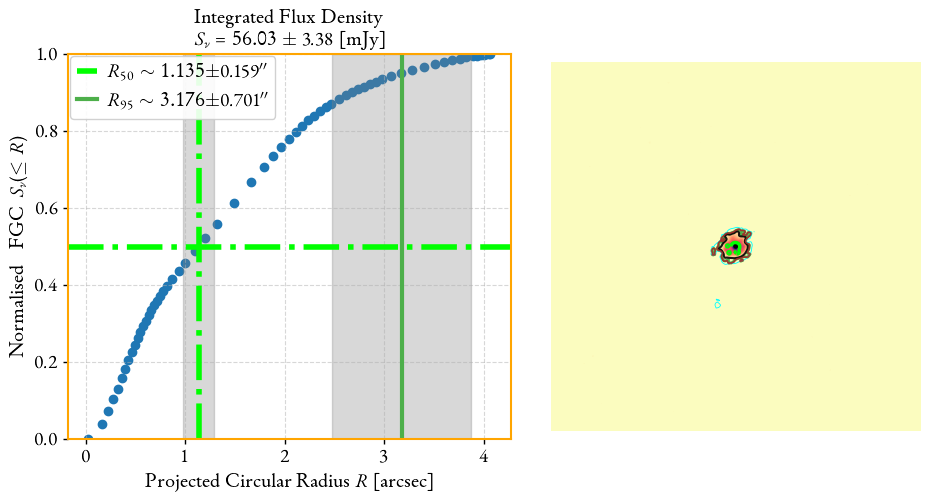

Flux density =  0.056033368897577686
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_bs_0.80asec_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_bs_0.80asec_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 49.62 +/- 4.66 mJy
Fractional error = 0.09
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 49.62 +/- 2.92 mJy
Fractional error = 0.06
Flux Density = 49.62 +/- 4.41 mJy
Fractional error 4 = 0.09
-----------------------------------------------------------------
 ==>  Peak of Flux      = 18.87 +/-

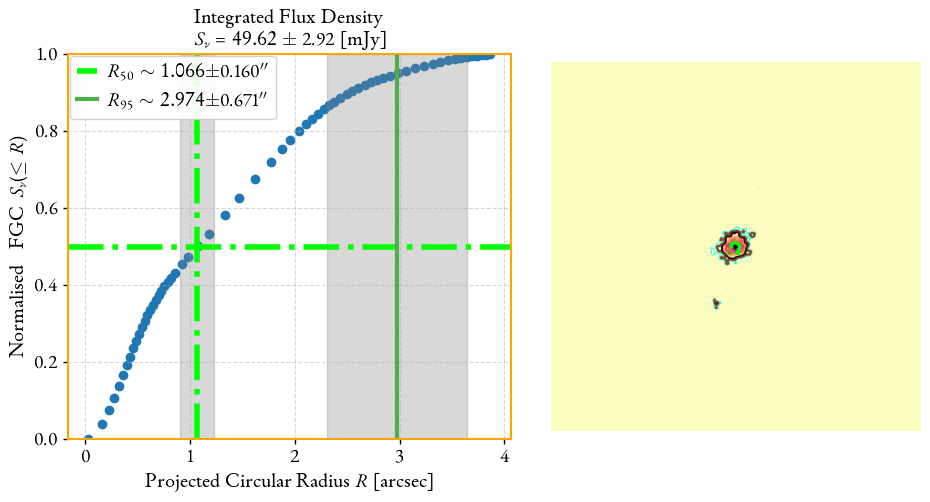

Flux density =  0.049622101906089115
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         9.9335e+00                                    6.49e+02    
       1              2         1.1141e+00      8.82e+00       4.58e+01       3.65e+01    
       2              5         2.2615e-01      8.88e-01       1.26e-01       2.59e+03    
       3              6         1.6530e-01      6.08e-02       9.58e-01       1.65e+01    
       4              7         1.0428e-01      6.10e-02       4.89e-02       1.76e+01    
       5              8         4.7779e-02      5.65e-02       1.55e-01       1.20e+01    
       6              9         2.2227e-02      2.56e-02       2.38e-01       6.56e+01    
       7             10         2.2204e-02      2.29e-05       6.93e-03       9.05e-05    
       8             11         2.2204e-02      1.47e-12       1.86e-07       2.47e-06    
       9             12         2.2204e-02      2.78e

100%|██████████| 5000/5000 [00:05<00:00, 933.19it/s]


{'A1': {'best': 56.2729143524768, 'lower_bound': 54.54879102086371, 'upper_bound': 57.99626980381109, 'lower': 1.724123331613093, 'upper': 1.7233554513342852}, 'alpha': {'best': -0.6215834691174942, 'lower_bound': -0.776618540208169, 'upper_bound': -0.46690106626365324, 'lower': 0.15503507109067483, 'upper': 0.15468240285384094}}


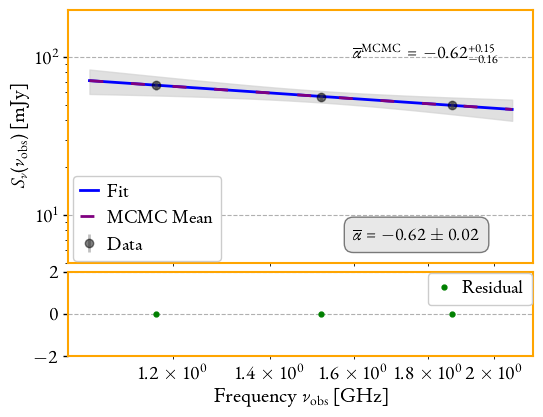

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

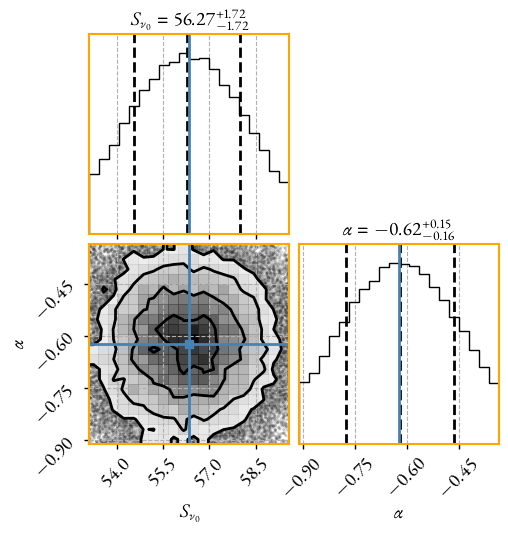

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     56.3251916 +/- 0.21667757 (0.38%) (init = 56.32519)
    alpha: -0.62432923 +/- 0.01913239 (3.06%) (init = -0.6243292)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.246
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.800 arcec            
---------------------------------------------
Imaging instrument/band VLA_A_S
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/MRK0331_A_S_sf_ps_lowres.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  0.0
Using mtmfs method.
im_nc3_cb_bs_0.80asec_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/for_s

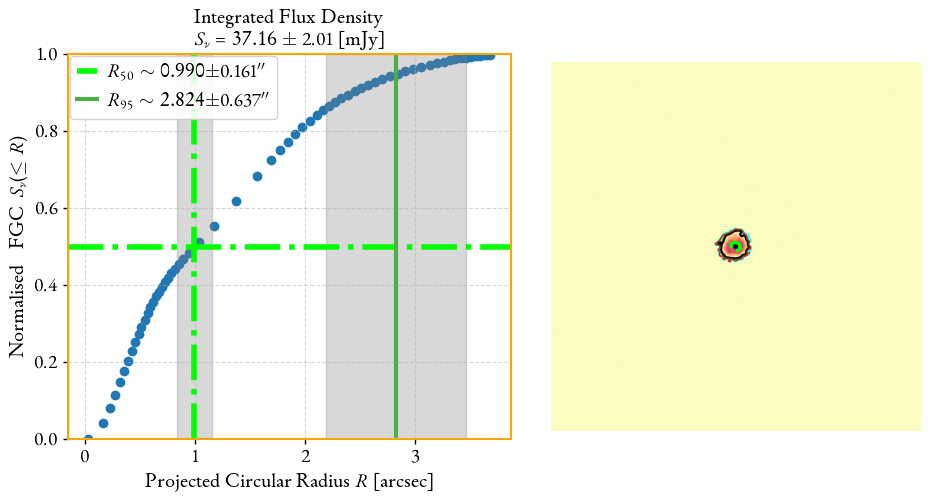

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_bs_0.80asec_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_bs_0.80asec_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_bs_0.80asec_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 38.10 +/- 1.97 mJy
Fractional error = 0.05
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 38.10 +/- 2.06 mJy
Fractional

<Figure size 500x500 with 0 Axes>

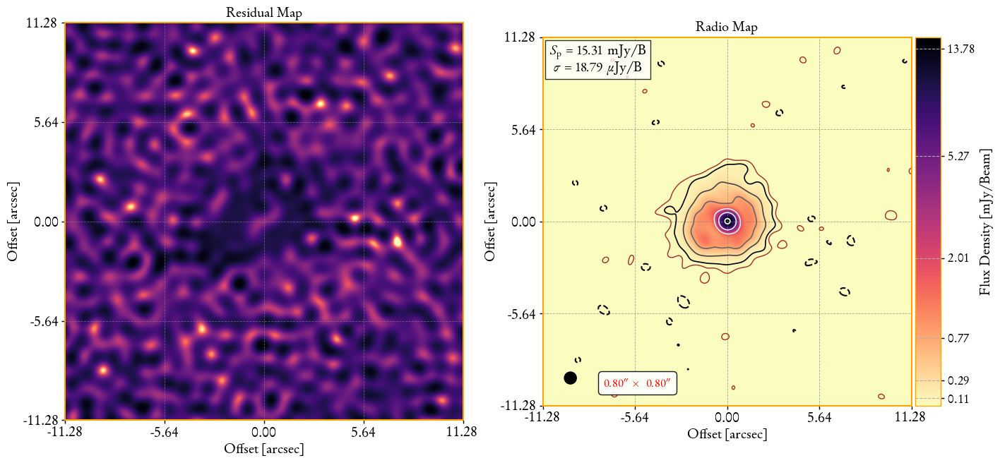

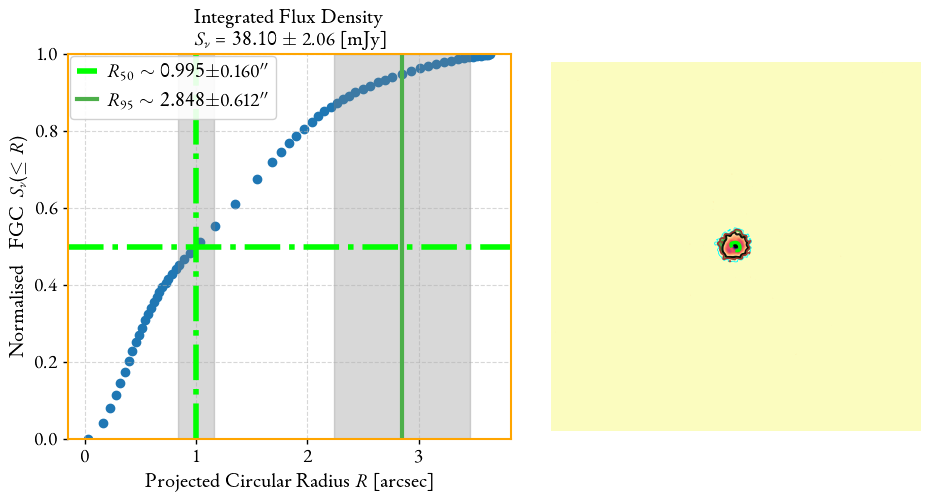

Flux density =  0.0381008570991331
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_bs_0.80asec_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_bs_0.80asec_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 43.62 +/- 3.28 mJy
Fractional error = 0.08
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 43.62 +/- 2.37 mJy
Fractional error = 0.05
Flux Density = 43.62 +/- 3.69 mJy
Fractional error 4 = 0.08
-----------------------------------------------------------------
 ==>  Peak of Flux      = 17.26 +/- 0.04 [mJy/beam]
 ==

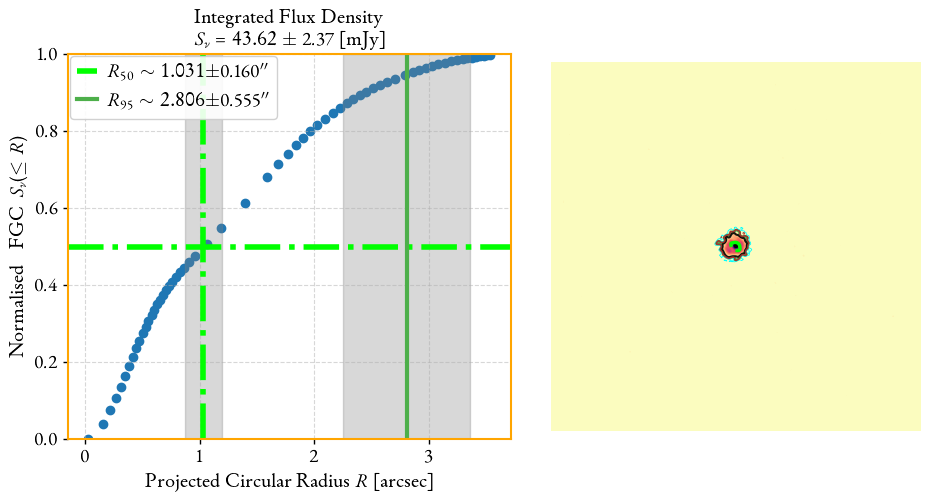

Flux density =  0.04362062779029625
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_bs_0.80asec_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_bs_0.80asec_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 32.89 +/- 1.89 mJy
Fractional error = 0.06
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 32.89 +/- 1.77 mJy
Fractional error = 0.05
Flux Density = 32.89 +/- 2.56 mJy
Fractional error 4 = 0.08
-----------------------------------------------------------------
 ==>  Peak of Flux      = 13.98 +/- 0.03 [mJy/beam]
 =

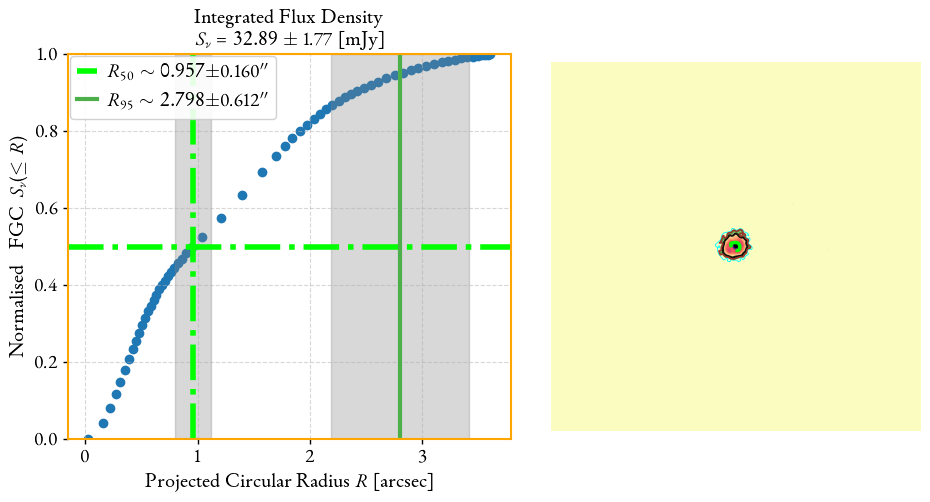

Flux density =  0.03289395492161753
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         8.4041e+00                                    1.09e+03    
       1              2         7.1984e+00      1.21e+00       4.58e+01       9.11e+00    
       2              3         7.0551e+00      1.43e-01       8.54e-01       9.40e+00    
       3              4         6.7484e+00      3.07e-01       1.69e+00       1.01e+01    
       4              5         6.0287e+00      7.20e-01       3.32e+00       1.19e+01    
       5              6         3.2065e+00      2.82e+00       6.26e+00       2.17e+01    
       6              8         1.9665e+00      1.24e+00       2.99e+00       1.18e+01    
       7              9         1.4724e+00      4.94e-01       5.56e+00       5.75e+03    
       8             11         2.8825e-01      1.18e+00       2.21e+00       5.30e+02    
       9             12         1.7612e-01      1.12e-

100%|██████████| 5000/5000 [00:06<00:00, 806.77it/s]


{'A1': {'best': 37.51164168964508, 'lower_bound': 36.33183680330364, 'upper_bound': 38.68989383541935, 'lower': 1.1798048863414436, 'upper': 1.178252145774266}, 'alpha': {'best': -0.610041726019859, 'lower_bound': -0.7748259475109099, 'upper_bound': -0.44525333365491365, 'lower': 0.164784221491051, 'upper': 0.1647883923649453}}


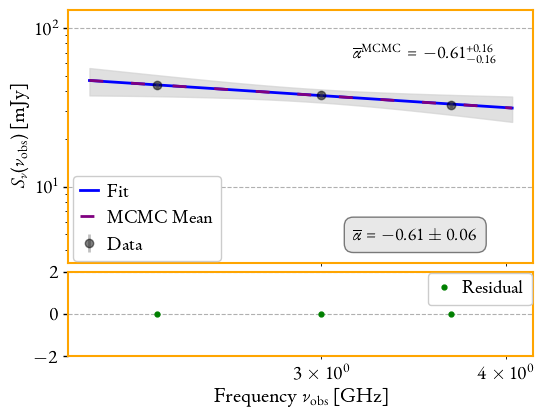

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

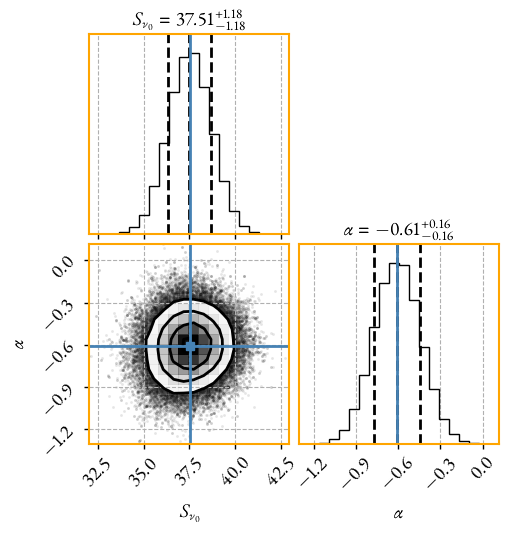

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     37.5458442 +/- 0.42043489 (1.12%) (init = 37.54584)
    alpha: -0.60742666 +/- 0.05556589 (9.15%) (init = -0.6074267)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.274
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.800 arcec            
---------------------------------------------
Imaging instrument/band VLA_A_C
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/C/Mrk331_A_C_EVLA_sfc_ps_lowres.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  0.0
Using mtmfs method.
im_nc3_cb_bs_0.80asec_Mrk331_A_C_EVLA_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_

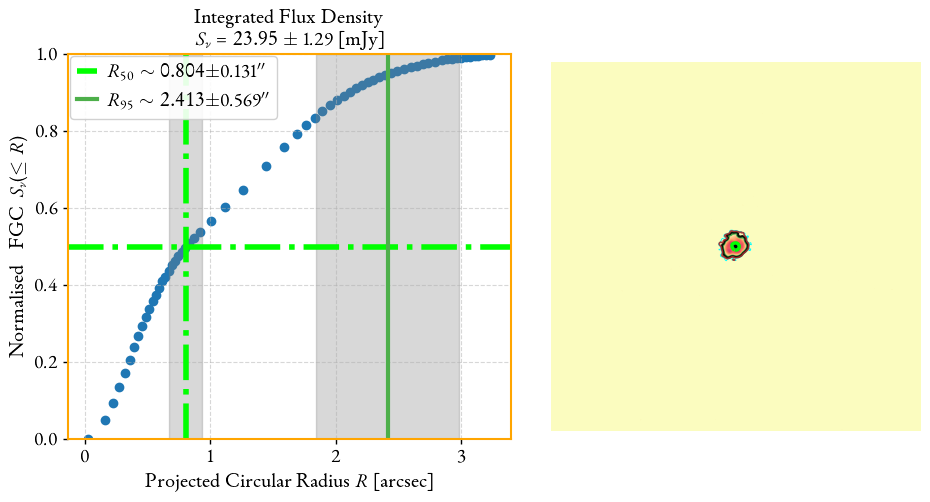

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/C/im_nc3_cb_bs_0.80asec_Mrk331_A_C_EVLA_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/C/im_nc3_cb_bs_0.80asec_Mrk331_A_C_EVLA_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/C/im_nc3_cb_bs_0.80asec_Mrk331_A_C_EVLA_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 26.76 +/- 1.27 mJy
Fractional error = 0.05
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 26.76 +/- 1.48

<Figure size 500x500 with 0 Axes>

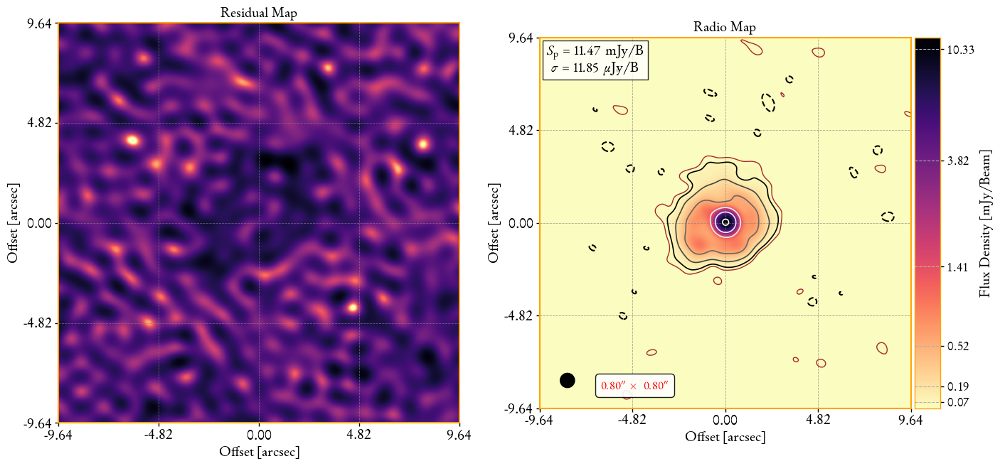

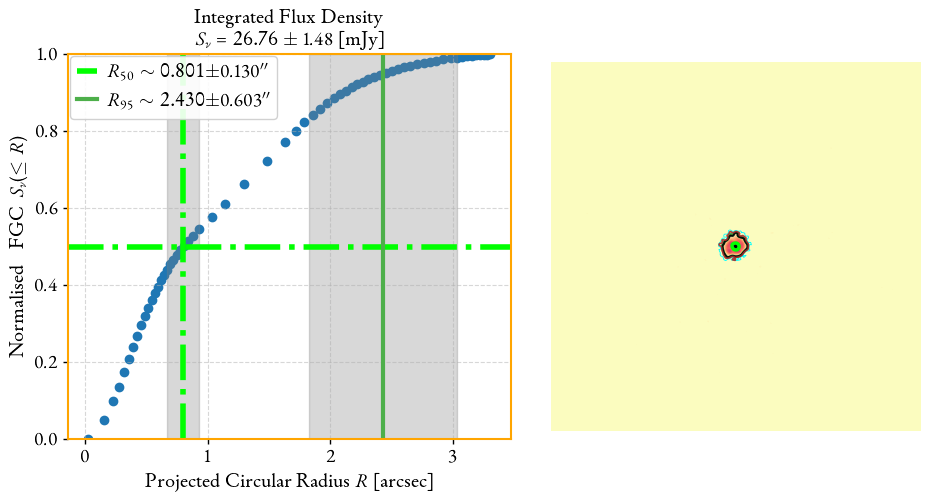

Flux density =  0.026760079764265844
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/C/im_nc3_cb_bs_0.80asec_Mrk331_A_C_EVLA_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/C/im_nc3_cb_bs_0.80asec_Mrk331_A_C_EVLA_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 23.30 +/- 1.21 mJy
Fractional error = 0.05
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 23.30 +/- 1.24 mJy
Fractional error = 0.05
Flux Density = 23.30 +/- 1.70 mJy
Fractional error 4 = 0.07
-----------------------------------------------------------------
 ==>  Peak of Flux      = 11.05 +/- 0.02 [m

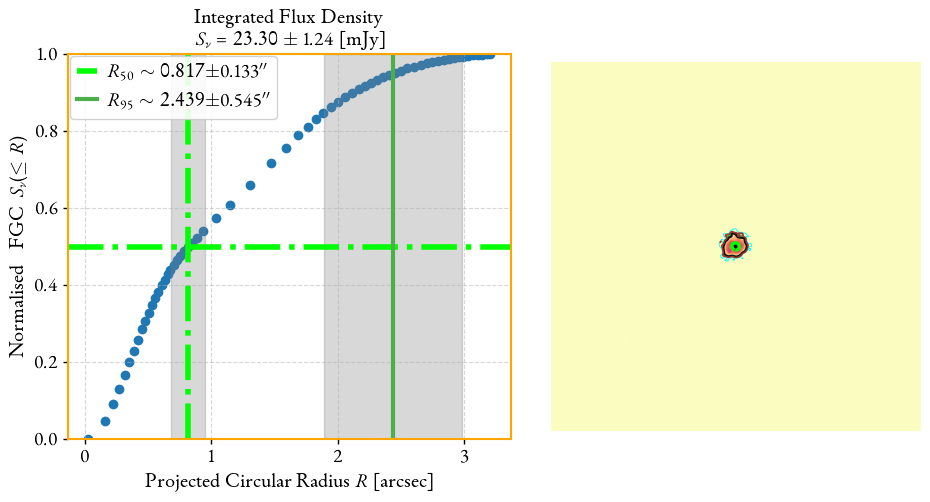

Flux density =  0.023299889535776403
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/C/im_nc3_cb_bs_0.80asec_Mrk331_A_C_EVLA_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/C/im_nc3_cb_bs_0.80asec_Mrk331_A_C_EVLA_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 19.91 +/- 1.20 mJy
Fractional error = 0.06
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 19.91 +/- 1.04 mJy
Fractional error = 0.05
Flux Density = 19.91 +/- 1.57 mJy
Fractional error 4 = 0.08
-----------------------------------------------------------------
 ==>  Peak of Flux      = 9.57 +/- 0.02 [mJ

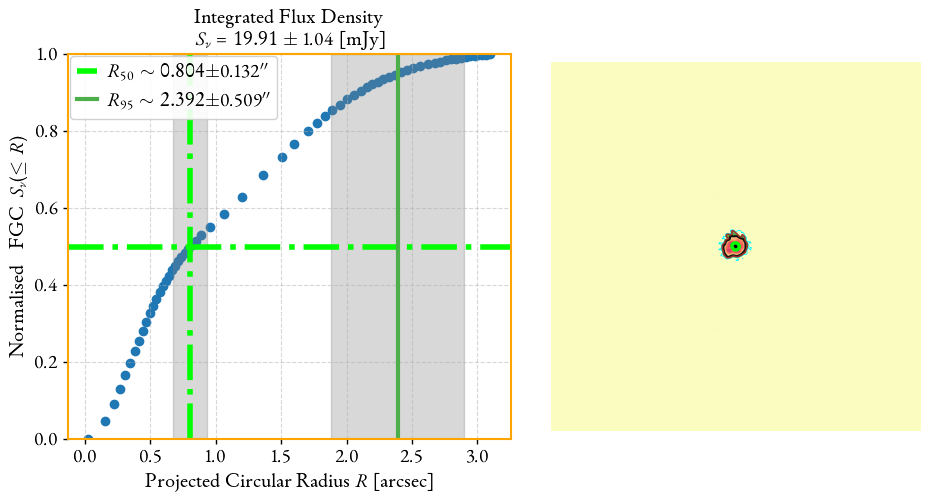

Flux density =  0.01991331692620077
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         6.1377e+00                                    2.30e+03    
       1              3         7.9161e-01      5.35e+00       1.15e+01       7.19e+03    
       2              5         4.5886e-01      3.33e-01       2.38e+00       1.71e+01    
       3              6         2.4997e-01      2.09e-01       2.51e-01       1.39e+01    
       4              7         4.9222e-02      2.01e-01       5.57e-01       2.25e+00    
       5              8         4.0210e-02      9.01e-03       1.29e-01       2.58e+01    
       6              9         4.0190e-02      2.01e-05       4.32e-03       4.87e-02    
       7             10         4.0190e-02      7.90e-10       1.06e-05       6.75e-06    
       8             11         4.0190e-02      5.29e-14       1.16e-07       1.62e-06    
       9             18         4.0190e-02      1.53e-

100%|██████████| 5000/5000 [00:06<00:00, 797.19it/s]


{'A1': {'best': 22.86937053855615, 'lower_bound': 22.165767355312028, 'upper_bound': 23.569151494542076, 'lower': 0.7036031832441232, 'upper': 0.6997809559859256}, 'alpha': {'best': -0.6405764000604295, 'lower_bound': -0.8035031056154309, 'upper_bound': -0.47835860223076493, 'lower': 0.16292670555500144, 'upper': 0.16221779782966456}}


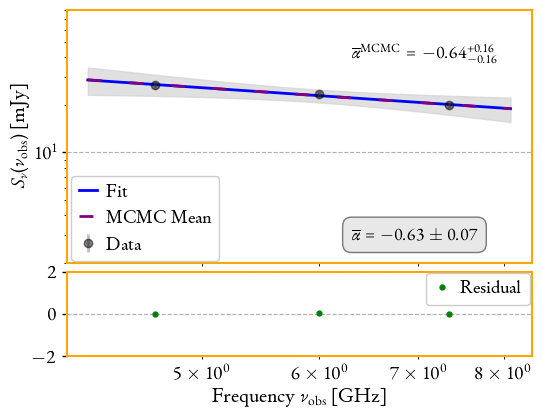

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

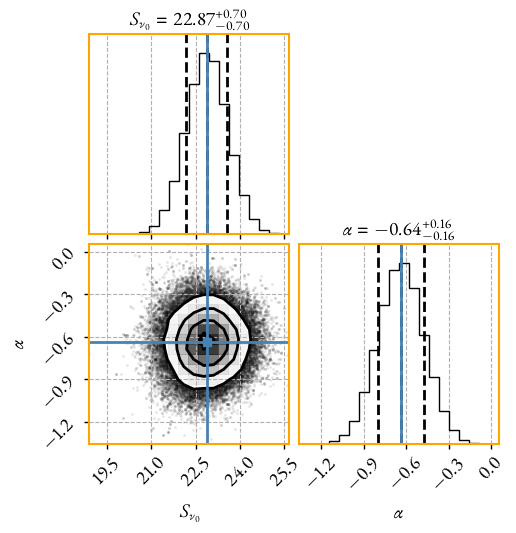

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     22.9007515 +/- 0.29631204 (1.29%) (init = 22.90075)
    alpha: -0.63455447 +/- 0.06549739 (10.32%) (init = -0.6345545)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.255
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.800 arcec            
---------------------------------------------
Imaging instrument/band VLA_A_X
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/MRK0331_A_X_sf_ps_lowres.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  0.0
Using mtmfs method.
im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/for_

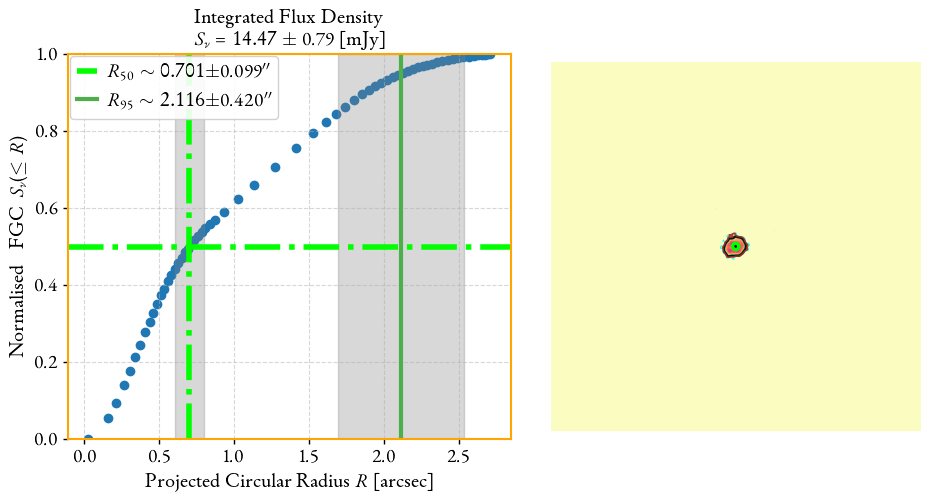

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 16.22 +/- 0.91 mJy
Fractional error = 0.06
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 16.22 +/- 0.92 mJy
Fractional

<Figure size 500x500 with 0 Axes>

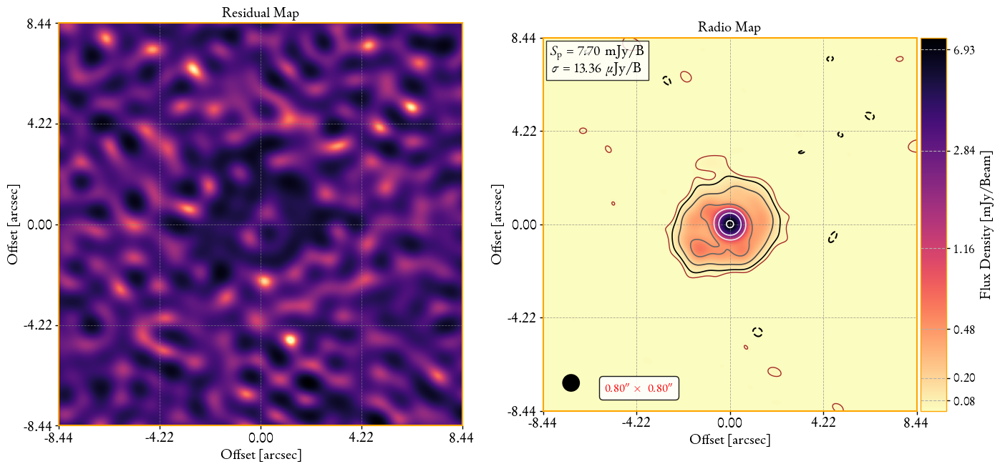

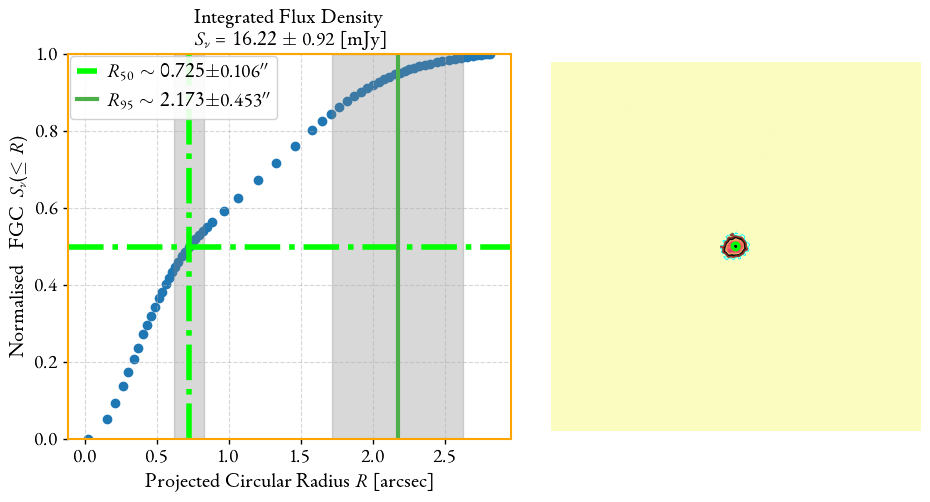

Flux density =  0.016217130337000847
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 13.62 +/- 1.07 mJy
Fractional error = 0.08
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 13.62 +/- 0.73 mJy
Fractional error = 0.05
Flux Density = 13.62 +/- 1.16 mJy
Fractional error 4 = 0.09
-----------------------------------------------------------------
 ==>  Peak of Flux      = 7.44 +/- 0.02 [mJy/beam]
 =

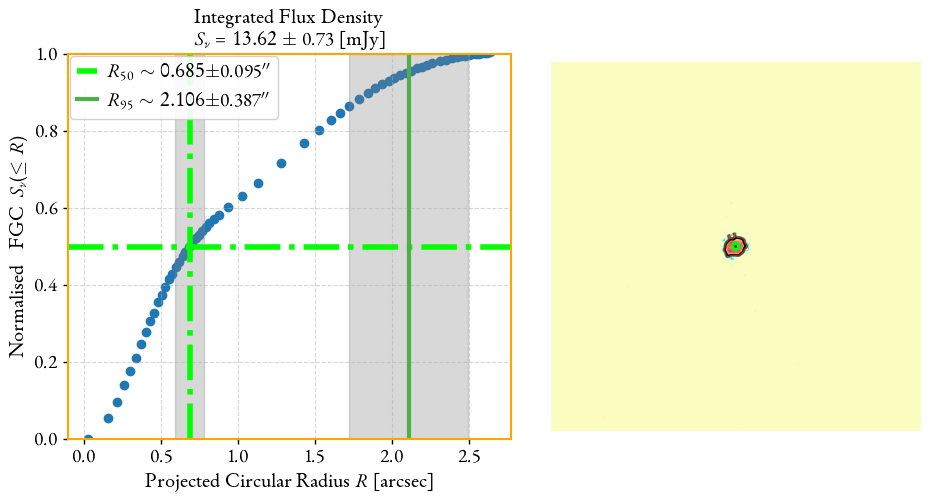

Flux density =  0.013622893561888711
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 12.67 +/- 0.99 mJy
Fractional error = 0.08
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 12.67 +/- 0.67 mJy
Fractional error = 0.05
Flux Density = 12.67 +/- 1.27 mJy
Fractional error 4 = 0.10
-----------------------------------------------------------------
 ==>  Peak of Flux      = 6.88 +/- 0.03 [mJy/beam]
 =

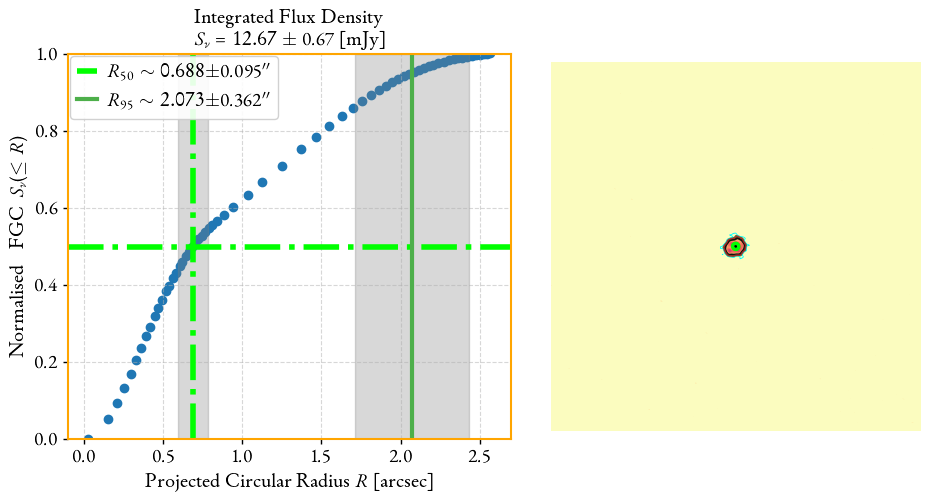

Flux density =  0.012671535285959722
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         2.8186e+00                                    6.31e+03    
       1              4         5.9726e-01      2.22e+00       2.86e+00       7.78e+03    
       2              6         8.7956e-02      5.09e-01       1.43e+00       3.25e+00    
       3              7         7.5028e-02      1.29e-02       4.85e-02       2.70e+00    
       4              8         5.5430e-02      1.96e-02       9.25e-02       1.64e+00    
       5              9         3.9472e-02      1.60e-02       1.59e-01       6.24e-02    
       6             10         3.9368e-02      1.04e-04       1.10e-02       1.20e-03    
       7             11         3.9368e-02      3.54e-08       1.93e-04       1.76e-05    
       8             12         3.9368e-02      6.97e-12       2.53e-06       7.07e-07    
       9             13         3.9368e-02      1.03e

100%|██████████| 5000/5000 [00:06<00:00, 799.68it/s]


{'A1': {'best': 13.978009544637516, 'lower_bound': 13.540027186365593, 'upper_bound': 14.425378231129281, 'lower': 0.4379823582719222, 'upper': 0.44736868649176564}, 'alpha': {'best': -0.9018862401746115, 'lower_bound': -1.1895867293029554, 'upper_bound': -0.6131240031927904, 'lower': 0.2877004891283439, 'upper': 0.28876223698182113}}


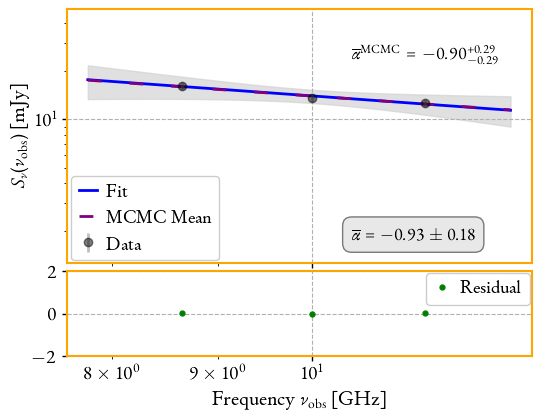

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

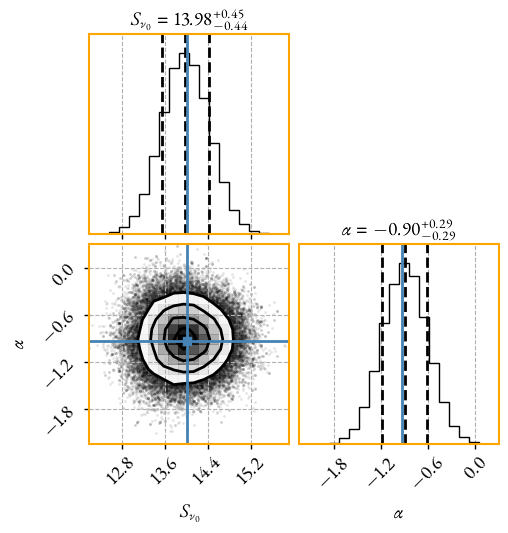

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     14.0152542 +/- 0.29454722 (2.10%) (init = 14.01525)
    alpha: -0.93142017 +/- 0.18370621 (19.72%) (init = -0.9314202)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.193
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.800 arcec            
---------------------------------------------
Imaging instrument/band VLA_C_Ku
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ku/Mrk331_C_Ku_sfc_ps_lowres.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  0.0
Using mtmfs method.
im_nc3_cb_bs_0.80asec_Mrk331_C_Ku_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/

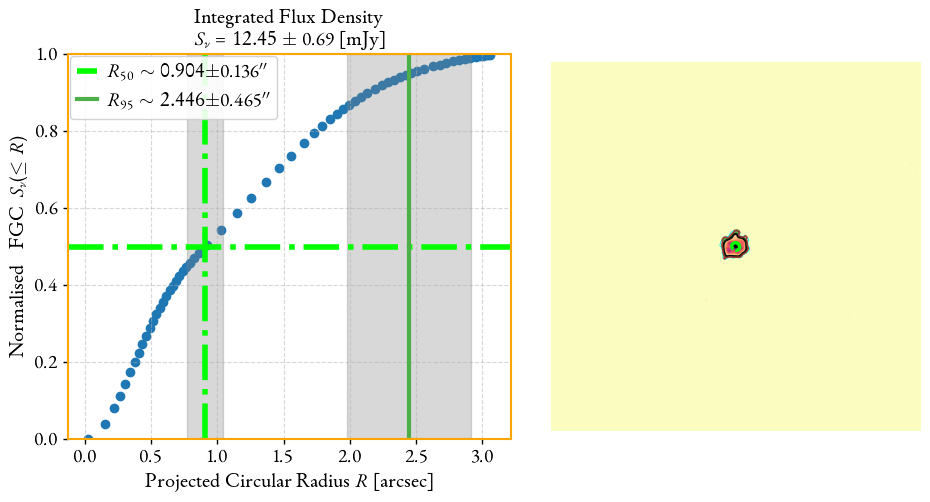

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ku/im_nc3_cb_bs_0.80asec_Mrk331_C_Ku_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ku/im_nc3_cb_bs_0.80asec_Mrk331_C_Ku_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ku/im_nc3_cb_bs_0.80asec_Mrk331_C_Ku_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 13.48 +/- 1.31 mJy
Fractional error = 0.10
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 13.48 +/- 0.79 mJy
Frac

<Figure size 500x500 with 0 Axes>

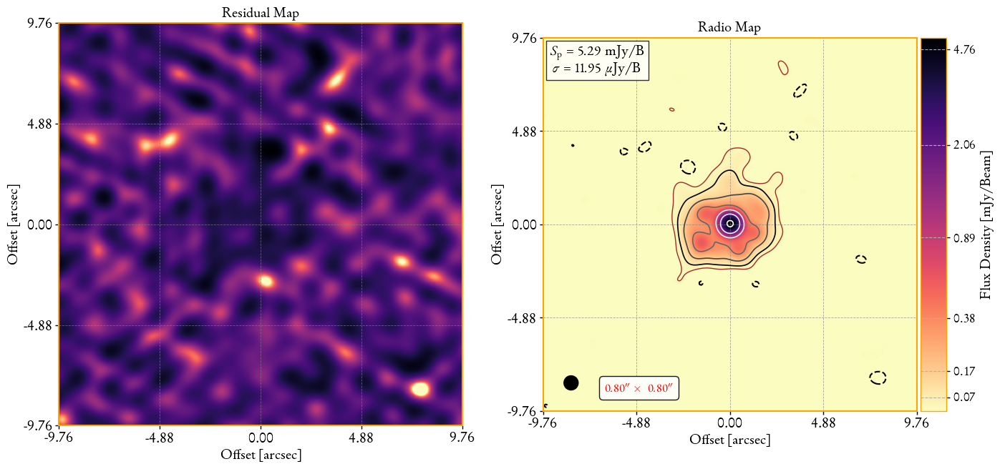

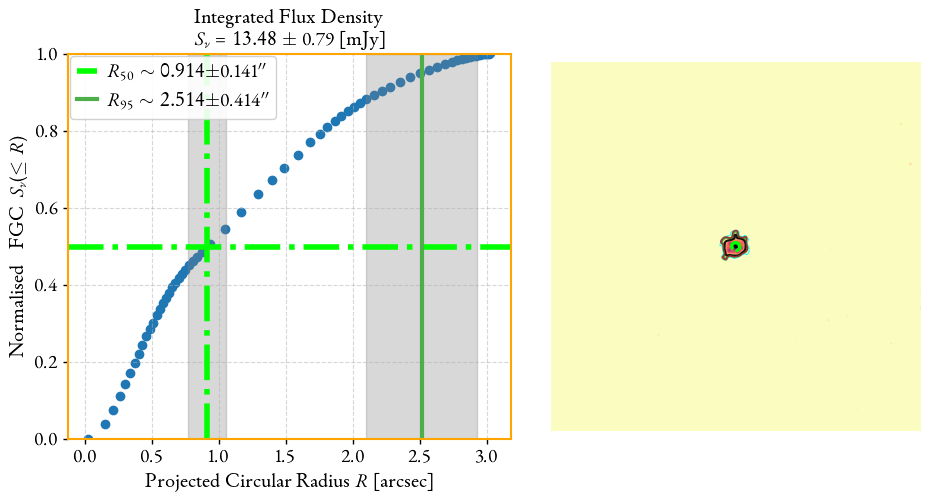

Flux density =  0.013476194671567457
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ku/im_nc3_cb_bs_0.80asec_Mrk331_C_Ku_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ku/im_nc3_cb_bs_0.80asec_Mrk331_C_Ku_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 12.46 +/- 0.85 mJy
Fractional error = 0.07
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 12.46 +/- 0.66 mJy
Fractional error = 0.05
Flux Density = 12.46 +/- 1.11 mJy
Fractional error 4 = 0.09
-----------------------------------------------------------------
 ==>  Peak of Flux      = 5.29 +/- 0.02 [mJy/beam

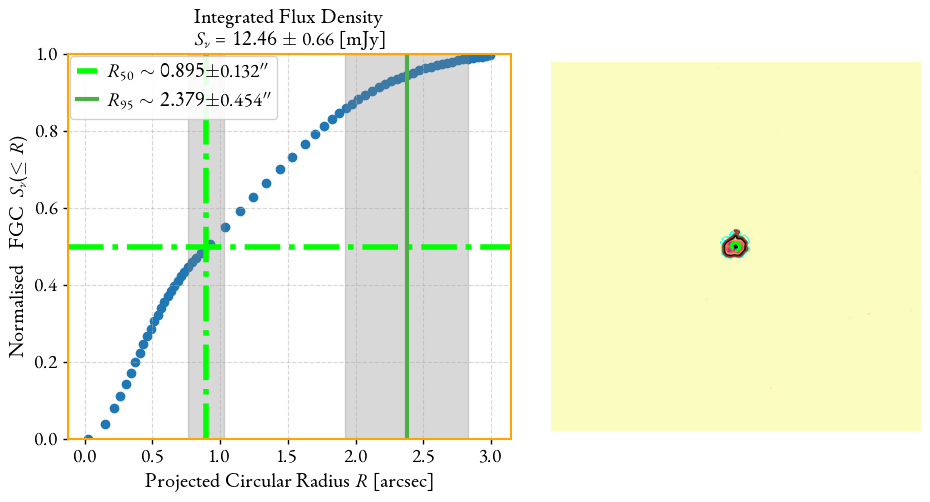

Flux density =  0.012457290560625979
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ku/im_nc3_cb_bs_0.80asec_Mrk331_C_Ku_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ku/im_nc3_cb_bs_0.80asec_Mrk331_C_Ku_sfc_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 11.49 +/- 0.94 mJy
Fractional error = 0.08
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 11.49 +/- 0.66 mJy
Fractional error = 0.06
Flux Density = 11.49 +/- 1.19 mJy
Fractional error 4 = 0.10
-----------------------------------------------------------------
 ==>  Peak of Flux      = 4.84 +/- 0.02 [mJy/beam

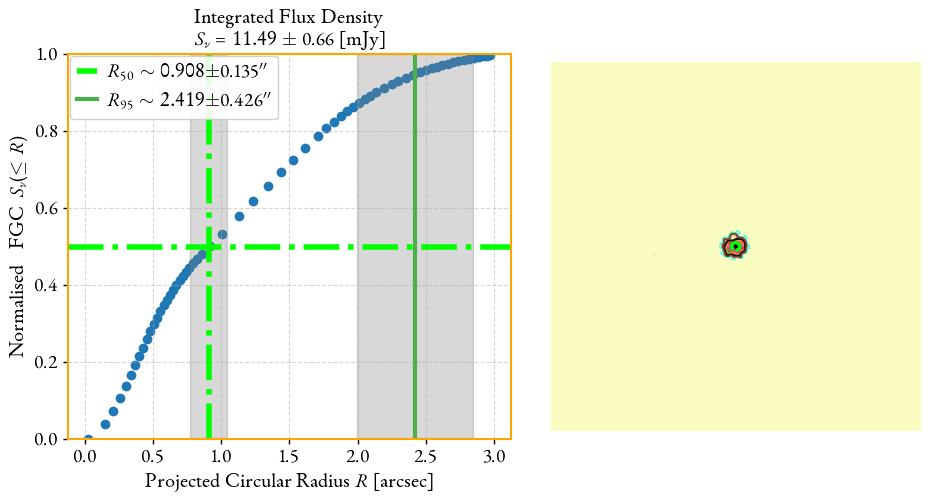

Flux density =  0.011489554256088119
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         1.6093e+00                                    8.32e+03    
       1              4         1.6141e-01      1.45e+00       2.86e+00       5.72e+00    
       2              5         1.1202e-01      4.94e-02       9.33e-02       4.84e+00    
       3              6         3.7925e-02      7.41e-02       1.82e-01       2.85e+00    
       4              7         7.5924e-04      3.72e-02       2.50e-01       1.65e+02    
       5              8         4.8906e-04      2.70e-04       1.83e-02       2.45e-04    
       6              9         4.8906e-04      2.64e-10       2.27e-05       9.35e-07    
       7             10         4.8906e-04      3.15e-16       1.53e-08       6.18e-07    
       8             14         4.8906e-04      4.77e-18       7.30e-11       2.32e-08    
       9             15         4.8906e-04      1.49e

100%|██████████| 5000/5000 [00:05<00:00, 960.31it/s]


{'A1': {'best': 12.394690154019653, 'lower_bound': 12.117977079028583, 'upper_bound': 12.6808401935, 'lower': 0.27671307499107023, 'upper': 0.2861500394803471}, 'alpha': {'best': -0.5812037691274019, 'lower_bound': -0.7851307841445817, 'upper_bound': -0.378270749969754, 'lower': 0.2039270150171798, 'upper': 0.2029330191576479}}


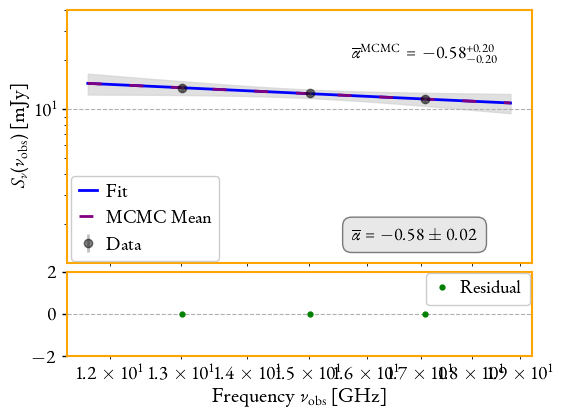

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

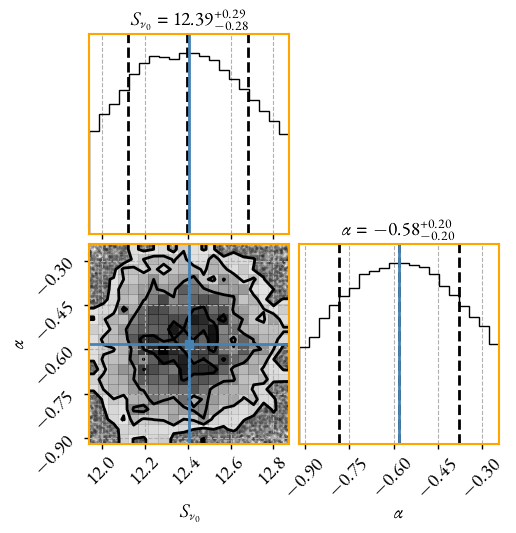

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     12.4040398 +/- 0.03122283 (0.25%) (init = 12.40404)
    alpha: -0.58334353 +/- 0.02256703 (3.87%) (init = -0.5833435)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.139
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.800 arcec            
---------------------------------------------
Imaging instrument/band VLA_C_Ka
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/Mrk331_C_Ka_2x_sf_ps_lowres.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  0.0
Using mtmfs method.
im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_do

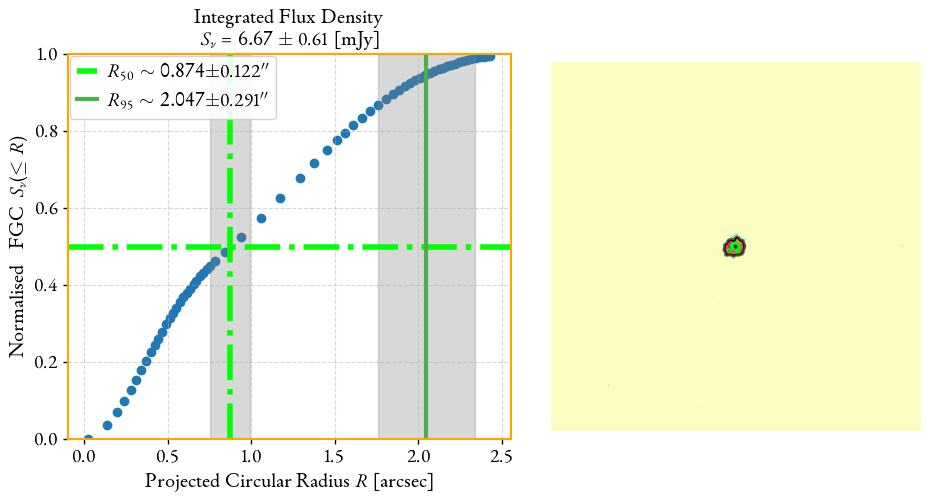

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 6.70 +/- 1.01 mJy
Fractional error = 0.15
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 6.70 +/- 0.62 mJy


<Figure size 500x500 with 0 Axes>

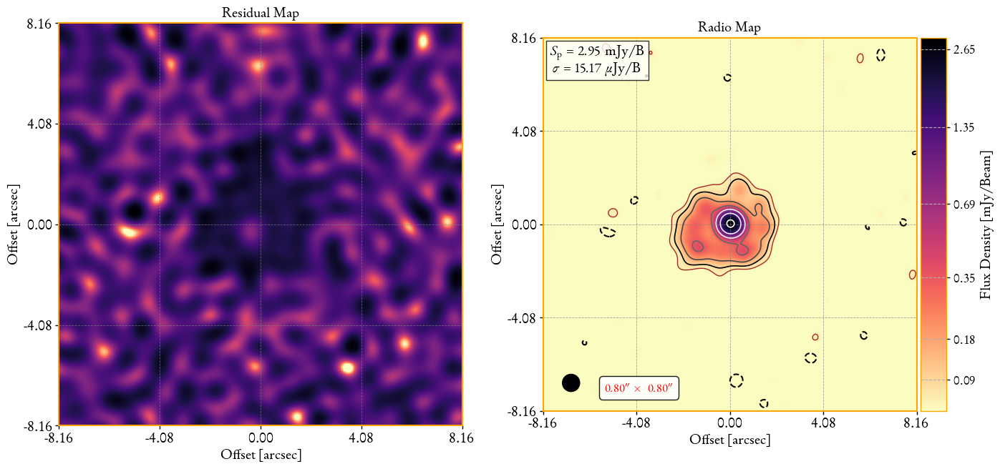

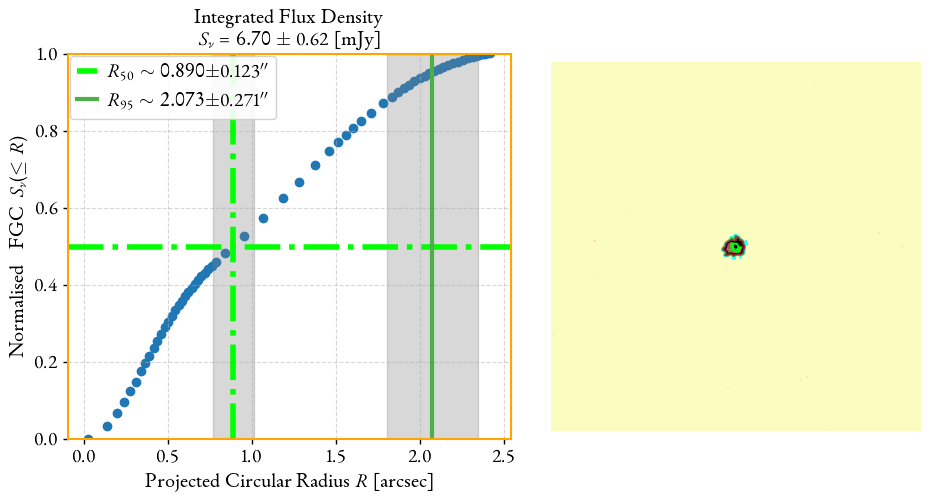

Flux density =  0.006699670157230975
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 7.11 +/- 0.89 mJy
Fractional error = 0.13
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 7.11 +/- 0.64 mJy
Fractional error = 0.09
Flux Density = 7.11 +/- 1.03 mJy
Fractional error 4 = 0.15
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 3.14 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask) = 7.11 +/- 0.89 [mJy]
 ==>  Snu (image)       = 7.32 +/- 0.89 [mJy]
 ==>  R50               = 0.8786 +/- 0.1212 [arcsec]
 ==>  R95               = 2.0560 +/- 0.2933 [arcsec]


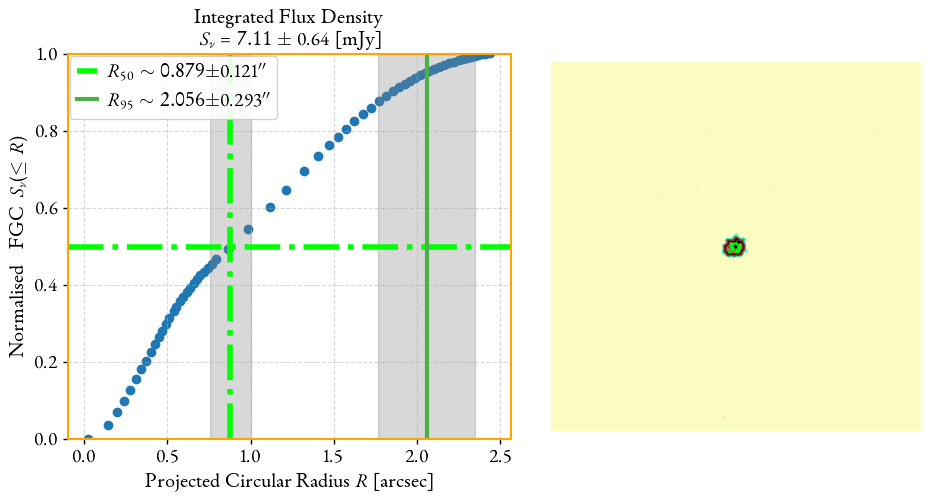

Flux density =  0.007112787789277261
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r0.0-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 6.03 +/- 1.00 mJy
Fractional error = 0.17
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 6.03 +/- 0.55 mJy
Fractional error = 0.09
Flux Density = 6.03 +/- 1.11 mJy
Fractional error 4 = 0.18
-----------------------------------------------------------------
 ==>  Peak of Flux      = 2.68 +/- 0.03 [mJy/bea

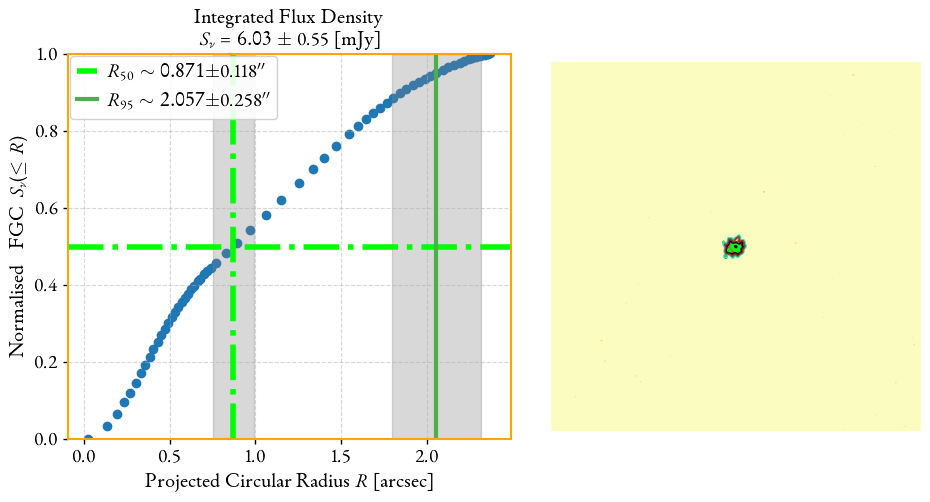

Flux density =  0.006033868822730194
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         2.4518e+00                                    7.16e+00    
       1              3         3.7601e-01      2.08e+00       2.52e+00       5.56e+00    
       2              4         1.1629e-01      2.60e-01       1.55e+00       4.19e+03    
       3              5         1.1949e-02      1.04e-01       8.62e-01       6.66e-01    
       4              6         3.6229e-03      8.33e-03       2.15e-01       4.13e+00    
       5              7         3.6206e-03      2.31e-06       4.77e-03       3.32e-05    
       6              8         3.6206e-03      1.10e-10       3.35e-05       1.65e-07    
       7              9         3.6206e-03      7.62e-15       2.80e-07       8.64e-09    
       8             10         3.6206e-03      3.47e-18       8.61e-09       3.75e-06    
`ftol` termination condition is satisfied.
Function e

100%|██████████| 5000/5000 [00:06<00:00, 818.92it/s]


{'A1': {'best': 6.559760047590009, 'lower_bound': 6.207954421429505, 'upper_bound': 6.904706113176727, 'lower': 0.3518056261605045, 'upper': 0.3449460655867176}, 'alpha': {'best': -1.019103040356089, 'lower_bound': -1.8210002103555138, 'upper_bound': -0.2249777954414665, 'lower': 0.8018971699994248, 'upper': 0.7941252449146226}}


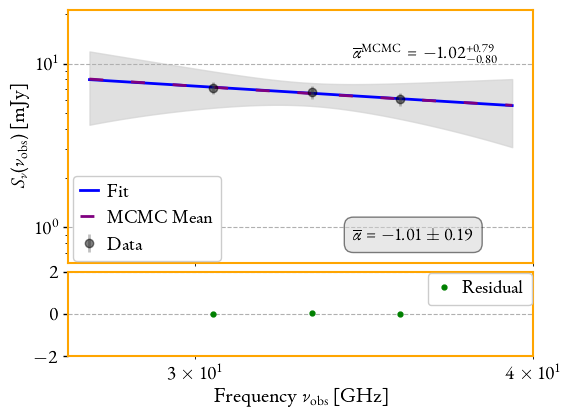

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

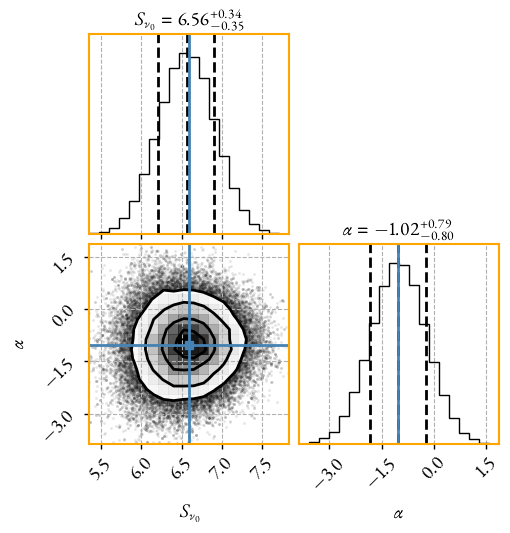

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     6.58581523 +/- 0.08322567 (1.26%) (init = 6.585815)
    alpha: -1.01480620 +/- 0.19170314 (18.89%) (init = -1.014806)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.126
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.800 arcec            
---------------------------------------------


In [12]:
robust = [0.0]
for vis_name in list(vis_list_uv_match.keys()):
    print(f"Imaging instrument/band {vis_name}")
    print(f"    > Visibility: {vis_list_uv_match[vis_name]}")
    for ROBUST in robust:
        image_list,image_statistics,Omaj = \
            mlibs.run_wsclean(vis_list_uv_match[vis_name], robust=ROBUST,
                        imsize=imsizex, 
                        imsizey=imsizey, 
                        opt_args= opt_args,
                        cell=cell,
                        base_name=prefix,
                        nsigma_automask=nsigma_automask,
                        nsigma_autothreshold=nsigma_autothreshold,
                        quiet=True,
                        nc=n_subimages,
                        with_multiscale=True,
                        # scales='0,40,120,240',
                        scales='None',
                        datacolumn='DATA',
                        uvtaper=uvtaper,
                        niter=100000)


## $\text{More weight for shorter baselines for X and Ka band data.}$

Imaging instrument/band VLA_A_X
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/MRK0331_A_X_sf_ps_lowres.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  1.0
Using mtmfs method.
im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r1.0
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/:/mnt /media/sagauga/xfs_evo/wsclean3.4-idg-everybeam-eMERLIN_portable.sif wsclean -name /mnt/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r1.0 -size 2048 2048 -scale 0.04asec  -mgain 0.5 -gain 0.1 -nmiter 500  -niter 100000 -weight briggs 1.0  -auto-mask 4.0  -auto-threshold 1.5  -multiscale  -multiscale-scale-bias 0.7 -multiscale-gain 0.1  -multiscale-max-scales 6   -deconvolution-threads 24 -j 24 -parallel-reor

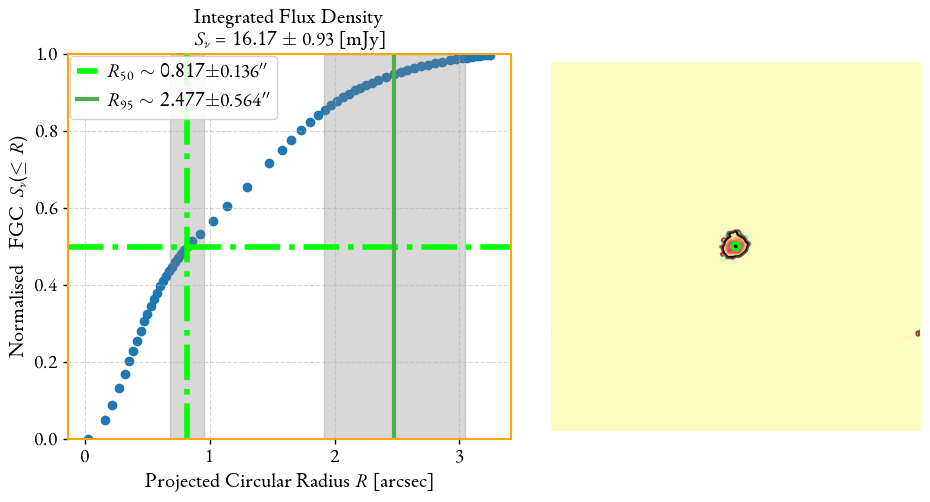

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r1.0-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r1.0-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r1.0-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 18.13 +/- 1.28 mJy
Fractional error = 0.07
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 18.13 +/- 1.13 mJy
Fractional

/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 8.37 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask) = 18.13 +/- 1.28 [mJy]
 ==>  Snu (image)       = 16.38 +/- 1.28 [mJy]
 ==>  R50               = 0.8527 +/- 0.1426 [arcsec]
 ==>  R95               = 2.5960 +/- 0.5649 [arcsec]


<Figure size 500x500 with 0 Axes>

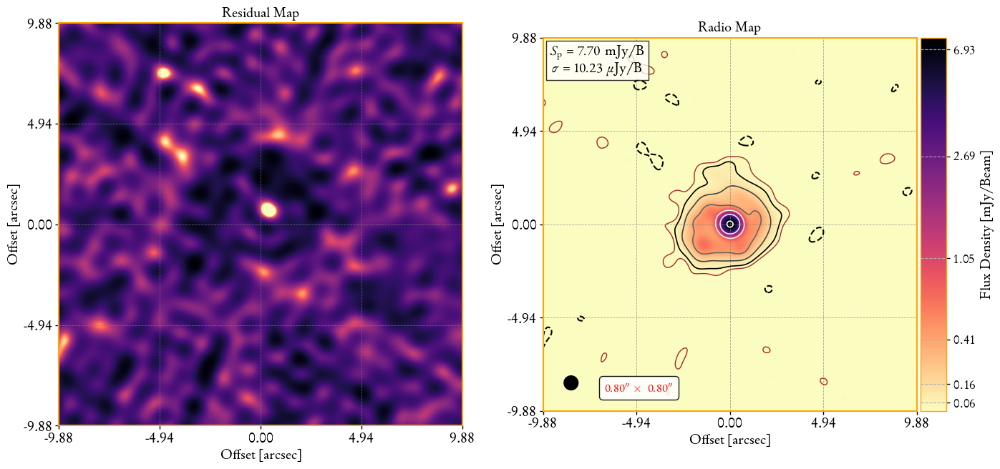

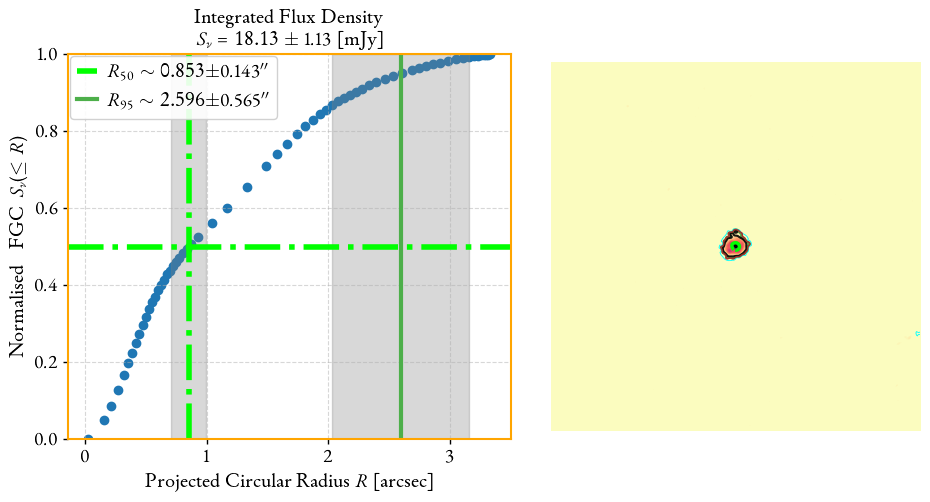

Flux density =  0.018125126631709888
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r1.0-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r1.0-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 15.35 +/- 1.09 mJy
Fractional error = 0.07
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 15.35 +/- 0.84 mJy
Fractional error = 0.05
Flux Density = 15.35 +/- 1.24 mJy
Fractional error 4 = 0.08
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 7.45 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask) = 15.35 +/- 1.09 [mJy]
 ==>  Snu (image)       = 15.46 +/- 1.09 [mJy]
 ==>  R50               = 0.7990 +/- 0.1328 [arcsec]
 ==>  R95               = 2.4365 +/- 0.5063 [arcsec]


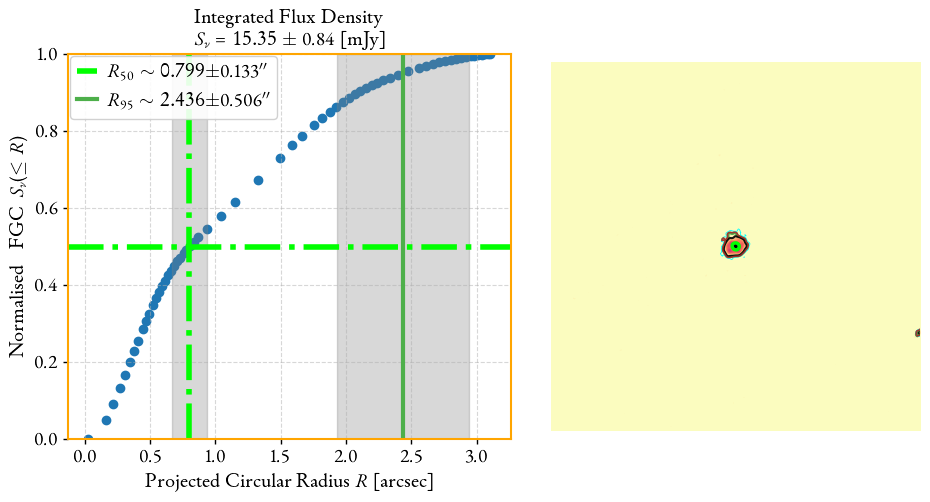

Flux density =  0.015346139472051412
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r1.0-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r1.0-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 14.04 +/- 1.06 mJy
Fractional error = 0.08
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 14.04 +/- 0.76 mJy
Fractional error = 0.05
Flux Density = 14.04 +/- 1.30 mJy
Fractional error 4 = 0.09
-----------------------------------------------------------------
 ==>  Peak of Flux      = 6.89 +/- 0.02 [mJy/beam]
 =

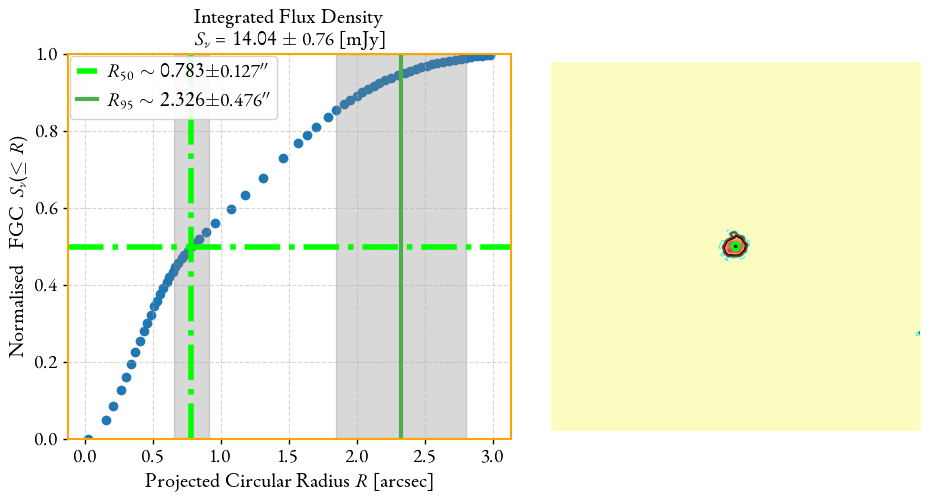

Flux density =  0.01403569611976397
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         3.7104e+00                                    4.85e+03    
       1              4         1.9476e+00      1.76e+00       2.86e+00       7.73e+03    
       2              6         7.5961e-01      1.19e+00       1.43e+00       8.21e+03    
       3              8         2.5154e-01      5.08e-01       7.16e-01       5.41e+03    
       4              9         6.5680e-02      1.86e-01       8.48e-01       2.58e+00    
       5             10         4.3716e-02      2.20e-02       8.46e-02       1.60e+00    
       6             11         2.4633e-02      1.91e-02       1.48e-01       9.71e-02    
       7             12         2.4427e-02      2.06e-04       1.43e-02       1.54e-03    
       8             13         2.4427e-02      4.89e-08       2.13e-04       1.60e-05    
       9             14         2.4427e-02      4.76e-

100%|██████████| 5000/5000 [00:06<00:00, 798.64it/s]


{'A1': {'best': 15.628117076329136, 'lower_bound': 15.114885204771682, 'upper_bound': 16.138955425367158, 'lower': 0.5132318715574549, 'upper': 0.5108383490380213}, 'alpha': {'best': -0.9388561421607301, 'lower_bound': -1.2479624500651139, 'upper_bound': -0.6237101254530706, 'lower': 0.30910630790438376, 'upper': 0.3151460167076595}}


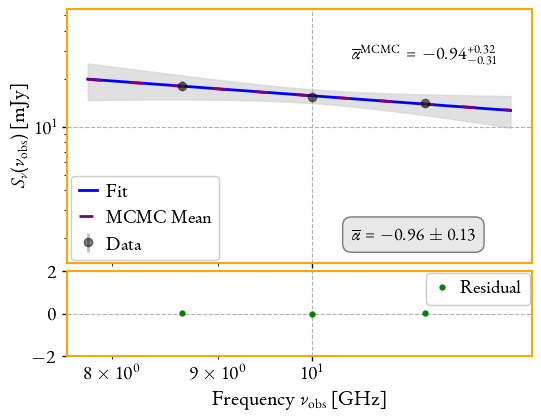

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

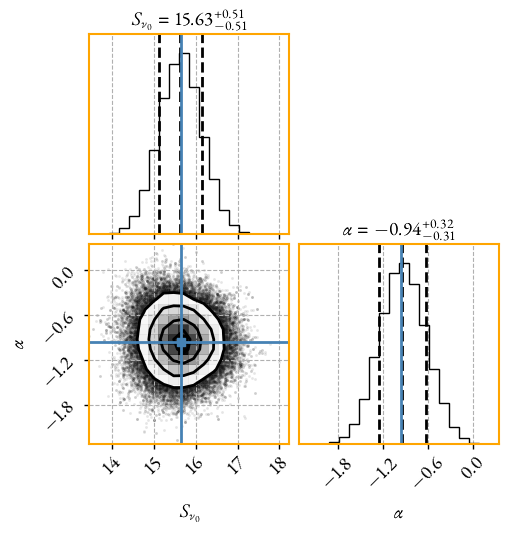

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     15.6515614 +/- 0.22861556 (1.46%) (init = 15.65156)
    alpha: -0.95673292 +/- 0.12930606 (13.52%) (init = -0.9567329)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.173
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.800 arcec            
---------------------------------------------
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  2.0
Using mtmfs method.
im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r2.0
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/:/mnt /media/sagauga/xfs_evo/wsclean3.4-idg-everybeam-eMERLIN_portable.sif wsclean -name /mnt/im_nc3_cb_bs_0.80asec_MRK0331_

/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


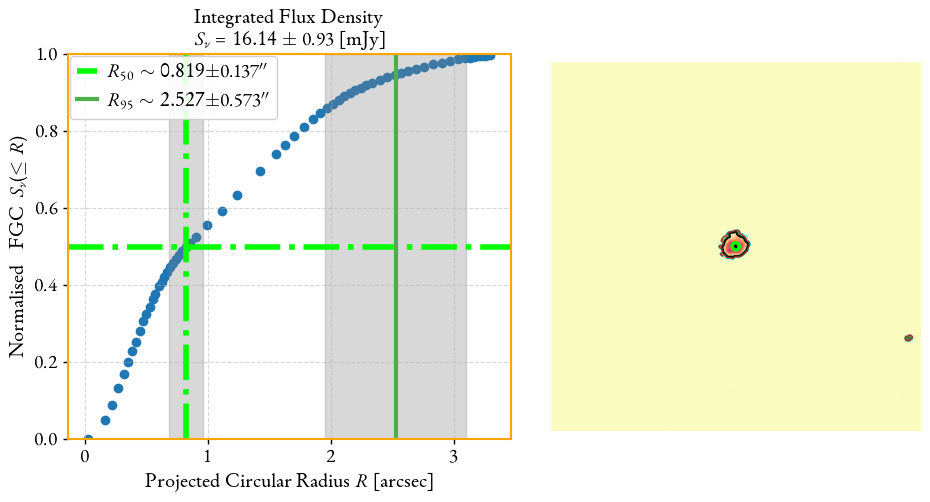

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r2.0-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r2.0-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r2.0-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 14.31 +/- 1.11 mJy
Fractional error = 0.08
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 14.31 +/- 0.82 mJy
Fractional

/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 6.90 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask) = 14.31 +/- 1.11 [mJy]
 ==>  Snu (image)       = 14.65 +/- 1.11 [mJy]
 ==>  R50               = 0.8043 +/- 0.1318 [arcsec]
 ==>  R95               = 2.3707 +/- 0.4847 [arcsec]


<Figure size 500x500 with 0 Axes>

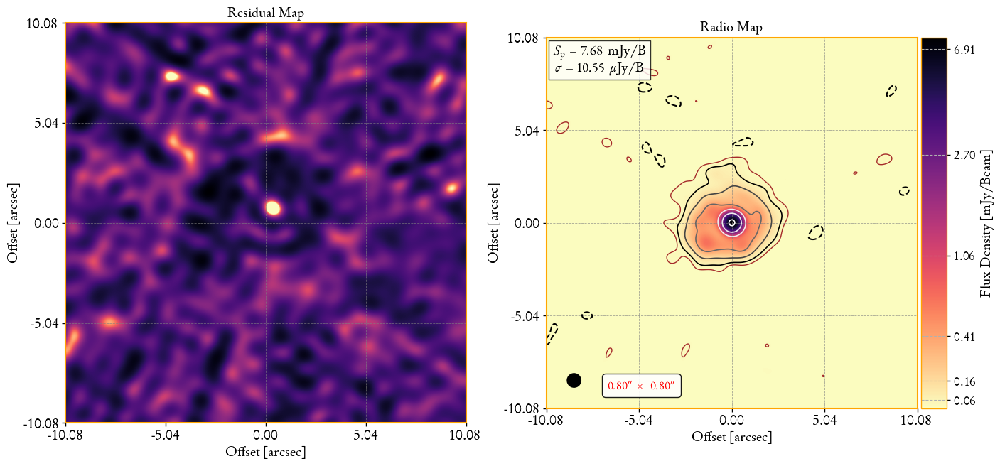

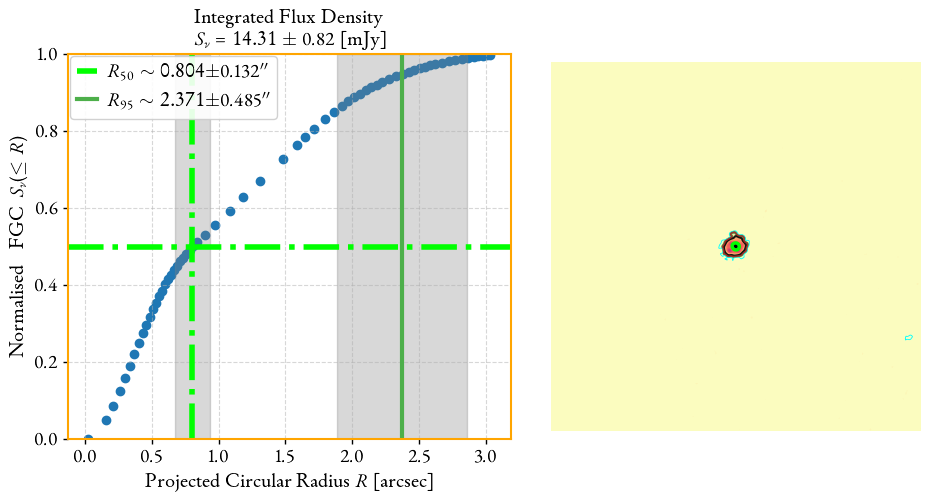

Flux density =  0.014312090903854425
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r2.0-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r2.0-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 17.99 +/- 1.36 mJy
Fractional error = 0.08
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 17.99 +/- 1.14 mJy
Fractional error = 0.06
Flux Density = 17.99 +/- 1.51 mJy
Fractional error 4 = 0.08
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 8.33 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask) = 17.99 +/- 1.36 [mJy]
 ==>  Snu (image)       = 15.76 +/- 1.36 [mJy]
 ==>  R50               = 0.8531 +/- 0.1452 [arcsec]
 ==>  R95               = 2.7002 +/- 0.5717 [arcsec]


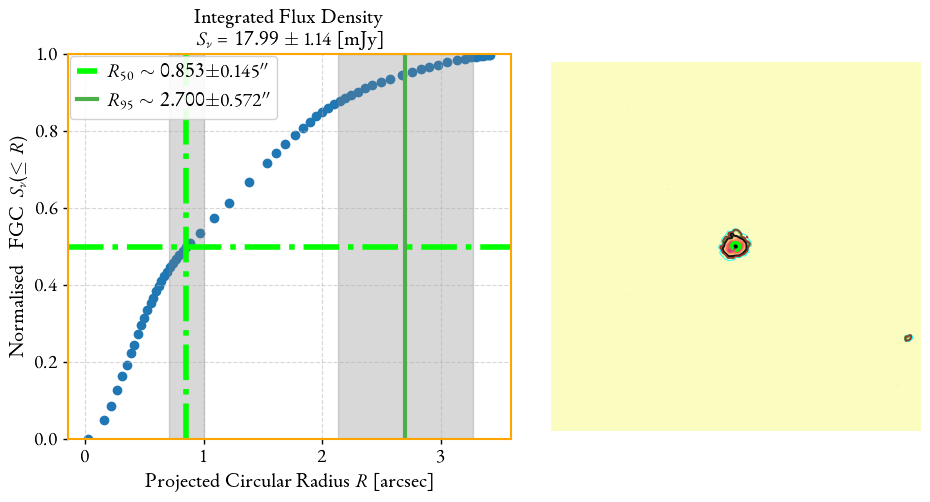

Flux density =  0.017994477374671025
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r2.0-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/X/im_nc3_cb_bs_0.80asec_MRK0331_A_X_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r2.0-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 15.24 +/- 1.02 mJy
Fractional error = 0.07
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 15.24 +/- 0.81 mJy
Fractional error = 0.05
Flux Density = 15.24 +/- 1.24 mJy
Fractional error 4 = 0.08
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 7.43 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask) = 15.24 +/- 1.02 [mJy]
 ==>  Snu (image)       = 16.19 +/- 1.02 [mJy]
 ==>  R50               = 0.7934 +/- 0.1319 [arcsec]
 ==>  R95               = 2.4296 +/- 0.5311 [arcsec]


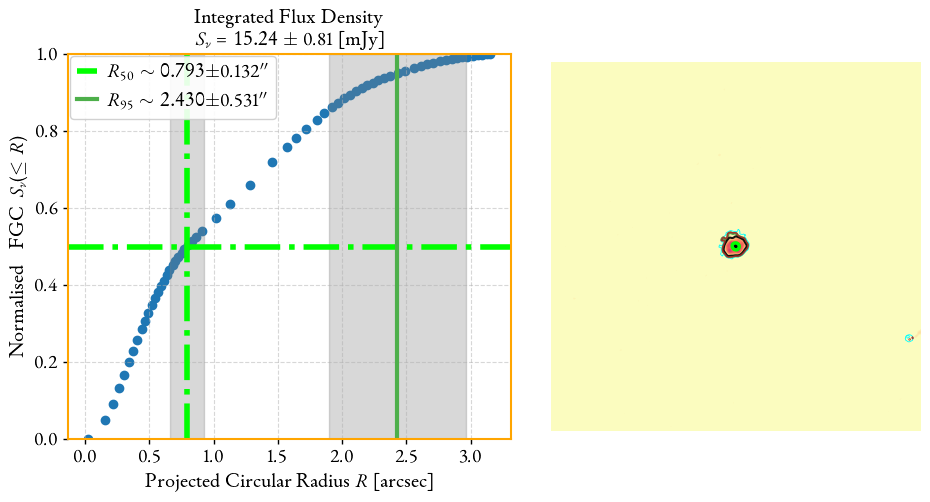

Flux density =  0.015237442319832338
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         3.6871e+00                                    4.82e+03    
       1              4         1.9363e+00      1.75e+00       2.86e+00       7.67e+03    
       2              6         7.5946e-01      1.18e+00       1.43e+00       8.12e+03    
       3              8         2.5529e-01      5.04e-01       7.16e-01       5.41e+03    
       4              9         7.0856e-02      1.84e-01       8.79e-01       2.72e+00    
       5             10         5.6237e-02      1.46e-02       1.10e-01       1.24e+00    
       6             11         5.1663e-02      4.57e-03       9.91e-02       1.20e-02    
       7             12         5.1660e-02      2.80e-06       1.56e-03       1.93e-04    
       8             13         5.1660e-02      7.06e-10       2.40e-05       2.84e-06    
       9             14         5.1660e-02      1.66e

100%|██████████| 5000/5000 [00:06<00:00, 799.55it/s]


{'A1': {'best': 15.610276313402052, 'lower_bound': 15.105435394635576, 'upper_bound': 16.135955844857957, 'lower': 0.504840918766476, 'upper': 0.5256795314559053}, 'alpha': {'best': -0.8362133909258636, 'lower_bound': -1.1576891757308287, 'upper_bound': -0.5112258444045299, 'lower': 0.3214757848049652, 'upper': 0.32498754652133366}}


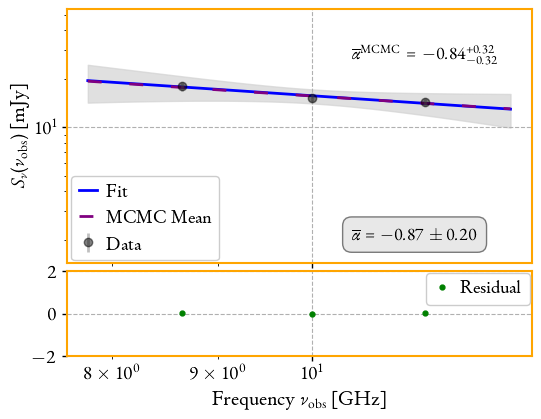

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

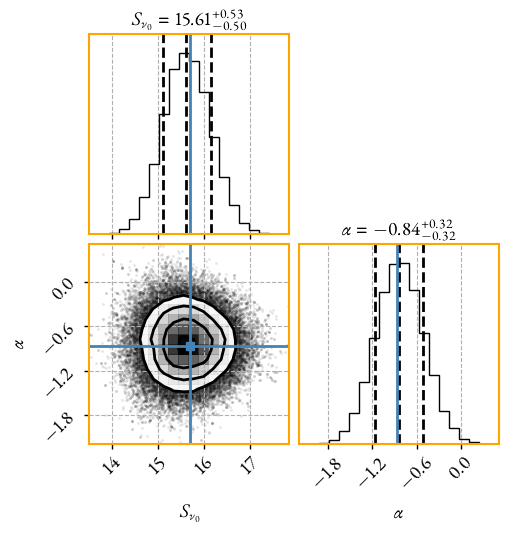

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     15.6836628 +/- 0.34891424 (2.22%) (init = 15.68366)
    alpha: -0.86520609 +/- 0.19593437 (22.65%) (init = -0.8652061)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.174
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.800 arcec            
---------------------------------------------
Imaging instrument/band VLA_C_Ka
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/Mrk331_C_Ka_2x_sf_ps_lowres.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  1.0
Using mtmfs method.
im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r1.0
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_d

/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


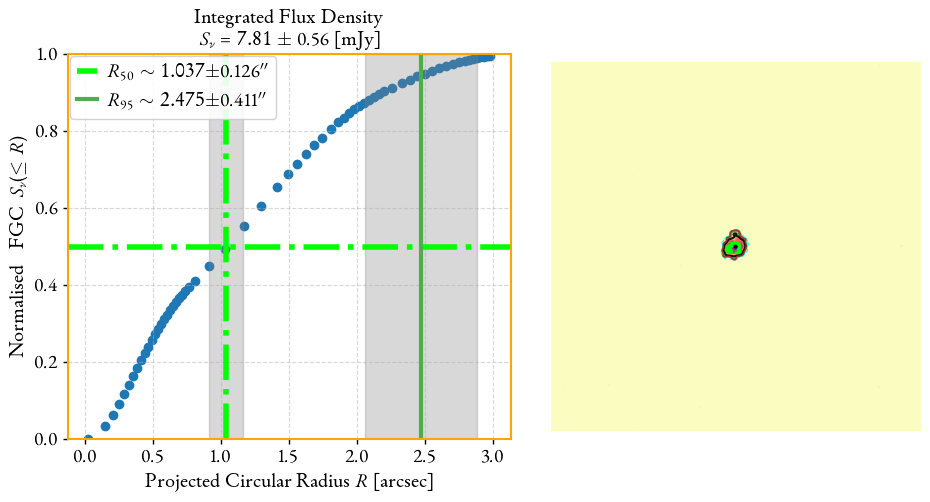

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r1.0-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r1.0-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r1.0-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 7.30 +/- 0.93 mJy
Fractional error = 0.13
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 7.30 +/- 0.59 mJy


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 2.69 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask) = 7.30 +/- 0.93 [mJy]
 ==>  Snu (image)       = 7.19 +/- 0.93 [mJy]
 ==>  R50               = 1.0650 +/- 0.1275 [arcsec]
 ==>  R95               = 2.5019 +/- 0.3567 [arcsec]


<Figure size 500x500 with 0 Axes>

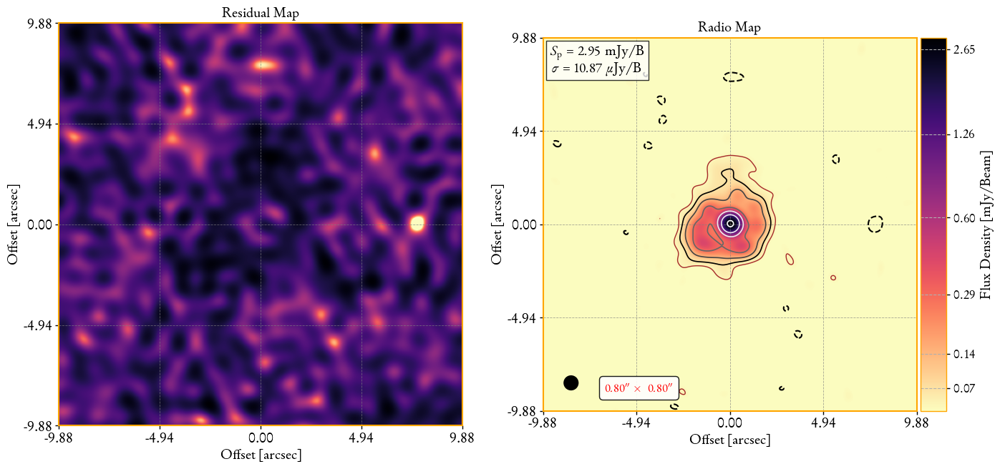

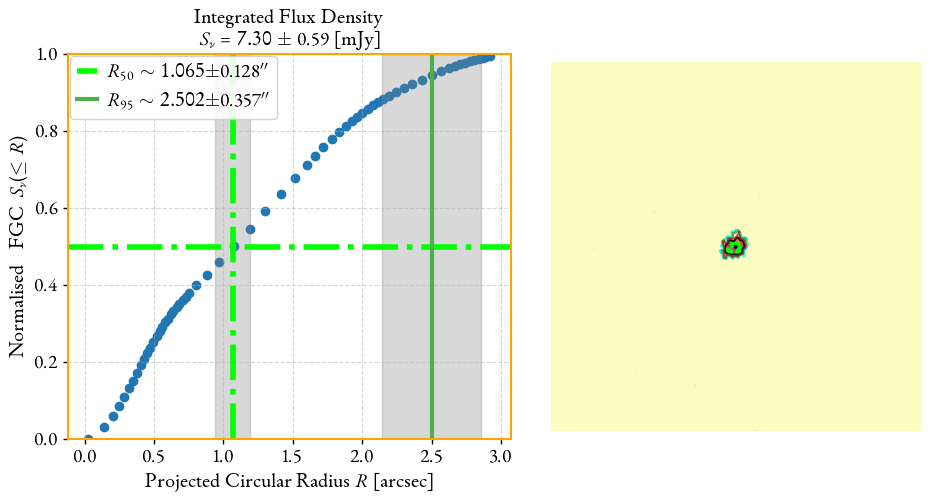

Flux density =  0.007295934614985066
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r1.0-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r1.0-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 8.24 +/- 0.76 mJy
Fractional error = 0.09
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 8.24 +/- 0.57 mJy
Fractional error = 0.07
Flux Density = 8.24 +/- 0.91 mJy
Fractional error 4 = 0.11
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 3.14 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask) = 8.24 +/- 0.76 [mJy]
 ==>  Snu (image)       = 8.49 +/- 0.76 [mJy]
 ==>  R50               = 1.0163 +/- 0.1235 [arcsec]
 ==>  R95               = 2.4211 +/- 0.3999 [arcsec]


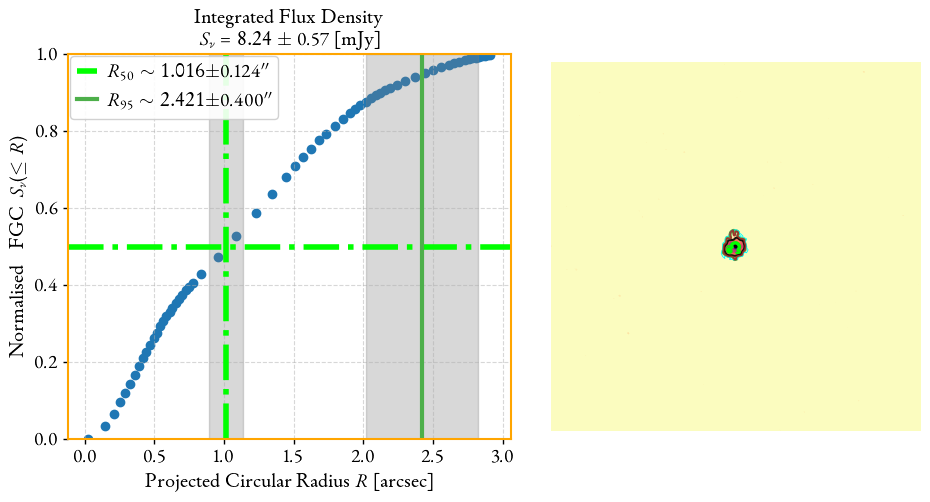

Flux density =  0.008239891679585014
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r1.0-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r1.0-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 7.75 +/- 0.80 mJy
Fractional error = 0.10
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 7.75 +/- 0.54 mJy
Fractional error = 0.07
Flux Density = 7.75 +/- 0.96 mJy
Fractional error 4 = 0.12
-----------------------------------------------------------------
 ==>  Peak of Flux      = 2.93 +/- 0.02 [mJy/bea

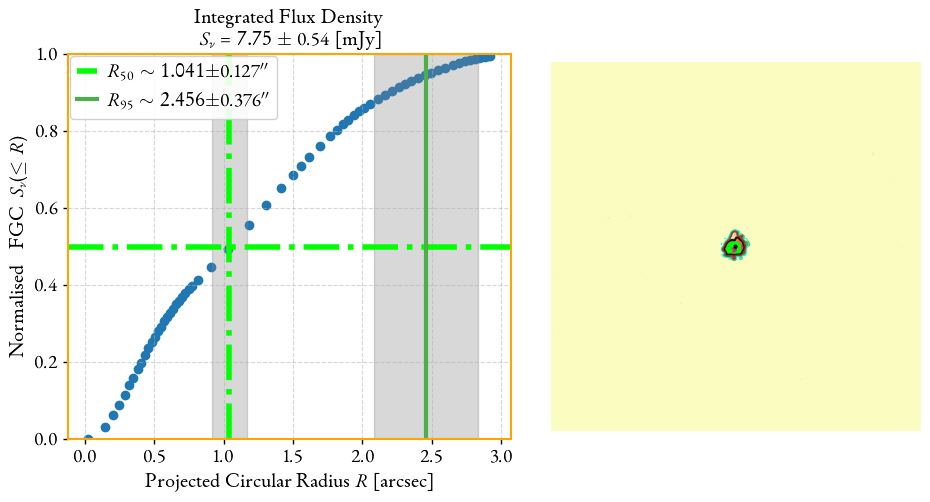

Flux density =  0.007747542591229452
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         1.5443e+00                                    8.59e+00    
       1              3         3.4504e-02      1.51e+00       2.52e+00       2.65e+03    
       2              4         1.3336e-04      3.44e-02       2.69e-01       1.07e-01    
       3              5         3.9471e-05      9.39e-05       1.43e-02       1.63e-04    
       4              6         3.9471e-05      2.24e-10       2.25e-05       8.24e-09    
       5              7         3.9471e-05      1.76e-17       9.67e-09       1.20e-09    
       6             10         3.9471e-05      5.29e-19       8.78e-11       7.55e-10    
       7             18         3.9471e-05      3.04e-18       1.11e-14       4.36e-10    
       8             20         3.9471e-05      0.00e+00       0.00e+00       4.36e-10    
`xtol` termination condition is satisfied.
Function e

100%|██████████| 5000/5000 [00:05<00:00, 992.47it/s] 


{'A1': {'best': 7.740749727350836, 'lower_bound': 7.652041922817514, 'upper_bound': 7.827267954775661, 'lower': 0.08870780453332205, 'upper': 0.08651822742482551}, 'alpha': {'best': -0.7676278772656532, 'lower_bound': -0.938877401275281, 'upper_bound': -0.5897825129169627, 'lower': 0.17124952400962778, 'upper': 0.17784536434869047}}


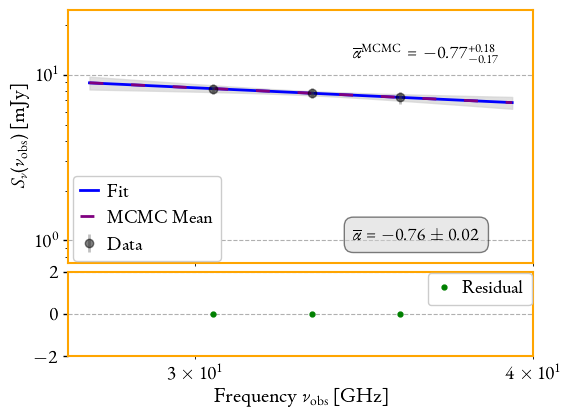

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

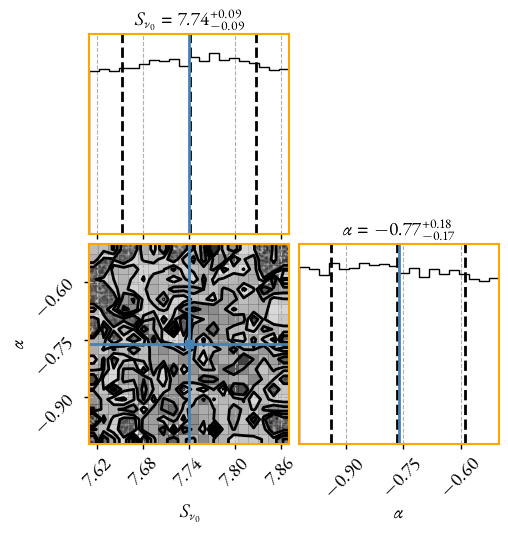

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     7.73930170 +/- 0.00871943 (0.11%) (init = 7.739302)
    alpha: -0.76218143 +/- 0.01728877 (2.27%) (init = -0.7621814)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.138
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.800 arcec            
---------------------------------------------
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  2.0
Using mtmfs method.
im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r2.0
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/:/mnt /media/sagauga/xfs_evo/wsclean3.4-idg-everybeam-eMERLIN_portable.sif wsclean -name /mnt/im_nc3_cb_bs_0.80asec_Mrk33

/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


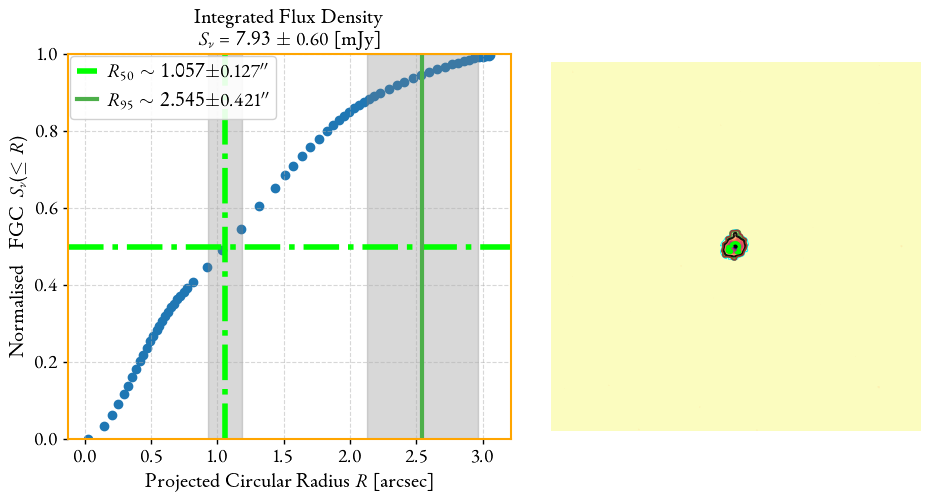

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r2.0-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r2.0-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r2.0-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 7.87 +/- 0.79 mJy
Fractional error = 0.10
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 7.87 +/- 0.57 mJy


<Figure size 500x500 with 0 Axes>

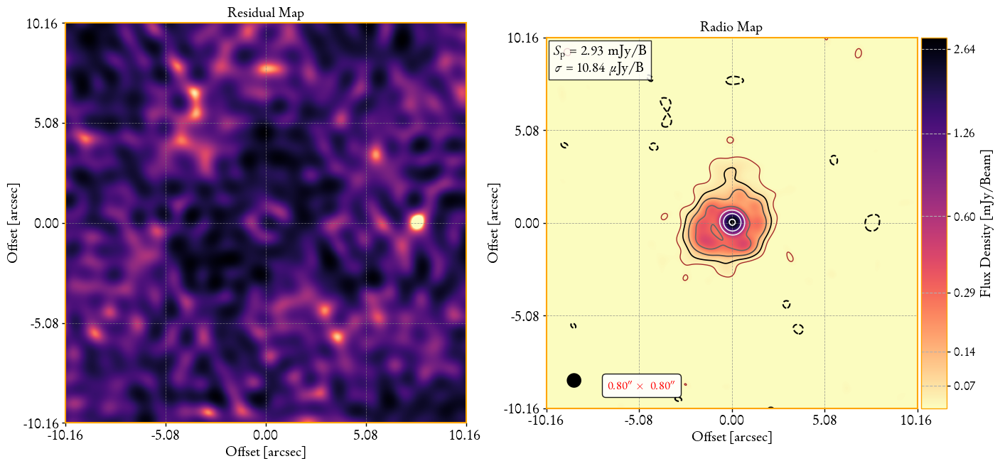

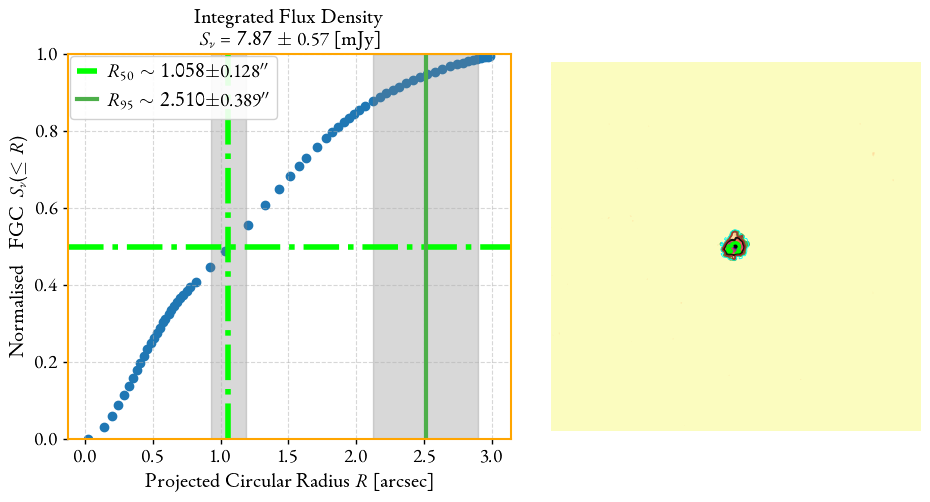

Flux density =  0.007868294438851398
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r2.0-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r2.0-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 8.33 +/- 0.76 mJy
Fractional error = 0.09
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 8.33 +/- 0.60 mJy
Fractional error = 0.07
Flux Density = 8.33 +/- 0.93 mJy
Fractional error 4 = 0.11
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 3.12 +/- 0.02 [mJy/beam]
 ==>  Snu (within mask) = 8.33 +/- 0.76 [mJy]
 ==>  Snu (image)       = 8.45 +/- 0.76 [mJy]
 ==>  R50               = 1.0300 +/- 0.1246 [arcsec]
 ==>  R95               = 2.4709 +/- 0.4095 [arcsec]


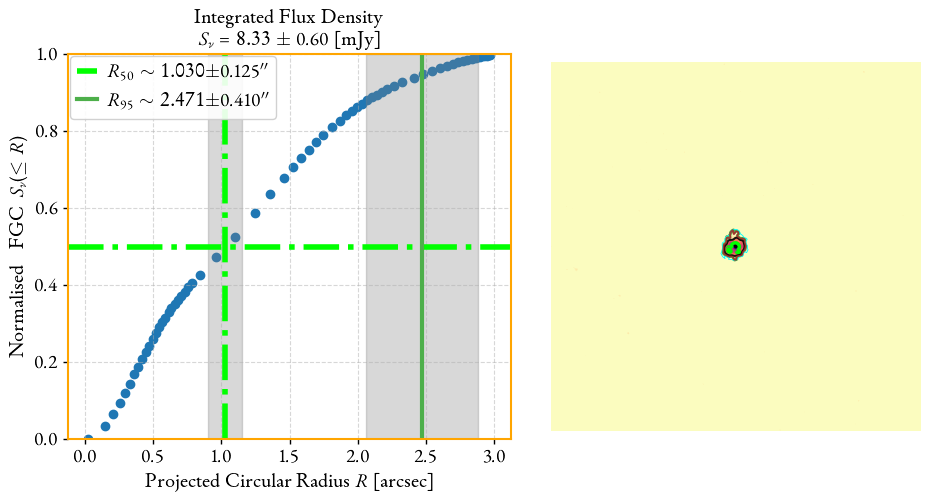

Flux density =  0.00833471692922996
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r2.0-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/Ka/im_nc3_cb_bs_0.80asec_Mrk331_C_Ka_2x_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r2.0-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 7.46 +/- 0.98 mJy
Fractional error = 0.13
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 7.46 +/- 0.64 mJy
Fractional error = 0.09
Flux Density = 7.46 +/- 1.07 mJy
Fractional error 4 = 0.14
-----------------------------------------------------------------
 ==>  Peak of Flux      = 2.68 +/- 0.02 [mJy/beam

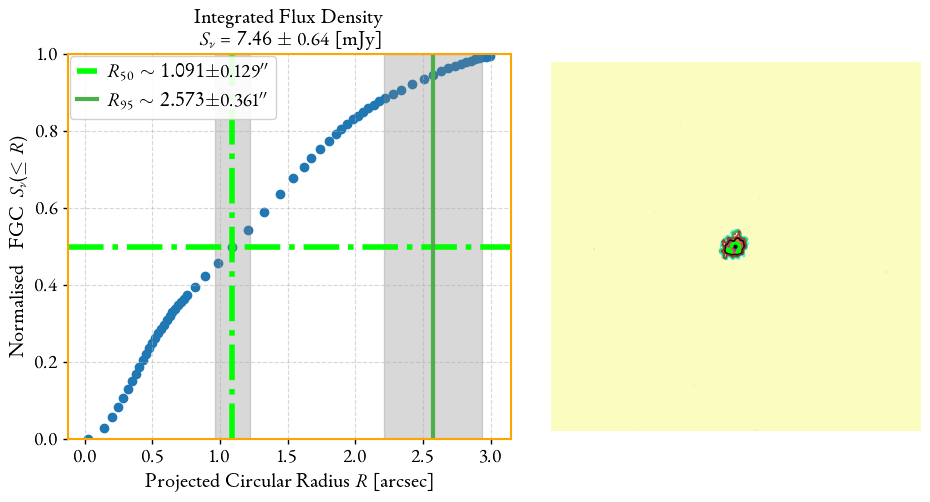

Flux density =  0.00745798662064752
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         1.4301e+00                                    8.69e+00    
       1              3         7.4067e-02      1.36e+00       2.52e+00       3.80e+03    
       2              4         8.6786e-04      7.32e-02       4.23e-01       3.41e-01    
       3              5         5.3241e-06      8.63e-04       4.04e-02       1.32e-03    
       4              6         5.3104e-06      1.37e-08       1.76e-04       2.67e-08    
       5              7         5.3104e-06      4.31e-17       1.78e-08       1.07e-07    
       6             11         5.3104e-06      1.97e-18       1.61e-11       1.57e-10    
       7             18         5.3104e-06      0.00e+00       0.00e+00       1.57e-10    
`xtol` termination condition is satisfied.
Function evaluations 18, initial cost 1.4301e+00, final cost 5.3104e-06, first-order optimality 1.57e-

100%|██████████| 5000/5000 [00:05<00:00, 991.67it/s] 


{'A1': {'best': 7.866825962782626, 'lower_bound': 7.834338858745245, 'upper_bound': 7.900224217793509, 'lower': 0.0324871040373802, 'upper': 0.03339825501088356}, 'alpha': {'best': -0.6966294015656808, 'lower_bound': -0.760836709146467, 'upper_bound': -0.6339182650918672, 'lower': 0.06420730758078619, 'upper': 0.06271113647381354}}


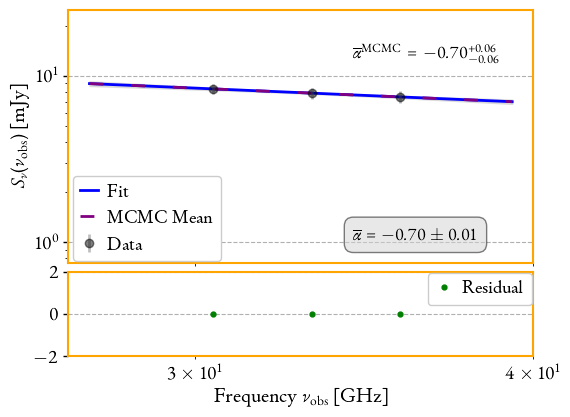

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

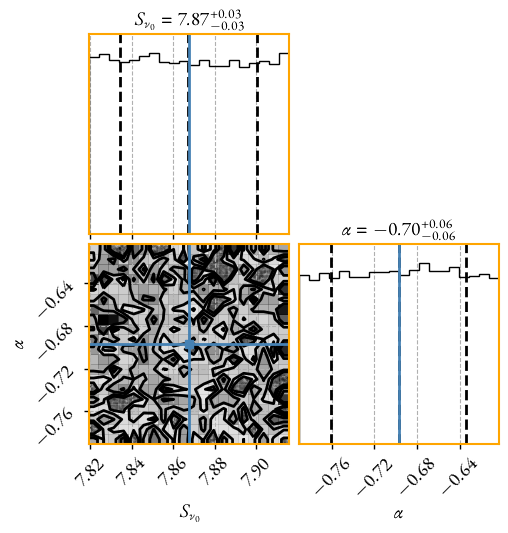

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     7.86736960 +/- 0.00320961 (0.04%) (init = 7.86737)
    alpha: -0.69727833 +/- 0.00626538 (0.90%) (init = -0.6972783)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.137
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.800 arcec            
---------------------------------------------


In [13]:
robust_plus = [1.0,2.0]
for vis_name in list(vis_list_uv_match_wt_plus.keys()):
    print(f"Imaging instrument/band {vis_name}")
    print(f"    > Visibility: {vis_list_uv_match_wt_plus[vis_name]}")
    for ROBUST in robust_plus:
        image_list,image_statistics,Omaj = \
            mlibs.run_wsclean(vis_list_uv_match_wt_plus[vis_name], robust=ROBUST,
                        imsize=imsizex, 
                        imsizey=imsizey, 
                        opt_args= opt_args,
                        cell=cell,
                        base_name=prefix,
                        nsigma_automask=nsigma_automask,
                        nsigma_autothreshold=nsigma_autothreshold,
                        quiet=True,
                        nc=n_subimages,
                        with_multiscale=True,
                        # scales='0,40,120,240',
                        scales='None',
                        datacolumn='DATA',
                        uvtaper=uvtaper,
                        niter=100000)


## $\text{More weight for longer baselines for L and S band data.}$

Imaging instrument/band VLA_A_L
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/Mrk331_A_L_sfc_uvsub_ps_lowres.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  -0.5
Using mtmfs method.
im_nc3_cb_bs_0.80asec_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r-0.5
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/:/mnt /media/sagauga/xfs_evo/wsclean3.4-idg-everybeam-eMERLIN_portable.sif wsclean -name /mnt/im_nc3_cb_bs_0.80asec_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r-0.5 -size 2048 2048 -scale 0.04asec  -mgain 0.5 -gain 0.1 -nmiter 500  -niter 100000 -weight briggs -0.5  -auto-mask 4.0  -auto-threshold 1.5  -multiscale  -multiscale-scale-bias 0.7 -multiscale-gain 0.1  -multiscale-max-scales 6   -deconvolution-thr

/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


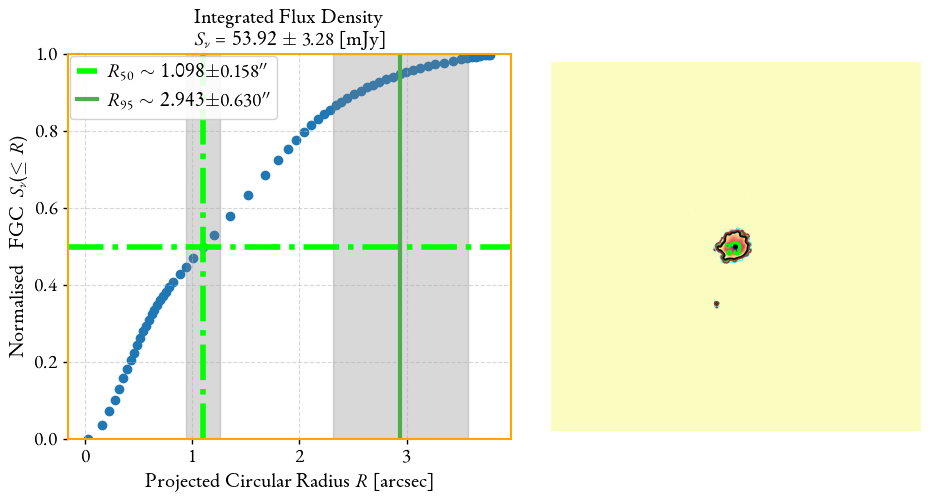

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_bs_0.80asec_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r-0.5-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_bs_0.80asec_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r-0.5-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_bs_0.80asec_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r-0.5-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 54.56 +/- 4.57 mJy
Fractional error = 0.08
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density =

/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 19.93 +/- 0.05 [mJy/beam]
 ==>  Snu (within mask) = 54.56 +/- 4.57 [mJy]
 ==>  Snu (image)       = 53.44 +/- 4.57 [mJy]
 ==>  R50               = 1.0990 +/- 0.1581 [arcsec]
 ==>  R95               = 2.9669 +/- 0.6065 [arcsec]


<Figure size 500x500 with 0 Axes>

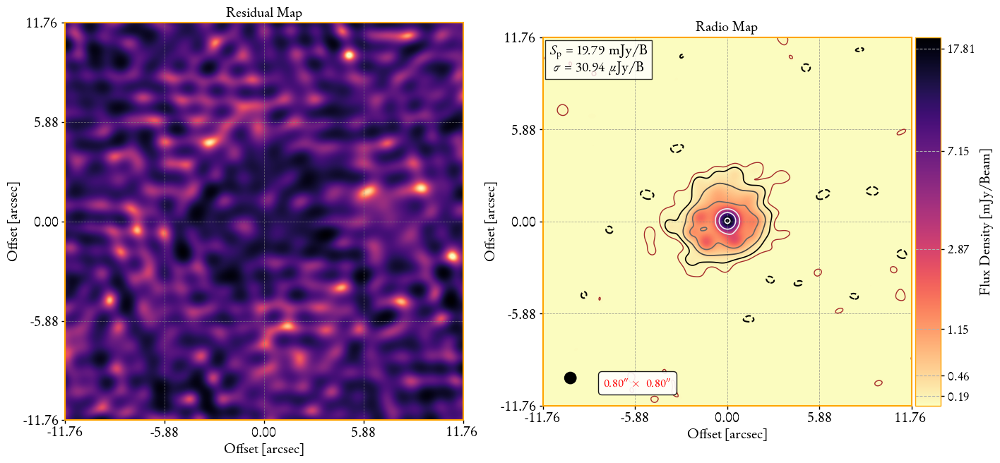

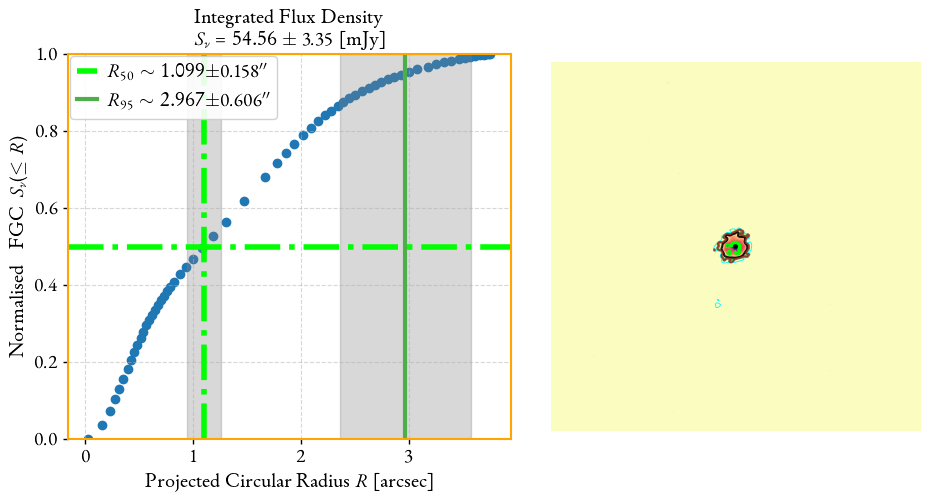

Flux density =  0.054557990105105786
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_bs_0.80asec_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r-0.5-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_bs_0.80asec_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r-0.5-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 65.24 +/- 7.34 mJy
Fractional error = 0.11
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 65.24 +/- 4.12 mJy
Fractional error = 0.06
Flux Density = 65.24 +/- 5.91 mJy
Fractional error 4 = 0.09
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 21.39 +/- 0.06 [mJy/beam]
 ==>  Snu (within mask) = 65.24 +/- 7.34 [mJy]
 ==>  Snu (image)       = 64.91 +/- 7.34 [mJy]
 ==>  R50               = 1.2180 +/- 0.1541 [arcsec]
 ==>  R95               = 3.1148 +/- 0.5333 [arcsec]


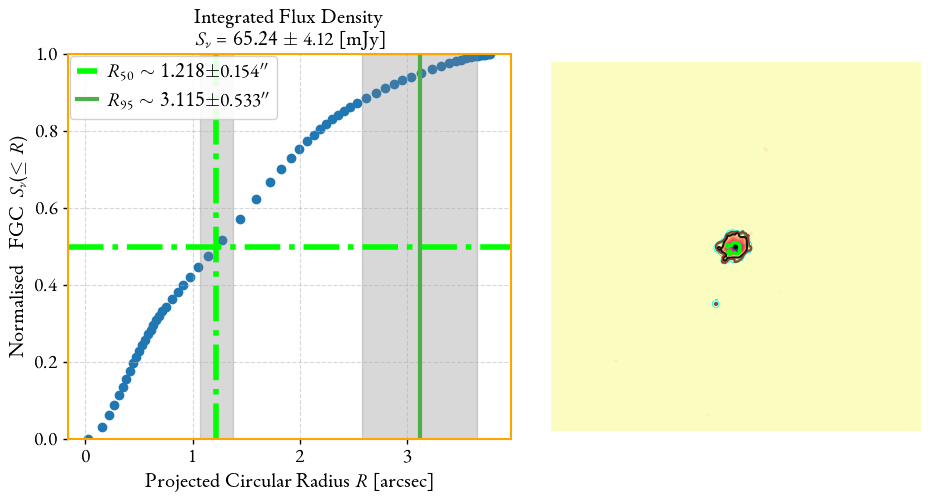

Flux density =  0.06524028221627008
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_bs_0.80asec_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r-0.5-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/L/v3/im_nc3_cb_bs_0.80asec_Mrk331_A_L_sfc_uvsub_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r-0.5-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 48.08 +/- 4.42 mJy
Fractional error = 0.09
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 48.08 +/- 2.83 mJy
Fractional error = 0.06
Flux Density = 48.08 +/- 4.43 mJy
Fractional error 4 = 0.09
-----------------------------------------------------------------


/media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/reproducibility/LIRGI/imaging/example/../../../../morphen/morphen/fit_ellipse.py:68: RuntimeWarning: divide by zero encountered in divide
  return np.abs(xr**2/a**2 + yr**2/b**2 - 1.0)
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


 ==>  Peak of Flux      = 18.94 +/- 0.05 [mJy/beam]
 ==>  Snu (within mask) = 48.08 +/- 4.42 [mJy]
 ==>  Snu (image)       = 47.34 +/- 4.42 [mJy]
 ==>  R50               = 1.0281 +/- 0.1571 [arcsec]
 ==>  R95               = 2.7857 +/- 0.5595 [arcsec]


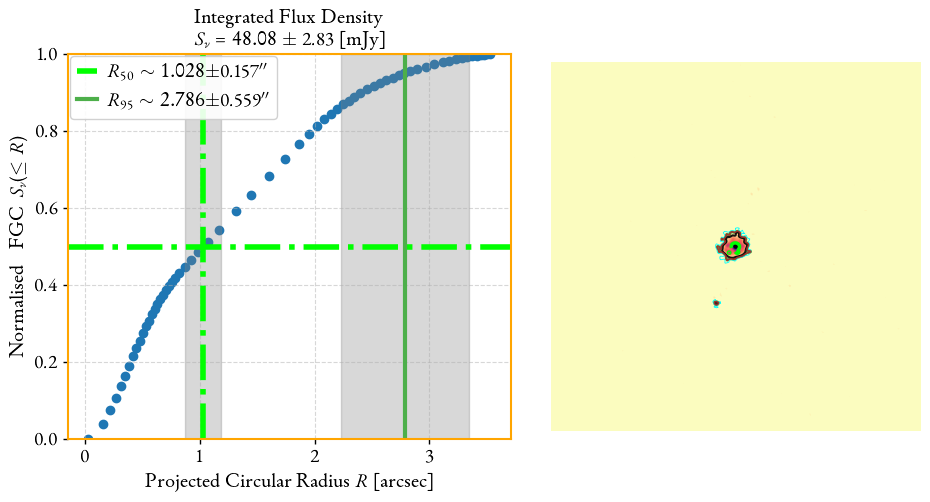

Flux density =  0.04808170630646444
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         9.8542e+00                                    6.70e+02    
       1              2         1.1796e+00      8.67e+00       4.58e+01       3.13e+01    
       2              5         4.3065e-01      7.49e-01       1.81e-01       3.66e+01    
       3              6         2.4607e-01      1.85e-01       7.91e-01       3.49e+02    
       4              7         2.2926e-01      1.68e-02       2.52e-01       2.72e+01    
       5              8         7.7396e-02      1.52e-01       4.53e-02       1.45e+01    
       6              9         2.4265e-02      5.31e-02       2.20e-01       1.22e+02    
       7             10         2.3842e-02      4.22e-04       5.83e-03       8.05e-03    
       8             11         2.3842e-02      1.05e-08       1.39e-04       1.22e-06    
       9             12         2.3842e-02      1.06e-

100%|██████████| 5000/5000 [00:05<00:00, 916.40it/s]


{'A1': {'best': 54.852156242934775, 'lower_bound': 53.12555223620234, 'upper_bound': 56.57071839048127, 'lower': 1.7266040067324369, 'upper': 1.7185621475464927}, 'alpha': {'best': -0.644917261377489, 'lower_bound': -0.804571985769098, 'upper_bound': -0.48782894517312614, 'lower': 0.1596547243916091, 'upper': 0.1570883162043628}}


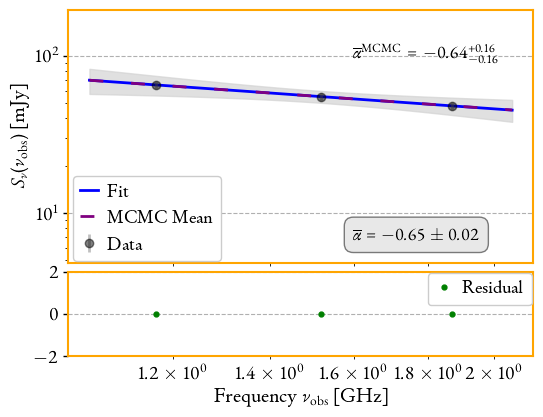

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

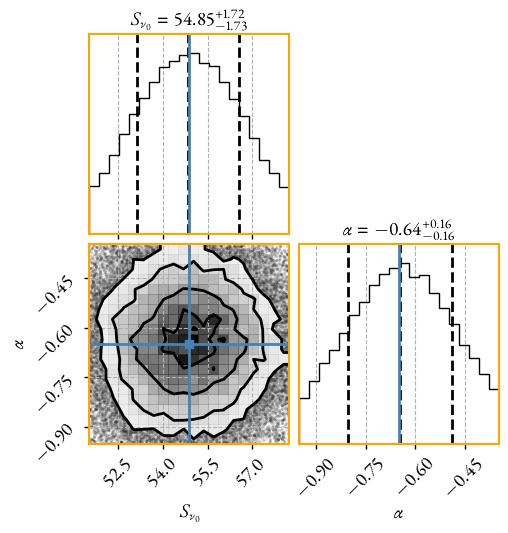

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     54.8612753 +/- 0.22419274 (0.41%) (init = 54.86128)
    alpha: -0.65029092 +/- 0.02021416 (3.11%) (init = -0.6502909)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.258
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.800 arcec            
---------------------------------------------
Imaging instrument/band VLA_A_S
    > Visibility: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/MRK0331_A_S_sf_ps_lowres.ms
 >> Imaging script path: /media/sagauga/xfs_evo/cloud/GoogleDrive/GitHubUoM/morphen/morphen
  -0.5
Using mtmfs method.
im_nc3_cb_bs_0.80asec_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r-0.5
 ++==>> Command to be executed by Singularity > WSClean: 
singularity exec --nv --bind /media/sagauga/stardust/LIRGI_Sample_done/for

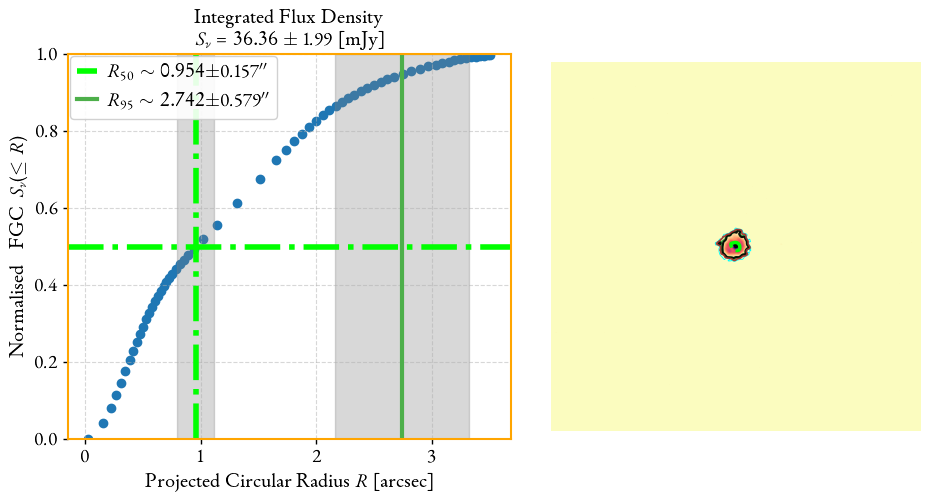

Using residual map as RMS estimator: /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_bs_0.80asec_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r-0.5-MFS-residual.fits
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_bs_0.80asec_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r-0.5-0001-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_bs_0.80asec_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r-0.5-0001-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 37.15 +/- 2.48 mJy
Fractional error = 0.07
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 37.15 +/- 2.04 mJy
Fractio

<Figure size 500x500 with 0 Axes>

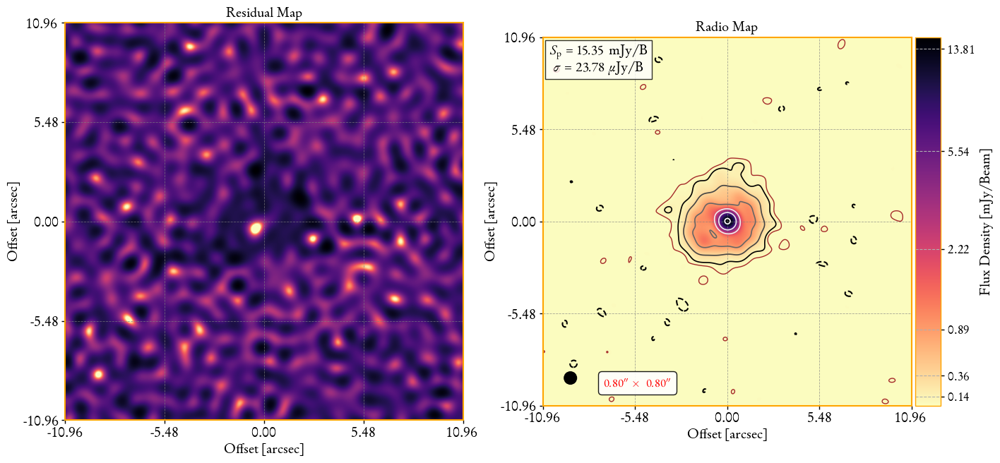

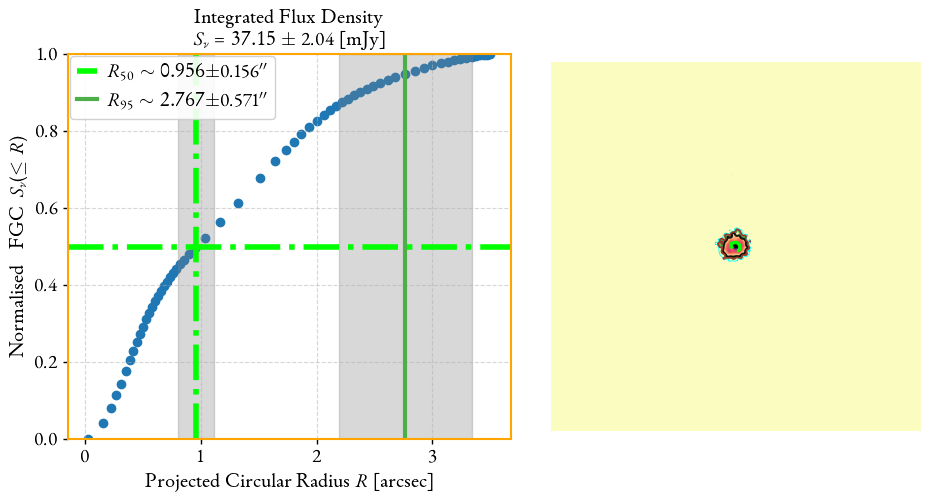

Flux density =  0.037145555599289184
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_bs_0.80asec_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r-0.5-0000-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_bs_0.80asec_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r-0.5-0000-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 42.51 +/- 3.94 mJy
Fractional error = 0.09
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 42.51 +/- 2.33 mJy
Fractional error = 0.05
Flux Density = 42.51 +/- 4.30 mJy
Fractional error 4 = 0.10
-----------------------------------------------------------------
 ==>  Peak of Flux      = 17.31 +/- 0.06 [mJy/beam]

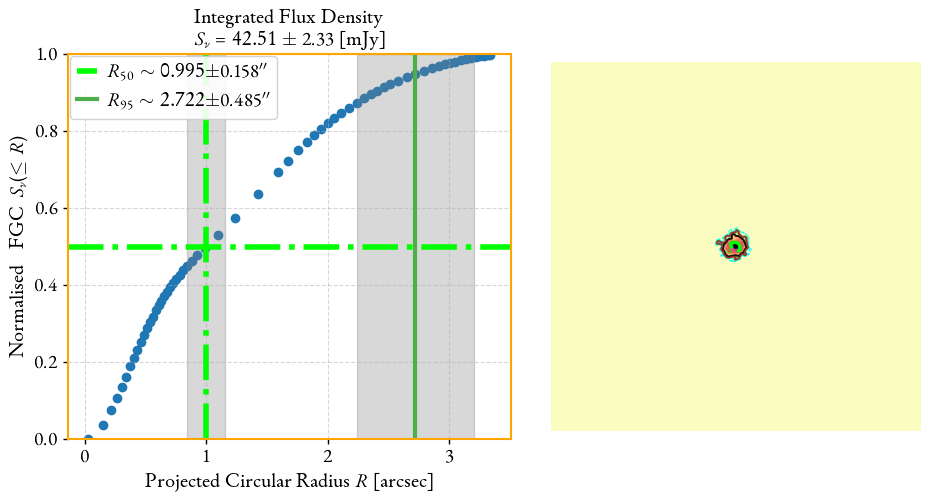

Flux density =  0.04251250481429154
++>> Computing flux density on sub-band image  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_bs_0.80asec_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r-0.5-0002-image.fits
++>> Associated sub-band  residual image is  /media/sagauga/stardust/LIRGI_Sample_done/for_spix/Mrk331/VLA_L_S_C_X_Ku_Ka/S/im_nc3_cb_bs_0.80asec_MRK0331_A_S_sf_ps_lowres_2048x2048_am_4.0_at_1.5_0.04asec_multiscale__r-0.5-0002-residual.fits
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 32.26 +/- 2.32 mJy
Fractional error = 0.07
Flux Density and error (quadrature |fract_err + res_err + rms|): 
Flux Density = 32.26 +/- 1.76 mJy
Fractional error = 0.05
Flux Density = 32.26 +/- 2.76 mJy
Fractional error 4 = 0.09
-----------------------------------------------------------------
 ==>  Peak of Flux      = 13.98 +/- 0.04 [mJy/beam]


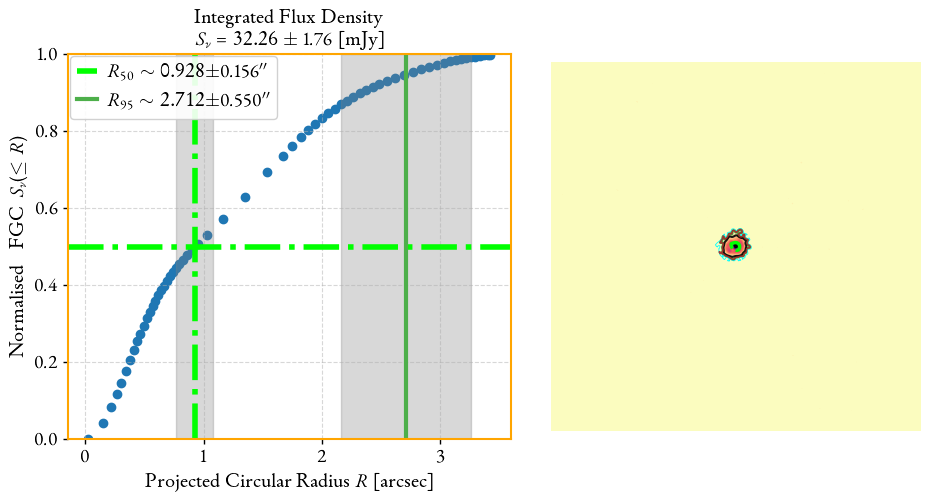

Flux density =  0.03225743485031227
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         8.3059e+00                                    1.13e+03    
       1              2         7.3349e+00      9.71e-01       4.58e+01       8.70e+00    
       2              3         7.1981e+00      1.37e-01       8.54e-01       8.96e+00    
       3              4         6.9066e+00      2.92e-01       1.69e+00       9.55e+00    
       4              5         6.2300e+00      6.77e-01       3.32e+00       1.11e+01    
       5              6         3.8212e+00      2.41e+00       6.30e+00       2.22e+01    
       6              9         3.2676e+00      5.54e-01       5.01e-01       1.21e+01    
       7             10         2.7693e+00      4.98e-01       1.45e+00       1.41e+01    
       8             11         1.3383e+00      1.43e+00       2.84e+00       2.01e+01    
       9             13         3.9213e-01      9.46e-

100%|██████████| 5000/5000 [00:06<00:00, 799.14it/s]


{'A1': {'best': 36.62463518019263, 'lower_bound': 35.45584349803929, 'upper_bound': 37.784771882968464, 'lower': 1.1687916821533335, 'upper': 1.1601367027758371}, 'alpha': {'best': -0.5980525894486486, 'lower_bound': -0.76410318840008, 'upper_bound': -0.4304821356530327, 'lower': 0.16605059895143137, 'upper': 0.16757045379561586}}


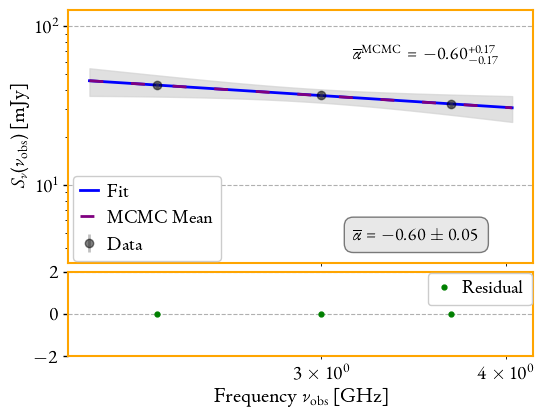

(100000, 2)


<Figure size 600x400 with 0 Axes>

<Figure size 600x400 with 0 Axes>

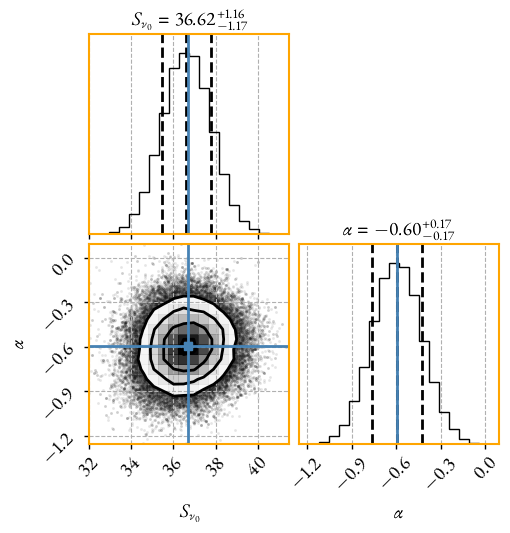

++==>> Parameter Results (MCMC sampling).
++==>> Parameter Results (from least-squares fit).
[[Variables]]
    A1:     36.6843735 +/- 0.34395316 (0.94%) (init = 36.68437)
    alpha: -0.59521054 +/- 0.04710701 (7.91%) (init = -0.5952105)
[[Correlations]] (unreported correlations are < 0.100)
    C(A1, alpha) = 0.263
---------------------------------------------
------------ RESTORING BEAM SIZE ------------
                0.800 arcec            
---------------------------------------------


In [14]:
robust_minus = [-0.5]
for vis_name in list(vis_list_uv_match_wt_minus.keys()):
    print(f"Imaging instrument/band {vis_name}")
    print(f"    > Visibility: {vis_list_uv_match_wt_minus[vis_name]}")
    for ROBUST in robust_minus:
        image_list,image_statistics,Omaj = \
            mlibs.run_wsclean(vis_list_uv_match_wt_minus[vis_name], robust=ROBUST,
                        imsize=imsizex, 
                        imsizey=imsizey, 
                        opt_args= opt_args,
                        cell=cell,
                        base_name=prefix,
                        nsigma_automask=nsigma_automask,
                        nsigma_autothreshold=nsigma_autothreshold,
                        quiet=True,
                        nc=n_subimages,
                        with_multiscale=True,
                        # scales='0,40,120,240',
                        scales='None',
                        datacolumn='DATA',
                        uvtaper=uvtaper,
                        niter=100000)
